In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import skew, kurtosis
from sklearn.preprocessing import LabelEncoder
import warnings
warnings.filterwarnings('ignore')
plt.style.use('dark_background')

# **_Reading the Dataset_**

In [2]:
data=pd.read_csv('final_internship_data.csv')
data.head()

,User ID,User Name,Driver Name,Car Condition,Weather,Traffic Condition,key,fare_amount,pickup_datetime,pickup_longitude,...,month,weekday,year,jfk_dist,ewr_dist,lga_dist,sol_dist,nyc_dist,distance,bearing
0,KHVrEVlD,Kimberly Adams,Amy Butler,Very Good,windy,Congested Traffic,2009-06-15 17:26:21.0000001,4.5,2009-06-15 17:26:21,-1.288826,...,6,0,2009,20.265840,55.176046,14.342611,34.543548,27.572573,1.030764,-2.918897
1,lPxIuEri,Justin Tapia,Hannah Zimmerman,Excellent,cloudy,Flow Traffic,2010-01-05 16:52:16.0000002,16.9,2010-01-05 16:52:16,-1.291824,...,1,1,2010,44.667679,31.832358,23.130775,15.125872,8.755732,8.450134,-0.375217
2,gsVN8JLS,Elizabeth Lopez,Amanda Jackson,Bad,stormy,Congested Traffic,2011-08-18 00:35:00.00000049,5.7,2011-08-18 00:35:00,-1.291242,...,8,3,2011,43.597686,33.712082,19.865289,17.722624,9.847344,1.389525,2.599961
3,9I7kWFgd,Steven Wilson,Amy Horn,Very Good,stormy,Flow Traffic,2012-04-21 04:30:42.0000001,7.7,2012-04-21 04:30:42,-1.291319,...,4,5,2012,42.642965,32.556289,21.063132,15.738963,7.703421,2.799270,0.133905
4,8QN5ZaGN,Alexander Andrews,Cassandra Larson,Bad,stormy,Congested Traffic,2010-03-09 07:51:00.000000135,5.3,2010-03-09 07:51:00,-1.290987,...,3,1,2010,43.329953,39.406828,15.219339,23.732406,15.600745,1.999157,-0.502703


In [3]:
#extract this column and print 10 row Index(['passenger_count', 'weekday', 'pickup_longitude', 'lga_dist',
      #  'dropoff_longitude', 'nyc_dist', 'month', 'dropoff_latitude', 'year',
      #  'ewr_dist', 'pickup_latitude', 'sol_dist', 'distance', 'jfk_dist',
      #  'bearing', 'hour'],
      # dtype='object')
data=data[['passenger_count', 'weekday', 'pickup_longitude', 'lga_dist',
       'dropoff_longitude', 'nyc_dist', 'month', 'dropoff_latitude', 'year',
       'ewr_dist', 'pickup_latitude', 'sol_dist', 'distance', 'jfk_dist',
       'bearing', 'hour','fare_amount']]
data.head()

,passenger_count,weekday,pickup_longitude,lga_dist,dropoff_longitude,nyc_dist,month,dropoff_latitude,year,ewr_dist,pickup_latitude,sol_dist,distance,jfk_dist,bearing,hour,fare_amount
0,1,0,-1.288826,14.342611,-1.288779,27.572573,6,0.710563,2009,55.176046,0.710721,34.543548,1.030764,20.265840,-2.918897,17,4.5
1,1,1,-1.291824,23.130775,-1.291182,8.755732,1,0.711780,2010,31.832358,0.710546,15.125872,8.450134,44.667679,-0.375217,16,16.9
2,2,3,-1.291242,19.865289,-1.291391,9.847344,8,0.711231,2011,33.712082,0.711418,17.722624,1.389525,43.597686,2.599961,0,5.7
3,1,5,-1.291319,21.063132,-1.291396,7.703421,4,0.711363,2012,32.556289,0.710927,15.738963,2.799270,42.642965,0.133905,4,7.7
4,1,1,-1.290987,15.219339,-1.290787,15.600745,3,0.711811,2010,39.406828,0.711536,23.732406,1.999157,43.329953,-0.502703,7,5.3


In [3]:
data.tail()

,User ID,User Name,Driver Name,Car Condition,Weather,Traffic Condition,key,fare_amount,pickup_datetime,pickup_longitude,...,month,weekday,year,jfk_dist,ewr_dist,lga_dist,sol_dist,nyc_dist,distance,bearing
499995,er7Luy6J,Morgan Smith,Gabriel Coleman,Bad,rainy,Dense Traffic,2015-05-07 18:45:12.0000004,7.0,2015-05-07 18:45:12,-1.291173,...,5,3,2015,42.565403,36.580043,17.157511,20.401068,12.280187,1.404709,-2.275706
499996,FWDZu9NA,Dillon Jackson,Larry Richards,Very Good,rainy,Flow Traffic,2010-09-13 12:11:34.0000004,13.7,2010-09-13 12:11:34,-1.291595,...,9,0,2010,41.814877,27.833416,26.463167,8.596656,0.994796,0.994184,2.556931
499997,QZIMcpLZ,Michael Rodriguez,Lonnie Santana,Bad,rainy,Flow Traffic,2014-08-25 00:22:20.0000001,25.0,2014-08-25 00:22:20,-1.291262,...,8,0,2014,31.780108,38.960930,19.708214,19.066488,11.663395,7.859324,-1.926251
499998,AD72Uwmn,Deborah Soto,Emily Rivera,Good,stormy,Congested Traffic,2015-01-12 12:17:32.0000001,6.5,2015-01-12 12:17:32,-1.291101,...,1,0,2015,42.292914,36.382813,17.227166,20.006433,11.819775,0.994470,-0.384817
499999,qGKn4Um5,Eric Jones,Julie King,Very Good,sunny,Flow Traffic,2010-04-12 23:46:58.0000002,4.9,2010-04-12 23:46:58,-1.291312,...,4,0,2010,38.822968,31.517592,23.087427,11.950577,3.873636,1.040272,-2.813690


In [4]:
data.shape

(500000, 26)

In [5]:
data.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,day,month,weekday,year,jfk_dist,ewr_dist,lga_dist,sol_dist,nyc_dist,distance,bearing
count,500000.000000,500000.000000,500000.000000,499995.000000,499995.000000,500000.000000,500000.000000,500000.000000,500000.000000,500000.000000,500000.000000,499995.000000,499995.000000,499995.000000,499995.000000,499995.000000,499995.000000,499995.000000
mean,11.358361,-1.265712,0.696740,-1.265755,0.696675,1.683428,13.510834,15.684206,6.268650,3.042008,2011.739132,385.279367,380.503657,363.843772,363.674038,355.991423,19.468775,0.297145
std,9.916617,0.206941,0.140909,0.205903,0.128997,1.307395,6.511571,8.681066,3.437815,1.949240,1.860889,2419.087483,2428.804740,2425.075903,2428.348683,2428.730839,367.299601,1.804548
min,-44.900000,-52.119764,-54.389440,-59.049665,-44.676047,0.000000,0.000000,1.000000,1.000000,0.000000,2009.000000,1.017646,1.460945,0.382119,0.532545,0.080500,0.000000,-3.141593
25%,6.000000,-1.291405,0.710958,-1.291393,0.710943,1.000000,9.000000,8.000000,3.000000,1.000000,2010.000000,41.341514,32.173712,17.100762,14.886989,7.147384,1.214550,-0.854721
50%,8.500000,-1.291226,0.711268,-1.291197,0.711277,1.000000,14.000000,16.000000,6.000000,3.000000,2012.000000,42.523163,34.787507,19.591554,18.347580,10.458151,2.116970,-0.050442
75%,12.500000,-1.290970,0.711520,-1.290908,0.711538,2.000000,19.000000,23.000000,9.000000,5.000000,2013.000000,43.785649,38.304502,22.214815,22.417812,14.448699,3.890070,2.206769
max,500.000000,37.360538,29.724576,0.712985,7.061893,6.000000,23.000000,31.000000,12.000000,6.000000,2015.000000,30133.067880,30167.595967,30167.285794,30159.407296,30162.285356,12399.956433,3.141593


In [6]:
col=data.columns
col

Index(['User ID', 'User Name', 'Driver Name', 'Car Condition', 'Weather',
       'Traffic Condition', 'key', 'fare_amount', 'pickup_datetime',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'passenger_count', 'hour', 'day', 'month',
       'weekday', 'year', 'jfk_dist', 'ewr_dist', 'lga_dist', 'sol_dist',
       'nyc_dist', 'distance', 'bearing'],
      dtype='object')

In [7]:
data.nunique()

User ID              500000
User Name            221675
Driver Name          221700
Car Condition             4
Weather                   5
Traffic Condition         3
key                  500000
fare_amount            1688
pickup_datetime      461206
pickup_longitude      95037
pickup_latitude      119115
dropoff_longitude    108283
dropoff_latitude     135053
passenger_count           7
hour                     24
day                      31
month                    12
weekday                   7
year                      7
jfk_dist             490613
ewr_dist             490613
lga_dist             490613
sol_dist             490613
nyc_dist             490613
distance             485705
bearing              485636
dtype: int64

In [8]:
data.duplicated().sum()

0

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500000 entries, 0 to 499999
Data columns (total 26 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   User ID            500000 non-null  object 
 1   User Name          500000 non-null  object 
 2   Driver Name        500000 non-null  object 
 3   Car Condition      500000 non-null  object 
 4   Weather            500000 non-null  object 
 5   Traffic Condition  500000 non-null  object 
 6   key                500000 non-null  object 
 7   fare_amount        500000 non-null  float64
 8   pickup_datetime    500000 non-null  object 
 9   pickup_longitude   500000 non-null  float64
 10  pickup_latitude    500000 non-null  float64
 11  dropoff_longitude  499995 non-null  float64
 12  dropoff_latitude   499995 non-null  float64
 13  passenger_count    500000 non-null  int64  
 14  hour               500000 non-null  int64  
 15  day                500000 non-null  int64  
 16  mo

In [10]:
data.isnull().sum()

User ID              0
User Name            0
Driver Name          0
Car Condition        0
Weather              0
Traffic Condition    0
key                  0
fare_amount          0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    5
dropoff_latitude     5
passenger_count      0
hour                 0
day                  0
month                0
weekday              0
year                 0
jfk_dist             5
ewr_dist             5
lga_dist             5
sol_dist             5
nyc_dist             5
distance             5
bearing              5
dtype: int64

In [3]:
df_cleaned = data.dropna()

In [12]:
df_cleaned.shape

(499995, 26)

In [13]:
df_cleaned.isnull().sum()

User ID              0
User Name            0
Driver Name          0
Car Condition        0
Weather              0
Traffic Condition    0
key                  0
fare_amount          0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
passenger_count      0
hour                 0
day                  0
month                0
weekday              0
year                 0
jfk_dist             0
ewr_dist             0
lga_dist             0
sol_dist             0
nyc_dist             0
distance             0
bearing              0
dtype: int64

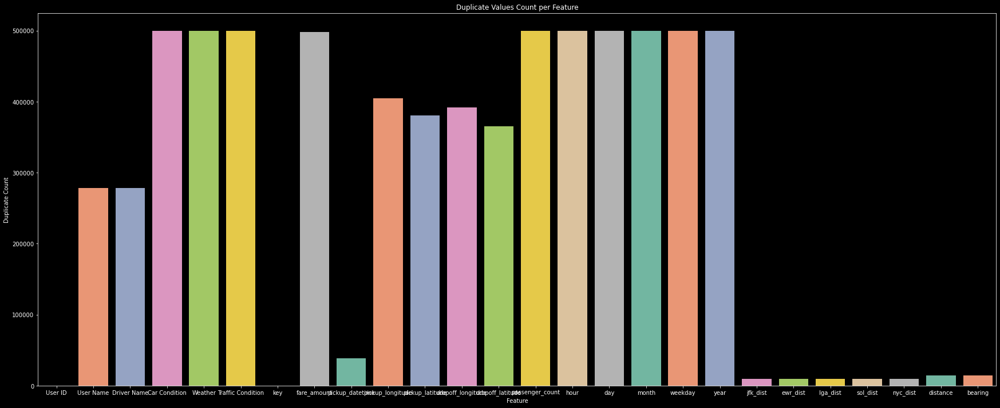

In [14]:
def count_duplicates(df):
    duplicate_counts = {}
    for column in df.columns:
        # Count duplicates in the column
        count = df[column].duplicated().sum()
        duplicate_counts[column] = count
    return duplicate_counts

# Calculate duplicates
duplicates = count_duplicates(df_cleaned)

# Convert the duplicates dictionary into a DataFrame for easier plotting
duplicates_df = pd.DataFrame(list(duplicates.items()), columns=['Feature', 'Duplicate Count'])

# Plot using Seaborn
plt.figure(figsize=(30, 12))
sns.barplot(x='Feature', y='Duplicate Count', data=duplicates_df, palette='Set2')

# Add titles and labels
plt.title('Duplicate Values Count per Feature')
plt.xlabel('Feature')
plt.ylabel('Duplicate Count')

# Show the plot
plt.show()

In [15]:
#data['car parking space'].unique()
for c in col:
  print(c)
  print(data[c].unique())
  print('******************')

User ID
['KHVrEVlD' 'lPxIuEri' 'gsVN8JLS' ... 'QZIMcpLZ' 'AD72Uwmn' 'qGKn4Um5']
******************
User Name
['Kimberly Adams' 'Justin Tapia' 'Elizabeth Lopez' ... 'Monique Wade'
 'Wanda Parks' 'Dillon Jackson']
******************
Driver Name
['Amy Butler' 'Hannah Zimmerman' 'Amanda Jackson' ... 'Gabriel Coleman'
 'Larry Richards' 'Lonnie Santana']
******************
Car Condition
['Very Good' 'Excellent' 'Bad' 'Good']
******************
Weather
['windy' 'cloudy' 'stormy' 'sunny' 'rainy']
******************
Traffic Condition
['Congested Traffic' 'Flow Traffic' 'Dense Traffic']
******************
key
['2009-06-15 17:26:21.0000001' '2010-01-05 16:52:16.0000002'
 '2011-08-18 00:35:00.00000049' ... '2014-08-25 00:22:20.0000001'
 '2015-01-12 12:17:32.0000001' '2010-04-12 23:46:58.0000002']
******************
fare_amount
[ 4.5  16.9   5.7  ... 45.58 70.75 71.7 ]
******************
pickup_datetime
['2009-06-15 17:26:21' '2010-01-05 16:52:16' '2011-08-18 00:35:00' ...
 '2014-08-25 00:22:20' '2

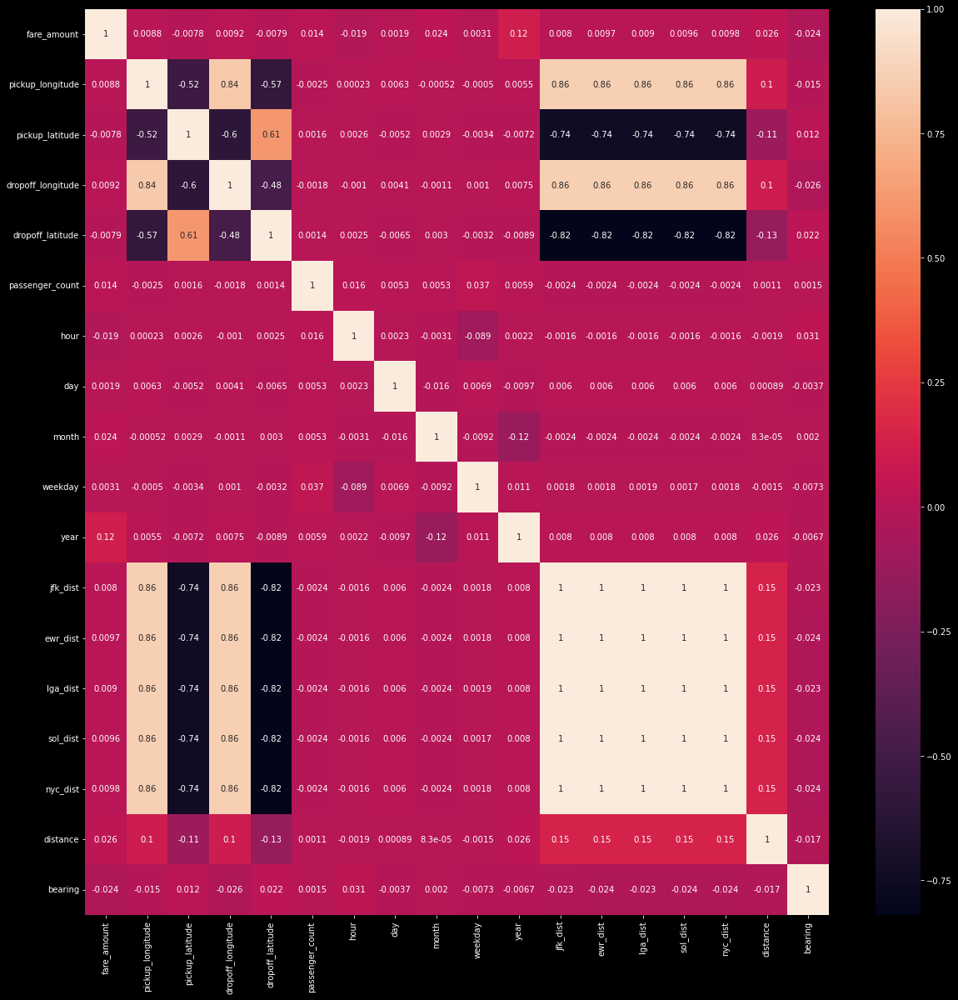

In [16]:
plt.figure(figsize=(20, 20))
cor = data.select_dtypes(include=[np.number]).corr()

# Generate a heatmap
sns.heatmap(cor, xticklabels=cor.columns, yticklabels=cor.columns,annot=True )

# Show the plot
plt.show()



In [17]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 499995 entries, 0 to 499999
Data columns (total 26 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   User ID            499995 non-null  object 
 1   User Name          499995 non-null  object 
 2   Driver Name        499995 non-null  object 
 3   Car Condition      499995 non-null  object 
 4   Weather            499995 non-null  object 
 5   Traffic Condition  499995 non-null  object 
 6   key                499995 non-null  object 
 7   fare_amount        499995 non-null  float64
 8   pickup_datetime    499995 non-null  object 
 9   pickup_longitude   499995 non-null  float64
 10  pickup_latitude    499995 non-null  float64
 11  dropoff_longitude  499995 non-null  float64
 12  dropoff_latitude   499995 non-null  float64
 13  passenger_count    499995 non-null  int64  
 14  hour               499995 non-null  int64  
 15  day                499995 non-null  int64  
 16  mo

### Handling Outliers

In [4]:
#check for outliers

def find_outliers(df):
    '''
    Find outliers in a DataFrame

    Parameters
    ----------
    df : pandas.DataFrame
    '''
    outliers = {}
    for column in df.columns:
        if pd.api.types.is_numeric_dtype(df[column]):
            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            outliers[column] = df[(df[column] < lower_bound) | (df[column] > upper_bound)][column].tolist()
            print(f"Number of outliers in column {column}: {len(outliers[column])}")
    return outliers

def remove_outliers(df):
    '''
    Remove outliers from a DataFrame

    Parameters
    ----------
    df : pandas.DataFrame
    '''
    for column in df.columns:
        if pd.api.types.is_numeric_dtype(df[column]):
            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

def replace_outliers_with_median(df, threshold=3):
    """
    Detects outliers in a DataFrame and replaces them with the median value.

    Parameters:
    - df (pd.DataFrame): The input DataFrame.
    - threshold (float): The Z-score threshold to identify outliers.

    Returns:
    - pd.DataFrame: DataFrame with outliers replaced by the column median.
    """
    df = df.copy()  # Create a copy of the DataFrame to avoid modifying the original one
    numeric_cols = df.select_dtypes(include=[np.number]).columns  # Select only numeric columns
    
    for col in numeric_cols:
        col_median = df[col].median()
        col_mean = df[col].mean()
        col_std = df[col].std()
        z_scores = (df[col] - col_mean) / col_std
        outliers = np.abs(z_scores) > threshold
        df.loc[outliers, col] = col_median
    
    return df


In [19]:
# Check for outliers in the DataFrame
outliers = find_outliers(df_cleaned)

# Print outliers
print("Outliers found:")
for column, values in outliers.items():
    print(f"{column}: {values}")

Number of outliers in column fare_amount: 43329
Number of outliers in column pickup_longitude: 33965
Number of outliers in column pickup_latitude: 23701
Number of outliers in column dropoff_longitude: 35805
Number of outliers in column dropoff_latitude: 30748
Number of outliers in column passenger_count: 56526
Number of outliers in column hour: 0
Number of outliers in column day: 0
Number of outliers in column month: 0
Number of outliers in column weekday: 0
Number of outliers in column year: 0
Number of outliers in column jfk_dist: 59285
Number of outliers in column ewr_dist: 28380
Number of outliers in column lga_dist: 22539
Number of outliers in column sol_dist: 18610
Number of outliers in column nyc_dist: 21940
Number of outliers in column distance: 41925
Number of outliers in column bearing: 0
Outliers found:
fare_amount: [22.54, 31.9, 58.0, 25.5, 34.67, 24.9, 52.0, 35.0, 32.5, 49.57, 22.5, 52.5, 35.5, 23.0, 24.5, 27.0, 26.9, 42.5, 30.9, 49.57, 25.3, 57.33, 26.67, 25.0, 43.5, 34.0

In [ ]:
#replace outliers with mean
df_cleaned = replace_outliers_with_median(df_cleaned)

In [5]:
# Remove outliers from the DataFrame
df_cleaned = remove_outliers(df_cleaned)

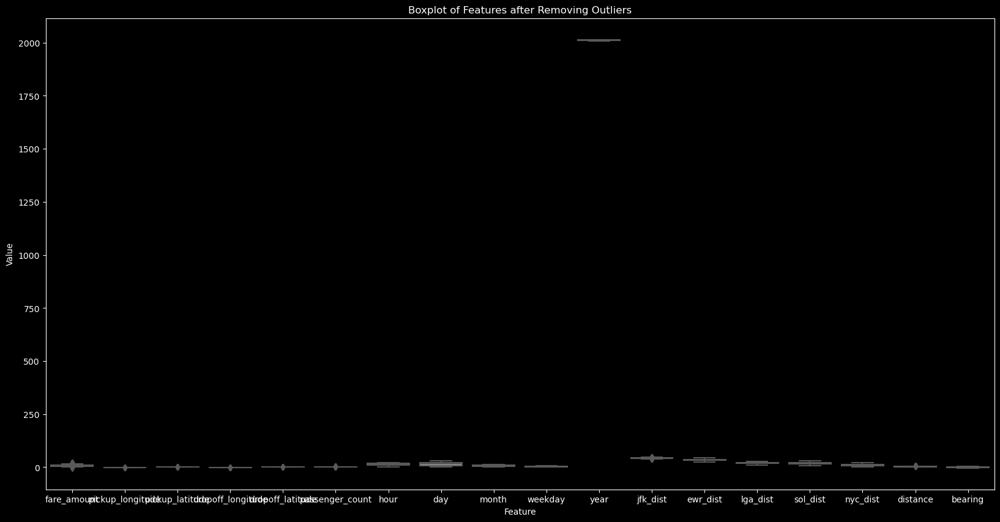

In [8]:
# Plotting boxplot after removing outliers
plt.figure(figsize=(20, 10))  # Adjust the figure size if needed
sns.boxplot(data=df_cleaned, palette='Set2')
plt.title('Boxplot of Features after Removing Outliers')
plt.xlabel('Feature')
plt.ylabel('Value')

# Show the plot
plt.show()

In [6]:
columns_need_labels = ['Car Condition', 'Weather', 'Traffic Condition']
df_cleaned_labeled = df_cleaned.copy()

# Apply one-hot encoding using get_dummies
df_cleaned_labeled = pd.get_dummies(df_cleaned_labeled, columns=columns_need_labels,drop_first=True)

# print("\nDataframe after applying one-hot encoding:")
# print(df_cleaned_labeled.head())


In [7]:


#change every true and false to 1 and 0
df_cleaned_labeled=df_cleaned_labeled.replace({True:1,False:0})


df_cleaned_labeled.head()

,User ID,User Name,Driver Name,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,...,bearing,Car Condition_Excellent,Car Condition_Good,Car Condition_Very Good,Weather_rainy,Weather_stormy,Weather_sunny,Weather_windy,Traffic Condition_Dense Traffic,Traffic Condition_Flow Traffic
2,gsVN8JLS,Elizabeth Lopez,Amanda Jackson,2011-08-18 00:35:00.00000049,5.7,2011-08-18 00:35:00,-1.291242,0.711418,-1.291391,0.711231,...,2.599961,0,0,0,0,1,0,0,0,0
3,9I7kWFgd,Steven Wilson,Amy Horn,2012-04-21 04:30:42.0000001,7.7,2012-04-21 04:30:42,-1.291319,0.710927,-1.291396,0.711363,...,0.133905,0,0,1,0,1,0,0,0,1
4,8QN5ZaGN,Alexander Andrews,Cassandra Larson,2010-03-09 07:51:00.000000135,5.3,2010-03-09 07:51:00,-1.290987,0.711536,-1.290787,0.711811,...,-0.502703,0,0,0,0,1,0,0,0,0
5,mMC7oPiW,Kayla Martin,Wendy Bennett,2011-01-06 09:50:45.0000002,12.1,2011-01-06 09:50:45,-1.291560,0.710901,-1.291071,0.711365,...,-0.674251,1,0,0,0,0,1,0,0,0
6,A2SNLxxM,James Burch,Casey Cannon,2012-11-20 20:35:00.0000001,7.5,2012-11-20 20:35:00,-1.291195,0.711251,-1.291086,0.711481,...,-0.342260,1,0,0,0,0,0,1,0,1


In [18]:
columns_need_labeles=['User Name', 'Driver Name', 'Car Condition', 'Weather',
       'Traffic Condition']
label_encoders = {}
df_cleaned_labeled=df_cleaned.copy()
for column in columns_need_labeles:
    le = LabelEncoder()
    df_cleaned_labeled[column] = le.fit_transform(df_cleaned_labeled[column])
    label_encoders[column] = le
    mapping = dict(zip(le.classes_, le.transform(le.classes_)))
    print("\nMapping of Labels to Original Categories:")
    print(mapping)
#print(df_cleaned.select_dtypes(include=['object']).columns)
#print(task2_data2.select_dtypes(include=['object']).columns)


Mapping of Labels to Original Categories:
{'Aaron Abbott': 0, 'Aaron Acevedo': 1, 'Aaron Acosta': 2, 'Aaron Adams': 3, 'Aaron Adkins': 4, 'Aaron Aguilar': 5, 'Aaron Alexander': 6, 'Aaron Allen': 7, 'Aaron Alvarado': 8, 'Aaron Alvarez': 9, 'Aaron Andersen': 10, 'Aaron Anderson': 11, 'Aaron Andrews': 12, 'Aaron Arellano': 13, 'Aaron Armstrong': 14, 'Aaron Arnold': 15, 'Aaron Arroyo': 16, 'Aaron Atkinson MD': 17, 'Aaron Avila': 18, 'Aaron Ayala': 19, 'Aaron Bailey': 20, 'Aaron Baird': 21, 'Aaron Baker': 22, 'Aaron Baldwin': 23, 'Aaron Ball': 24, 'Aaron Banks': 25, 'Aaron Barker': 26, 'Aaron Barnes': 27, 'Aaron Barnett': 28, 'Aaron Barrett': 29, 'Aaron Barron': 30, 'Aaron Barton': 31, 'Aaron Bates DDS': 32, 'Aaron Bauer': 33, 'Aaron Bautista': 34, 'Aaron Bean': 35, 'Aaron Beard': 36, 'Aaron Beasley': 37, 'Aaron Beck': 38, 'Aaron Becker': 39, 'Aaron Bell': 40, 'Aaron Benitez Jr.': 41, 'Aaron Benjamin': 42, 'Aaron Bennett': 43, 'Aaron Benson': 44, 'Aaron Bentley': 45, 'Aaron Benton': 46, 'A

In [21]:
df_cleaned.shape

(499995, 26)

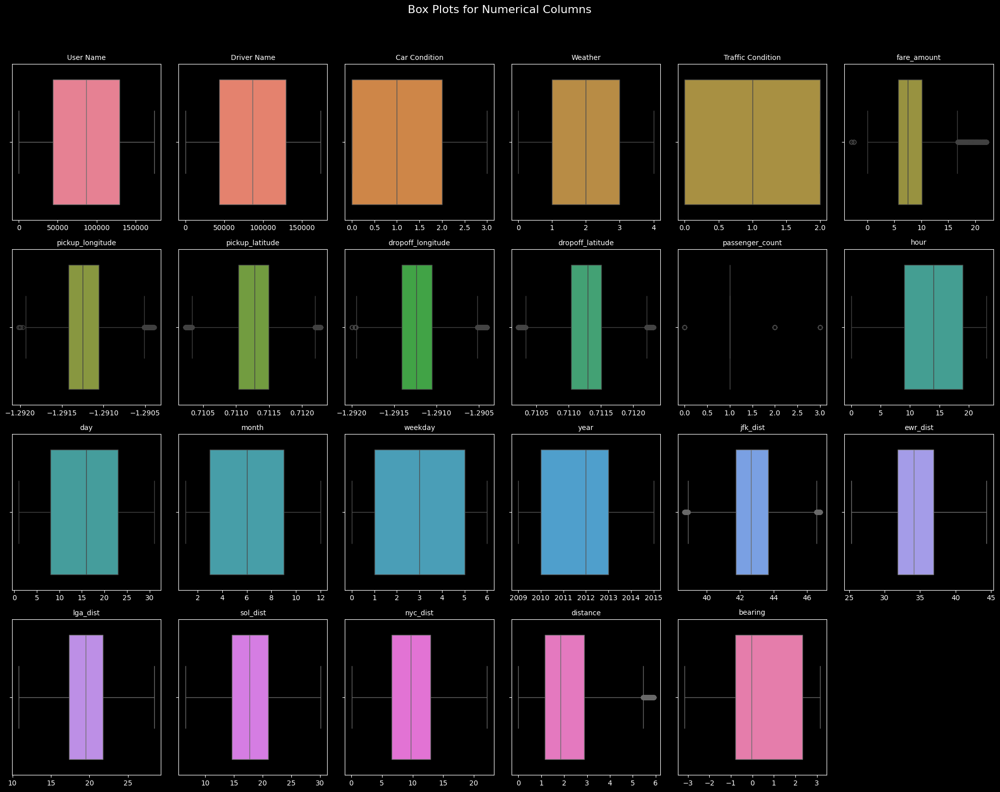

In [60]:
outliers_list = ['User Name', 'Driver Name', 'Car Condition', 'Weather', 'Traffic Condition', 'fare_amount',
                 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'passenger_count',
                 'hour', 'day', 'month', 'weekday', 'year', 'jfk_dist', 'ewr_dist', 'lga_dist', 'sol_dist',
                 'nyc_dist', 'distance', 'bearing']

def draw_box_plot(data):
    # Number of columns per row in the plot
    n_cols = 6
    # Calculate the number of rows needed
    n_rows = (len(outliers_list) + n_cols - 1) // n_cols

    # Create a figure with a grid of subplots
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 4 * n_rows))
    fig.suptitle('Box Plots for Numerical Columns', fontsize=16)

    # Flatten the axes array for easy iteration
    axes = axes.flatten()

    # Generate random colors for each subplot
    colors = sns.color_palette("husl", len(outliers_list))  # Generate a color palette

    # Plot each numerical column
    for ax, column, color in zip(axes, outliers_list, colors):
        sns.boxplot(x=data[column], ax=ax, color=color)
        ax.set_title(column, fontsize=10)
        ax.set_xlabel('')

    # Hide any empty subplots
    for i in range(len(outliers_list), len(axes)):
        fig.delaxes(axes[i])

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

draw_box_plot(df_cleaned_labeled)

In [22]:
df_cleaned_labeled.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 499995 entries, 0 to 499999
Data columns (total 26 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   User ID            499995 non-null  object 
 1   User Name          499995 non-null  int32  
 2   Driver Name        499995 non-null  int32  
 3   Car Condition      499995 non-null  int32  
 4   Weather            499995 non-null  int32  
 5   Traffic Condition  499995 non-null  int32  
 6   key                499995 non-null  object 
 7   fare_amount        499995 non-null  float64
 8   pickup_datetime    499995 non-null  object 
 9   pickup_longitude   499995 non-null  float64
 10  pickup_latitude    499995 non-null  float64
 11  dropoff_longitude  499995 non-null  float64
 12  dropoff_latitude   499995 non-null  float64
 13  passenger_count    499995 non-null  int64  
 14  hour               499995 non-null  int64  
 15  day                499995 non-null  int64  
 16  mo

In [23]:
not_columns=['User ID','key','pickup_datetime']
disturbution_list = [col for col in list(df_cleaned_labeled) if col not in not_columns]
len(disturbution_list)


23

In [24]:
def remove_outlierss(task2_data2, column):
    Q1 = task2_data2[column].quantile(0.25)
    Q3 = task2_data2[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return task2_data2[(task2_data2[column] >= lower_bound) & (task2_data2[column] <= upper_bound)]
def count_outliers(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers_count = data[(data[column] < lower_bound) | (data[column] > upper_bound)].shape[0]
    return outliers_count

def count_all_outliers(data):
    outliers_counts = {}
    numerical_columns = data.select_dtypes(include='number').columns
    for col in numerical_columns:
        outliers_counts[col] = count_outliers(data, col)
    return outliers_counts

# Example usage
# Assuming task2_data2 is your DataFrame containing numerical columns
outliers_counts = count_all_outliers(df_cleaned_labeled)
print("Number of outliers for each numerical column:")
print(outliers_counts)
# Remove outliers for all numerical columns
df_clean = df_cleaned_labeled.copy()
for column in ['distance','fare_amount','passenger_count','jfk_dist']:
    df_clean = remove_outlierss(df_clean, column)

print("\nDataFrame after removing outliers for all numerical columns:")
print( df_clean.shape)

Number of outliers for each numerical column:
{'User Name': 0, 'Driver Name': 0, 'Car Condition': 0, 'Weather': 0, 'Traffic Condition': 0, 'fare_amount': 43329, 'pickup_longitude': 33965, 'pickup_latitude': 23701, 'dropoff_longitude': 35805, 'dropoff_latitude': 30748, 'passenger_count': 56526, 'hour': 0, 'day': 0, 'month': 0, 'weekday': 0, 'year': 0, 'jfk_dist': 59285, 'ewr_dist': 28380, 'lga_dist': 22539, 'sol_dist': 18610, 'nyc_dist': 21940, 'distance': 41925, 'bearing': 0}

DataFrame after removing outliers for all numerical columns:
(360496, 26)


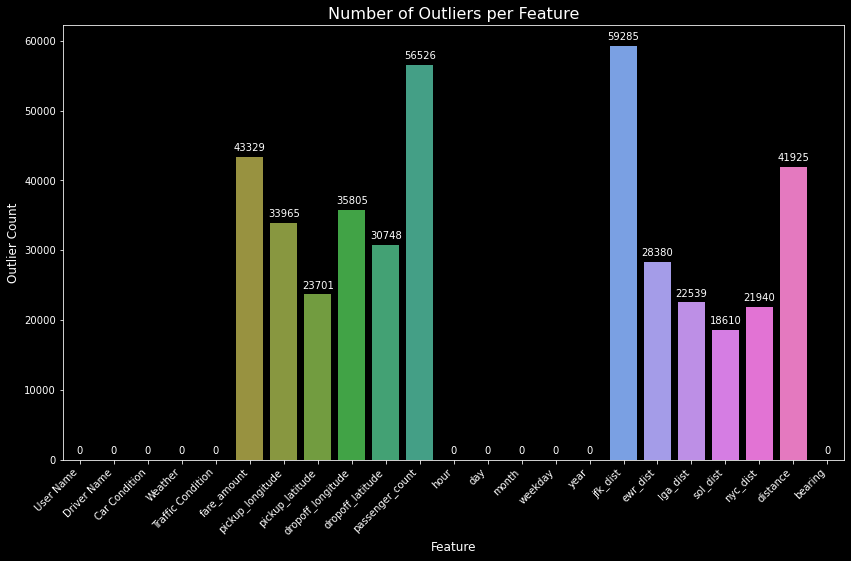

In [25]:
# Function to count outliers in each column
def count_outliers(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers_count = data[(data[column] < lower_bound) | (data[column] > upper_bound)].shape[0]
    return outliers_count

# Function to count outliers for all numerical columns
def count_all_outliers(data):
    outliers_counts = {}
    numerical_columns = data.select_dtypes(include='number').columns
    for col in numerical_columns:
        outliers_counts[col] = count_outliers(data, col)
    return outliers_counts

# Count outliers for each numerical column
outliers_counts = count_all_outliers(df_cleaned_labeled)

# Check if outliers_counts is not empty
if outliers_counts:
    # Create a DataFrame from the outliers count dictionary
    outliers_df = pd.DataFrame(list(outliers_counts.items()), columns=['Feature', 'Outlier Count'])

    # Plotting the bar plot
    plt.figure(figsize=(14, 8))

    # Use the "husl" color palette for distinct colors
    palette = sns.color_palette("husl", len(outliers_df))

    # Create bar plot
    bar_plot = sns.barplot(x='Feature', y='Outlier Count', data=outliers_df, palette=palette)

    # Add titles and labels
    plt.title('Number of Outliers per Feature', fontsize=16)
    plt.xlabel('Feature', fontsize=12)
    plt.ylabel('Outlier Count', fontsize=12)
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability

    # Add annotations on top of each bar
    for p in bar_plot.patches:
        bar_plot.annotate(format(p.get_height(), '.0f'),
                          (p.get_x() + p.get_width() / 2., p.get_height()),
                          ha='center', va='center',
                          xytext=(0, 9),
                          textcoords='offset points')

    # Show the plot
    plt.show()
else:
    print("No outliers found or the DataFrame is empty.")

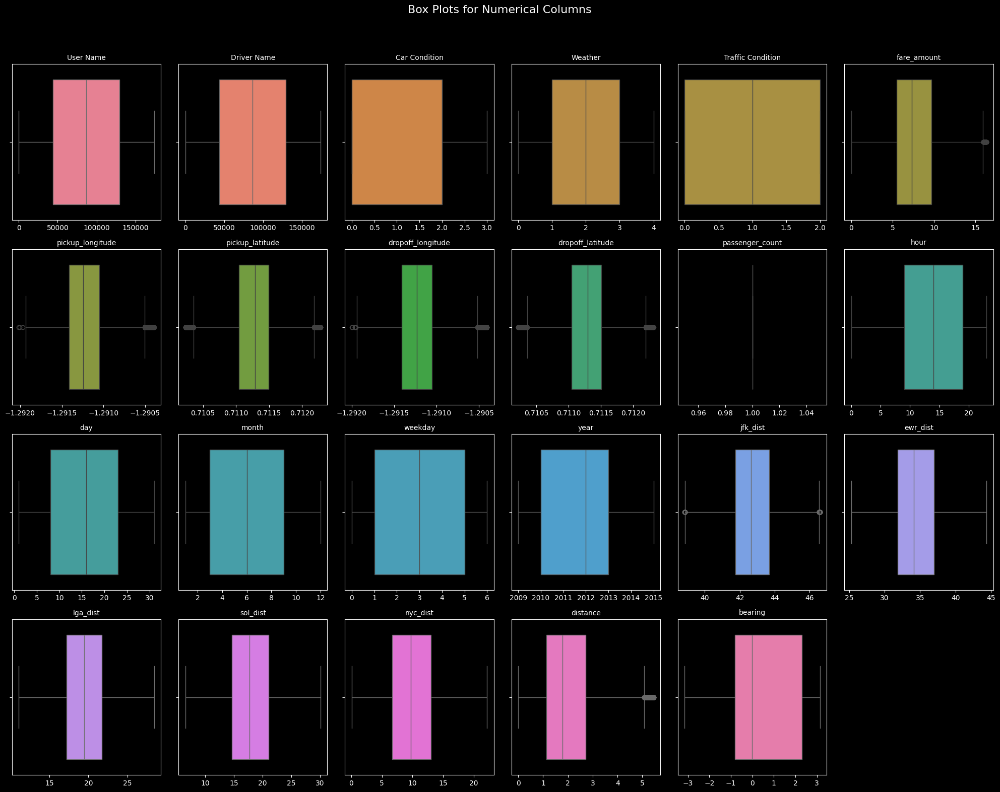

In [65]:
draw_box_plot(df_clean)

# **Pie and Dounuts**

traffic condiions


In [ ]:
data.shape

(500000, 26)

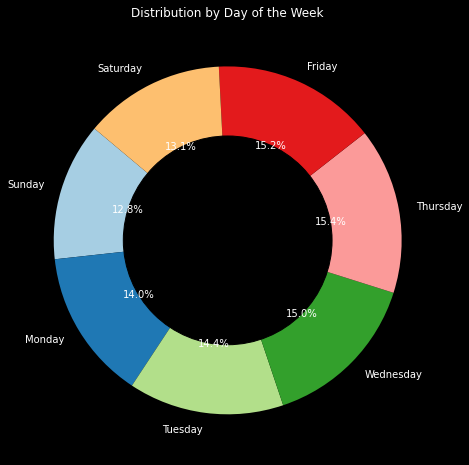

0    64237
1    69929
2    72230
3    74776
4    77224
5    76212
6    65387
Name: weekday, dtype: int64


In [ ]:
day_counts = df_cleaned['weekday'].value_counts().sort_index()

# Define the mapping for display purposes
day_names = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday']
#labels=[day_names[i] for i in day_counts.index]
day_counts.index
# Plotting the donut chart
plt.figure(figsize=(10, 8))
plt.pie(day_counts, labels=[day_names[i] for i in day_counts.index],
        autopct='%1.1f%%', startangle=140, colors=plt.cm.Paired(range(len(day_counts))))
plt.gca().add_artist(plt.Circle((0, 0), 0.6, color='black'))  # Create the 'donut' hole
plt.title('Distribution by Day of the Week')
plt.show()
print(day_counts )

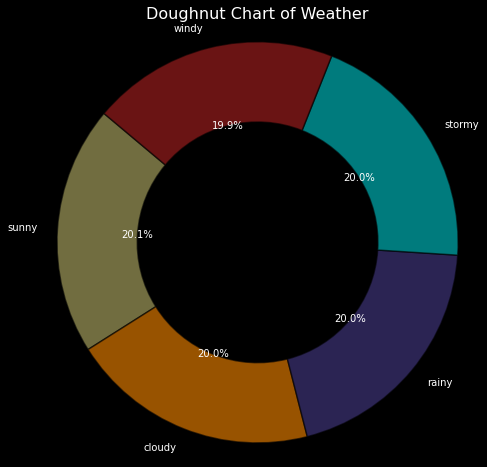

In [ ]:
count_0_1 = df_cleaned['Weather'].value_counts()
# Define colors using seaborn's pastel palette or custom colors
colors = ['#bdb76b', '#ff8c00', '#483d8b', '#00ced1','#b22222']

# Create a figure
plt.figure(figsize=(8, 8))

# Create the pie chart and add a hole in the center
plt.pie(
    count_0_1,
    labels=count_0_1.index,
    autopct='%1.1f%%',
    startangle=140,
    colors=colors,
    wedgeprops=dict(width=0.4, edgecolor='black', linewidth=1.5, alpha=0.6)
)

# Add a title
plt.title('Doughnut Chart of Weather', fontsize=16)

# Ensure the chart is a circle
plt.axis('equal')

# Show the plot
plt.show()

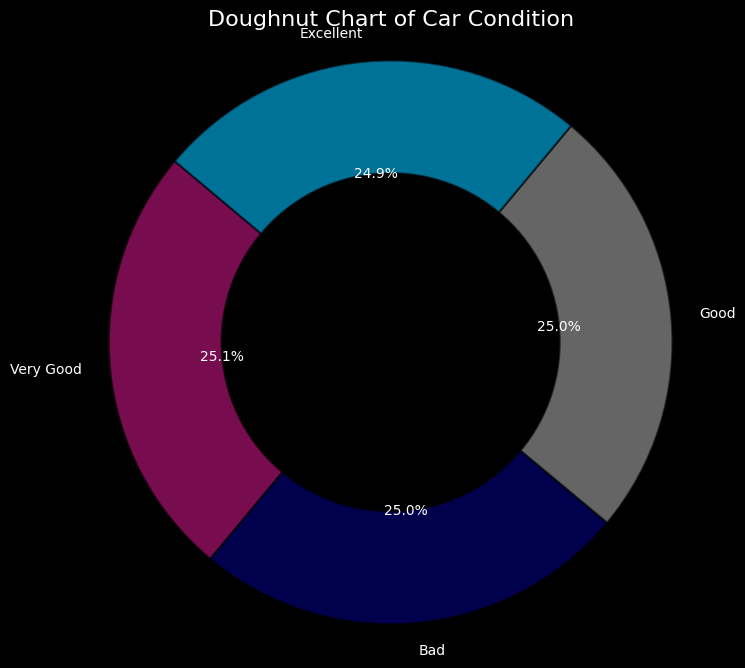

In [ ]:
count_0_1 = df_cleaned['Car Condition'].value_counts()

# Define colors using seaborn's pastel palette or custom colors
colors = ['#c71585', '#000080', '#a9a9a9', '#00bfff']

# Create a figure
plt.figure(figsize=(8, 8))

# Create the pie chart and add a hole in the center
plt.pie(
    count_0_1,
    labels=count_0_1.index,
    autopct='%1.1f%%',
    startangle=140,
    colors=colors,
    wedgeprops=dict(width=0.4, edgecolor='black', linewidth=1.5, alpha=0.6)
)

# Add a title
plt.title('Doughnut Chart of Car Condition', fontsize=16)

# Ensure the chart is a circle
plt.axis('equal')

# Show the plot
plt.show()

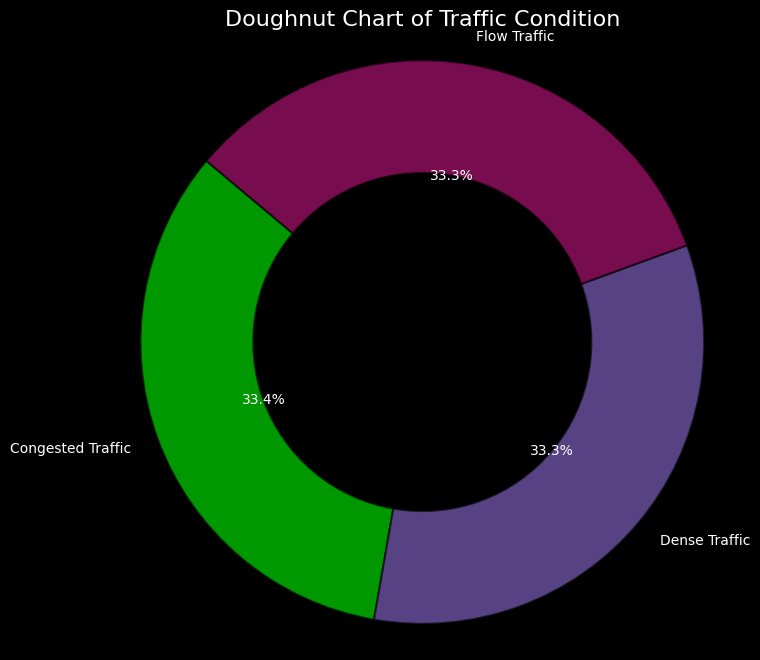

In [ ]:
count_0_1 = df_cleaned['Traffic Condition'].value_counts()
# Define colors using seaborn's pastel palette or custom colors
colors = ['#00ff00', '#9370db', '#c71585']

# Create a figure
plt.figure(figsize=(8, 8))

# Create the pie chart and add a hole in the center
plt.pie(
    count_0_1,
    labels=count_0_1.index,
    autopct='%1.1f%%',
    startangle=140,
    colors=colors,
    wedgeprops=dict(width=0.4, edgecolor='black', linewidth=1.5, alpha=0.6)
)

# Add a title
plt.title('Doughnut Chart of Traffic Condition', fontsize=16)

# Ensure the chart is a circle
plt.axis('equal')

# Show the plot
plt.show()

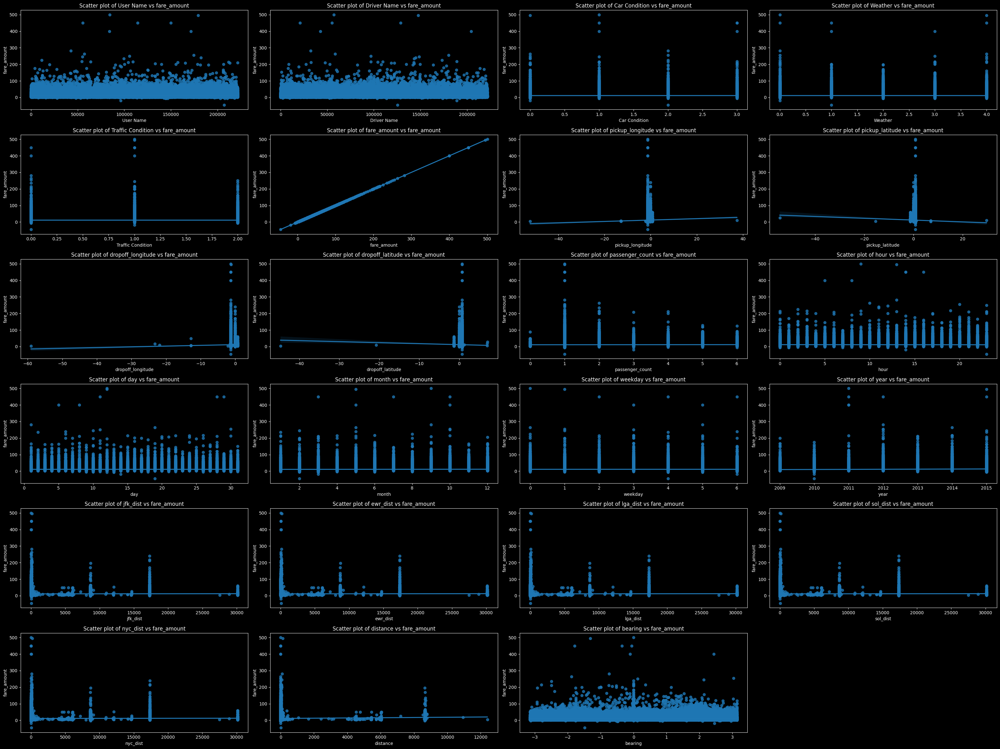

In [ ]:
target_col = 'fare_amount'  # Assuming this is the correct column name

num_cols = len(disturbution_list)
cols_per_row = 4
rows = (num_cols - 1) // cols_per_row + 1

# Create a figure
plt.figure(figsize=(32, 24))

# Iterate over each feature and plot
for i, col in enumerate(disturbution_list):
    plt.subplot(rows, cols_per_row, i + 1)
    sns.regplot(x=col, y=target_col, data=df_cleaned_labeled, color='#1f77b4')  # Set color for consistency
    plt.xlabel(col)
    plt.ylabel(target_col)
    plt.title(f'Scatter plot of {col} vs {target_col}')

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

# Important Histogarms


Drivers

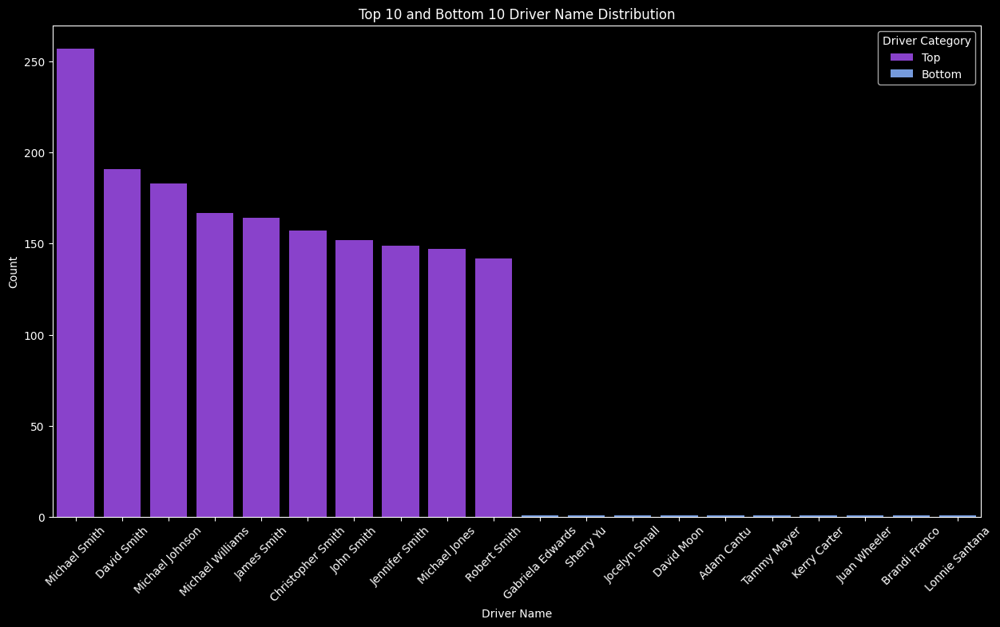

The most frequently used driver is 'Michael Smith' with 257 occurrences.
The least frequently used driver is 'Monica Villegas' with 1 occurrences.


In [ ]:
driver_counts = df_cleaned['Driver Name'].value_counts()
most_frequent_driver = driver_counts.idxmax()
most_frequent_count = driver_counts.max()
least_frequent_driver = driver_counts.idxmin()
least_frequent_count = driver_counts.min()

# Get top 10 and bottom 10 drivers
top_10_drivers = driver_counts.head(10)
bottom_10_drivers = driver_counts.tail(10)

combined_drivers = pd.concat([top_10_drivers, bottom_10_drivers])

# Create labels for the drivers: Top or Bottom
driver_labels = ['Top'] * 10 + ['Bottom'] * 10

# Create a new DataFrame for plotting
df_plot = pd.DataFrame({
    'Driver Name': combined_drivers.index,
    'Count': combined_drivers.values,
    'Label': driver_labels
})

# Plotting the histogram
plt.figure(figsize=(15, 8))

sns.barplot(
    data=df_plot,
    x='Driver Name',
    y='Count',
    hue='Label',
    dodge=False,
    palette={'Top': '#8a2be2', 'Bottom': '#6495ed'}
)

# Add titles and labels
plt.title('Top 10 and Bottom 10 Driver Name Distribution')
plt.xlabel('Driver Name')
plt.ylabel('Count')
plt.xticks(rotation=45)  # Rotate driver names for better readability
plt.legend(title='Driver Category')

# Show the plot
plt.show()

# Print the most frequently used driver name
print(f"The most frequently used driver is '{most_frequent_driver}' with {most_frequent_count} occurrences.")
print(f"The least frequently used driver is '{least_frequent_driver}' with {least_frequent_count} occurrences.")


In [ ]:
driver_counts = df_cleaned['Driver Name'].value_counts()

# Identify the minimum count value
min_count_value = driver_counts.min()

# Get all drivers with the minimum count
min_count_drivers = driver_counts[driver_counts == min_count_value]

# Get top 10 drivers
top_10_drivers = driver_counts.head(10)

# Combine top 10 drivers with those having the minimum count
combined_drivers = pd.concat([top_10_drivers, min_count_drivers])

# Create labels for the drivers: Top or Min Count
driver_labels = ['Top'] * len(top_10_drivers) + ['Min Count'] * len(min_count_drivers)
print
# Create a new DataFrame for plotting
df_plot = pd.DataFrame({
    'Driver Name': combined_drivers.index,
    'Count': combined_drivers.values,
    'Label': driver_labels
})

# Plotting the histogram
'''plt.figure(figsize=(15, 8))

sns.barplot(
    data=df_plot,
    x='Driver Name',
    y='Count',
    hue='Label',
    dodge=False,
    palette={'Top': '#8a2be2', 'Min Count': '#ff6347'}
)

# Add titles and labels
plt.title('Top Drivers and Drivers with Minimum Count Distribution')
plt.xlabel('Driver Name')
plt.ylabel('Count')
plt.xticks(rotation=45)  # Rotate driver names for better readability
plt.legend(title='Driver Category')

# Adjust y-axis limits
plt.ylim(0, max(df_plot['Count']) * 1.1)  # Add a bit of space above the highest bar

# Show the plot
plt.show()'''

# Print the most and least frequently used driver names
most_frequent_driver = driver_counts.idxmax()
most_frequent_count = driver_counts.max()
least_frequent_driver = driver_counts.idxmin()
least_frequent_count = driver_counts.min()

print(f"The most frequently used driver is '{most_frequent_driver}' with {most_frequent_count} occurrences.")
print(f"The least frequently used driver is '{least_frequent_driver}' with {least_frequent_count} occurrences.")

The most frequently used driver is 'Michael Smith' with 257 occurrences.
The least frequently used driver is 'Monica Villegas' with 1 occurrences.


Users

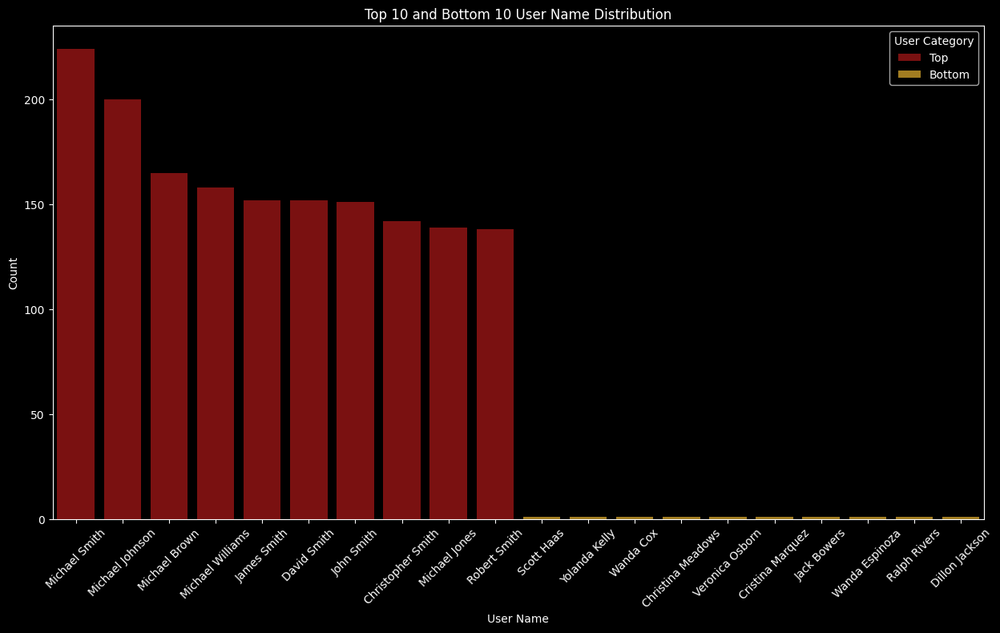

The most frequently user is 'Michael Smith' with 224 occurrences.
The least frequently user is 'Danielle Richards DVM' with 1 occurrences.


In [ ]:
Users_counts = df_cleaned['User Name'].value_counts()
most_frequent_user = Users_counts.idxmax()
most_frequent_count = Users_counts.max()
least_frequent_user= Users_counts.idxmin()
least_frequent_count = Users_counts.min()

# Get top 10 and bottom 10 users
top_10_users = Users_counts.head(10)
bottom_10_users = Users_counts.tail(10)

combined_users = pd.concat([top_10_users, bottom_10_users])

# Create labels for the drivers: Top or Bottom
Users_labels = ['Top'] * 10 + ['Bottom'] * 10

# Create a new DataFrame for plotting
df_plot = pd.DataFrame({
    'User Name':combined_users.index,
    'Count': combined_users.values,
    'Label': Users_labels
})

# Plotting the histogram
plt.figure(figsize=(15, 8))

sns.barplot(
    data=df_plot,
    x='User Name',
    y='Count',
    hue='Label',
    dodge=False,
    palette={'Top': '#8b0000', 'Bottom': '#b8860b'}
)

# Add titles and labels
plt.title('Top 10 and Bottom 10 User Name Distribution')
plt.xlabel('User Name')
plt.ylabel('Count')
plt.xticks(rotation=45)  # Rotate driver names for better readability
plt.legend(title='User Category')

# Show the plot
plt.show()

# Print the most frequently used driver name
print(f"The most frequently user is '{most_frequent_user}' with {most_frequent_count} occurrences.")
print(f"The least frequently user is '{least_frequent_user}' with {least_frequent_count} occurrences.")


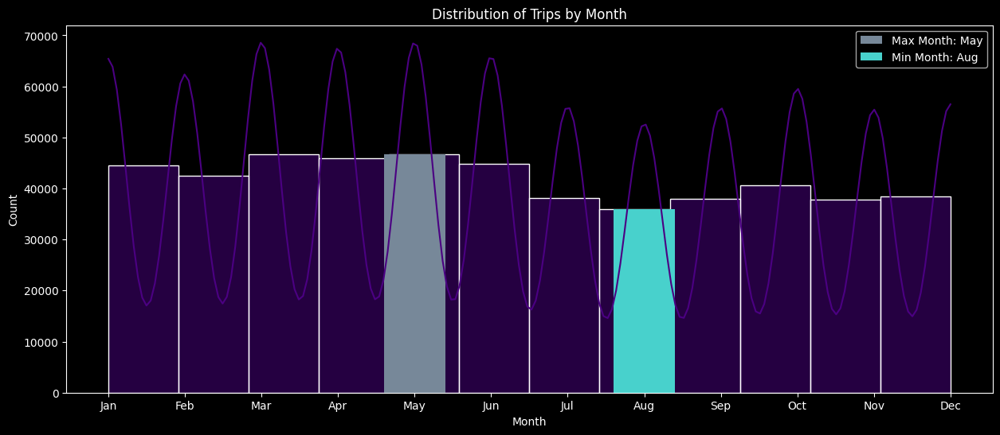

Counts for each month:
Jan: 44547
Feb: 42454
Mar: 46714
Apr: 45959
May: 46733
Jun: 44827
Jul: 38127
Aug: 35871
Sep: 37979
Oct: 40551
Nov: 37757
Dec: 38476


In [ ]:
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
month_counts = df_cleaned['month'].value_counts().sort_index()
df_cleaned['month'] = df_cleaned['month'].astype(int)
max_month = month_counts.idxmax()
max_count = month_counts.max()
min_month = month_counts.idxmin()
min_count = month_counts.min()
# Plotting the histogram
plt.figure(figsize=(15, 6))
sns.histplot(df_cleaned['month'], bins=12, kde=True, color='#4b0082')
plt.bar(max_month , max_count, color='#778899', label=f'Max Month: {month_names[max_month-1]}')
plt.bar(min_month , min_count, color='#48d1cc', label=f'Min Month: {month_names[min_month-1]}')
plt.xlabel('Month')
plt.ylabel('Count')
plt.title('Distribution of Trips by Month')
plt.xticks(range(1, 13), month_names)
plt.legend()

# Add titles and labels
# Show the plot
plt.show()
print("Counts for each month:")

for i, count in enumerate(month_counts):
    print(f"{month_names[i]}: {count}")

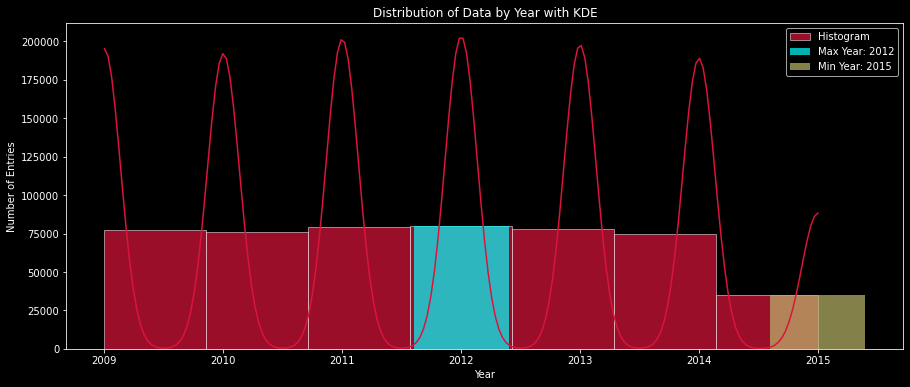

Counts for each year:
2009: 77002
2010: 75791
2011: 79528
2012: 80222
2013: 78033
2014: 74608
2015: 34811


In [ ]:
year_counts = df_cleaned['year'].value_counts().sort_index()
# Identify the year with the maximum count
max_year = year_counts.idxmax()
max_count = year_counts.max()
min_year = year_counts.idxmin()
min_count = year_counts.min()
# Plotting the histogram with KDE and highlighted max year
plt.figure(figsize=(15, 6))

# Plot histogram and KDE
sns.histplot(df_cleaned['year'], bins=len(year_counts), kde=True, color='#dc143c', alpha=0.7, linewidth=0.5, label='Histogram')
# Highlight the max year
plt.bar(max_year, max_count, color='#00ffff', label=f'Max Year: {max_year}', alpha=0.7)
plt.bar(min_year, min_count, color='#bdb76b', label=f'Min Year: {min_year}', alpha=0.7)

# Add titles and labels
plt.title('Distribution of Data by Year with KDE')
plt.xlabel('Year')
plt.ylabel('Number of Entries')

# Add legend
plt.legend()

# Show the plot
plt.show()

# Print counts for each year
print("Counts for each year:")
for year, count in year_counts.items():
    print(f"{year}: {count}")

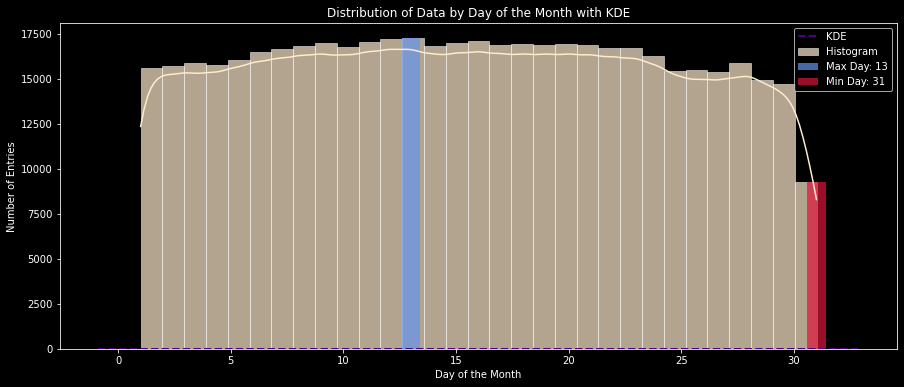

In [ ]:
day_counts = df_cleaned['day'].value_counts().sort_index()

# Identify the day with the maximum and minimum count
max_day = day_counts.idxmax()
max_count = day_counts.max()
min_day = day_counts.idxmin()
min_count = day_counts.min()

# Plotting the histogram with KDE and highlighted max and min days
plt.figure(figsize=(15, 6))

# Plot histogram and KDE
sns.histplot(df_cleaned['day'], bins=31, kde=True, color='#ffebcd', alpha=0.7, linewidth=0.5, label='Histogram')
sns.kdeplot(df_cleaned['day'], color='#4b0082', linewidth=2, label='KDE', linestyle='--')

# Highlight the max and min day
plt.bar(max_day, max_count, color='#6495ed', label=f'Max Day: {max_day}', alpha=0.7)
plt.bar(min_day, min_count, color='#dc143c', label=f'Min Day: {min_day}', alpha=0.7)

# Add titles and labels
plt.title('Distribution of Data by Day of the Month with KDE')
plt.xlabel('Day of the Month')
plt.ylabel('Number of Entries')

# Add legend
plt.legend()

# Show the plot
plt.show()

# Print counts for each day


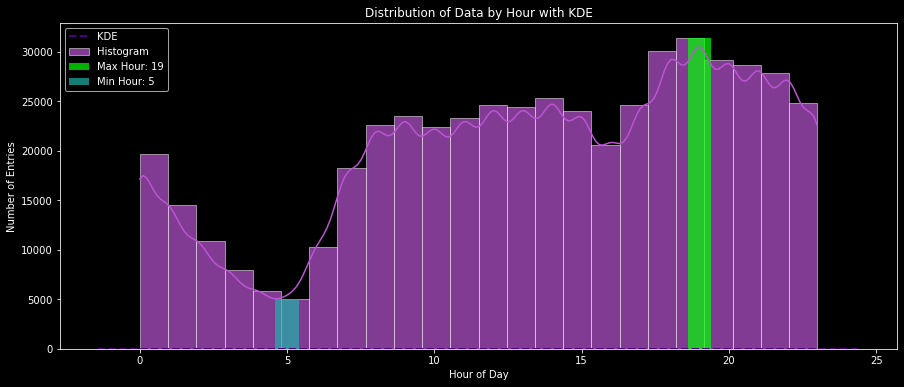

Counts for each hour:
0: 19650
1: 14556
2: 10884
3: 7936
4: 5864
5: 4982
6: 10326
7: 18231
8: 22599
9: 23565
10: 22428
11: 23338
12: 24649
13: 24404
14: 25385
15: 24025
16: 20569
17: 24646
18: 30063
19: 31382
20: 29193
21: 28639
22: 27817
23: 24864


In [ ]:
hour_counts = df_cleaned['hour'].value_counts().sort_index()

# Identify the hour with the maximum and minimum count
max_hour = hour_counts.idxmax()
max_count = hour_counts.max()
min_hour = hour_counts.idxmin()
min_count = hour_counts.min()

# Plotting the histogram with KDE and highlighted max and min hours
plt.figure(figsize=(15, 6))

# Plot histogram and KDE
sns.histplot(df_cleaned['hour'], bins=24, kde=True, color='#ba55d3', alpha=0.7, linewidth=0.5, label='Histogram')
sns.kdeplot(df_cleaned['hour'], color='#4b0082', linewidth=2, label='KDE', linestyle='--')

# Highlight the max and min hour
plt.bar(max_hour, max_count, color='#00ff00', label=f'Max Hour: {max_hour}', alpha=0.7)
plt.bar(min_hour, min_count, color='#20b2aa', label=f'Min Hour: {min_hour}', alpha=0.7)

# Add titles and labels
plt.title('Distribution of Data by Hour with KDE')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Entries')

# Add legend
plt.legend()

# Show the plot
plt.show()

# Print counts for each hour
print("Counts for each hour:")
for hour, count in hour_counts.items():
    print(f"{hour}: {count}")

In [ ]:
df_cleaned.columns

Index(['User ID', 'User Name', 'Driver Name', 'Car Condition', 'Weather',
       'Traffic Condition', 'key', 'fare_amount', 'pickup_datetime',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'passenger_count', 'hour', 'day', 'month',
       'weekday', 'year', 'jfk_dist', 'ewr_dist', 'lga_dist', 'sol_dist',
       'nyc_dist', 'distance', 'bearing'],
      dtype='object')

# Relations with fare amount

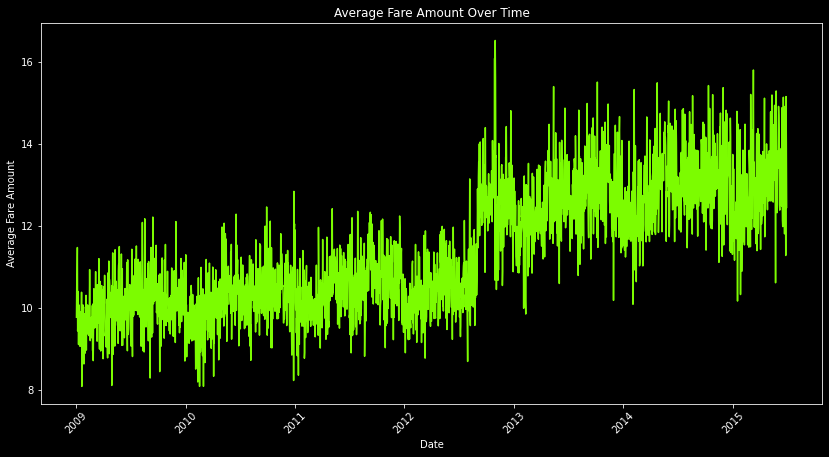

In [ ]:
df_cleaned['pickup_datetime'] = pd.to_datetime(df_cleaned['pickup_datetime'])

# Set the datetime column as the index
df_cleaned.set_index('pickup_datetime', inplace=True)

# Resample by day and calculate the mean fare amount
daily_fare = df_cleaned['fare_amount'].resample('D').mean()

plt.figure(figsize=(14, 7))
sns.lineplot(x=daily_fare.index, y=daily_fare.values, color='#7cfc00')
plt.title('Average Fare Amount Over Time')
plt.xlabel('Date')
plt.ylabel('Average Fare Amount')
plt.xticks(rotation=45)
plt.show()

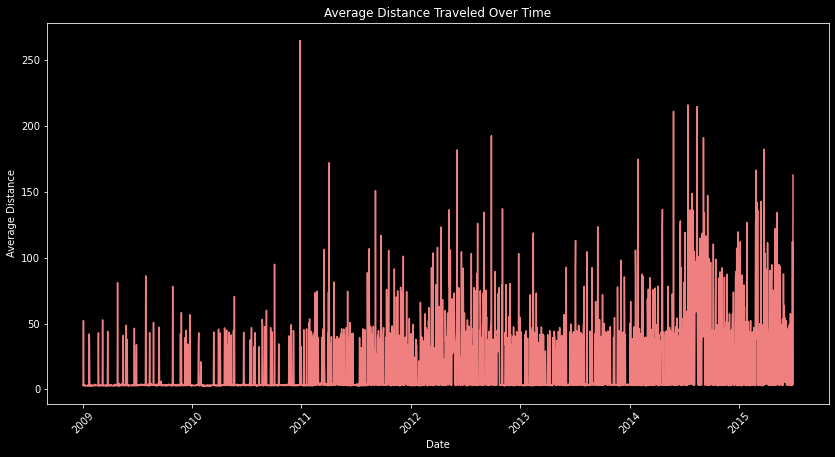

In [ ]:
daily_distance = df_cleaned['distance'].resample('D').mean()

plt.figure(figsize=(14, 7))
sns.lineplot(x=daily_distance.index, y=daily_distance.values, color='#f08080')
plt.title('Average Distance Traveled Over Time')
plt.xlabel('Date')
plt.ylabel('Average Distance')
plt.xticks(rotation=45)
plt.show()

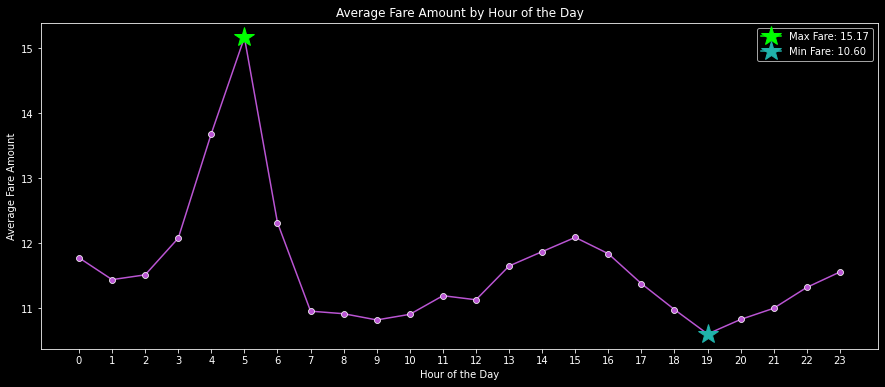

In [ ]:
plt.figure(figsize=(15, 6))

# Aggregate fare amounts by hour
hourly_fare = df_cleaned.groupby('hour')['fare_amount'].mean().reset_index()

# Plotting the line plot
sns.lineplot(x='hour', y='fare_amount', data=hourly_fare, marker='o', color='#ba55d3')

# Identify the hours with the maximum and minimum average fare amount
max_hour = hourly_fare.loc[hourly_fare['fare_amount'].idxmax()]
min_hour = hourly_fare.loc[hourly_fare['fare_amount'].idxmin()]

# Highlight the maximum fare amount with a star
plt.plot(max_hour['hour'], max_hour['fare_amount'], marker='*', markersize=20, color='#00ff00',label=f'Max Fare: {max_hour["fare_amount"]:.2f}')

# Highlight the minimum fare amount with a star
plt.plot(min_hour['hour'], min_hour['fare_amount'], marker='*', markersize=20, color='#20b2aa',label=f'Min Fare: {min_hour["fare_amount"]:.2f}')

# Add titles and labels
plt.title('Average Fare Amount by Hour of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Average Fare Amount')

plt.xticks(range(24))  # Ensure all hours are displayed on the x-axis
plt.grid(False)

# Add legend
plt.legend()

# Show the plot
plt.show()


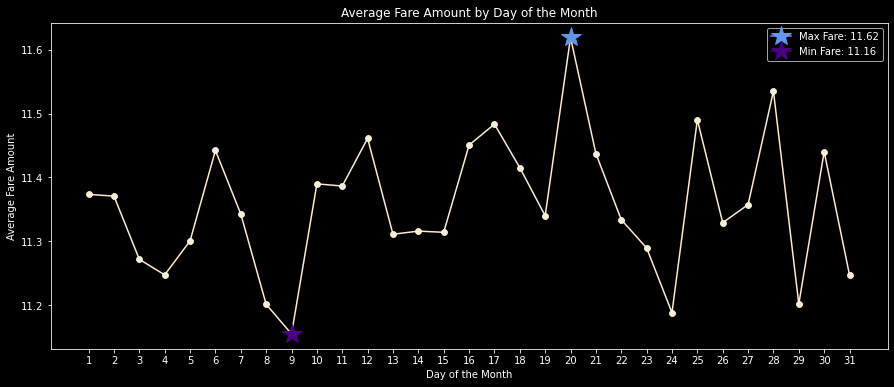

In [ ]:
plt.figure(figsize=(15, 6))

# Aggregate fare amounts by day of the month
daily_fare = df_cleaned.groupby('day')['fare_amount'].mean().reset_index()

# Plotting the line plot
sns.lineplot(x='day', y='fare_amount', data=daily_fare, marker='o', color='#ffebcd')

# Identify the days with the maximum and minimum average fare amount
max_day = daily_fare.loc[daily_fare['fare_amount'].idxmax()]
min_day = daily_fare.loc[daily_fare['fare_amount'].idxmin()]

# Highlight the maximum fare amount with a star
plt.plot(max_day['day'], max_day['fare_amount'], marker='*', markersize=20, color='#6495ed', label=f'Max Fare: {max_day["fare_amount"]:.2f}')

# Highlight the minimum fare amount with a star
plt.plot(min_day['day'], min_day['fare_amount'], marker='*', markersize=20, color='#4b0082', label=f'Min Fare: {min_day["fare_amount"]:.2f}')

# Add titles and labels
plt.title('Average Fare Amount by Day of the Month')
plt.xlabel('Day of the Month')
plt.ylabel('Average Fare Amount')

plt.xticks(range(1, 32))  # Ensure all days are displayed on the x-axis
plt.grid(False )

# Add legend
plt.legend()

# Show the plot
plt.show()



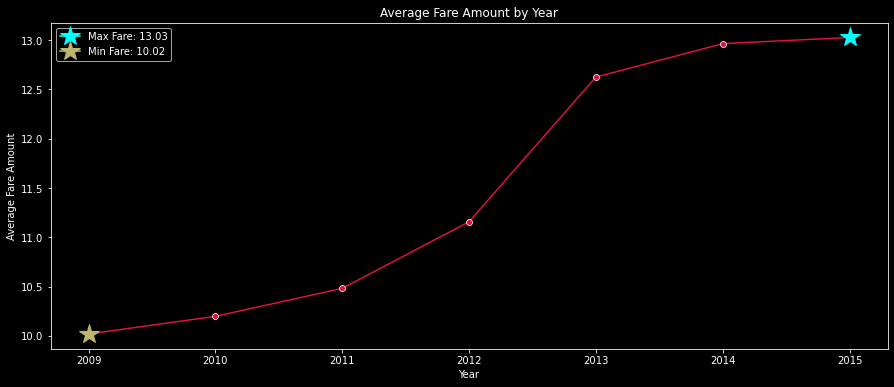

In [ ]:


yearly_fare = df_cleaned.groupby('year')['fare_amount'].mean().reset_index()

# Plotting the line plot
plt.figure(figsize=(15, 6))
sns.lineplot(x='year', y='fare_amount', data=yearly_fare, marker='o', color='#dc143c')

# Identify the years with the maximum and minimum average fare amount
max_year = yearly_fare.loc[yearly_fare['fare_amount'].idxmax()]
min_year = yearly_fare.loc[yearly_fare['fare_amount'].idxmin()]

# Highlight the maximum fare amount with a star
plt.plot(max_year['year'], max_year['fare_amount'], marker='*', markersize=20, color='#00ffff', label=f'Max Fare: {max_year["fare_amount"]:.2f}')

# Highlight the minimum fare amount with a star
plt.plot(min_year['year'], min_year['fare_amount'], marker='*', markersize=20, color='#bdb76b', label=f'Min Fare: {min_year["fare_amount"]:.2f}')

# Add titles and labels
plt.title('Average Fare Amount by Year')
plt.xlabel('Year')
plt.ylabel('Average Fare Amount')

# Ensure all years are displayed on the x-axis
plt.xticks(yearly_fare['year'])

plt.grid(False)

# Add legend
plt.legend()

# Show the plot
plt.show()


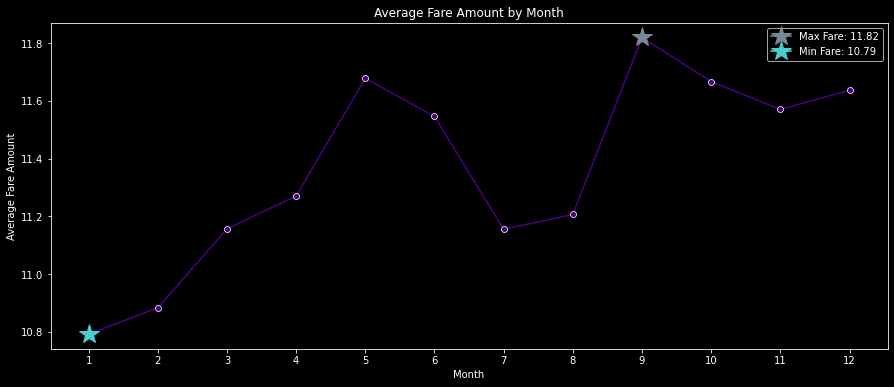

In [ ]:
plt.figure(figsize=(15, 6))

# Aggregate fare amounts by month
monthly_fare = df_cleaned.groupby('month')['fare_amount'].mean().reset_index()

# Plotting the line plot
sns.lineplot(x='month', y='fare_amount', data=monthly_fare, marker='o', color='#4b0082')

# Identify the months with the maximum and minimum average fare amount
max_month = monthly_fare.loc[monthly_fare['fare_amount'].idxmax()]
min_month = monthly_fare.loc[monthly_fare['fare_amount'].idxmin()]

# Highlight the maximum fare amount with a star
plt.plot(max_month['month'], max_month['fare_amount'], marker='*', markersize=20, color='#778899', label=f'Max Fare: {max_month["fare_amount"]:.2f}')

# Highlight the minimum fare amount with a star
plt.plot(min_month['month'], min_month['fare_amount'], marker='*', markersize=20, color='#48d1cc', label=f'Min Fare: {min_month["fare_amount"]:.2f}')

# Add titles and labels
plt.title('Average Fare Amount by Month')
plt.xlabel('Month')
plt.ylabel('Average Fare Amount')

plt.xticks(range(1, 13))  # Ensure all months are displayed on the x-axis
plt.grid(False)

# Add legend
plt.legend()

# Show the plot
plt.show()



No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


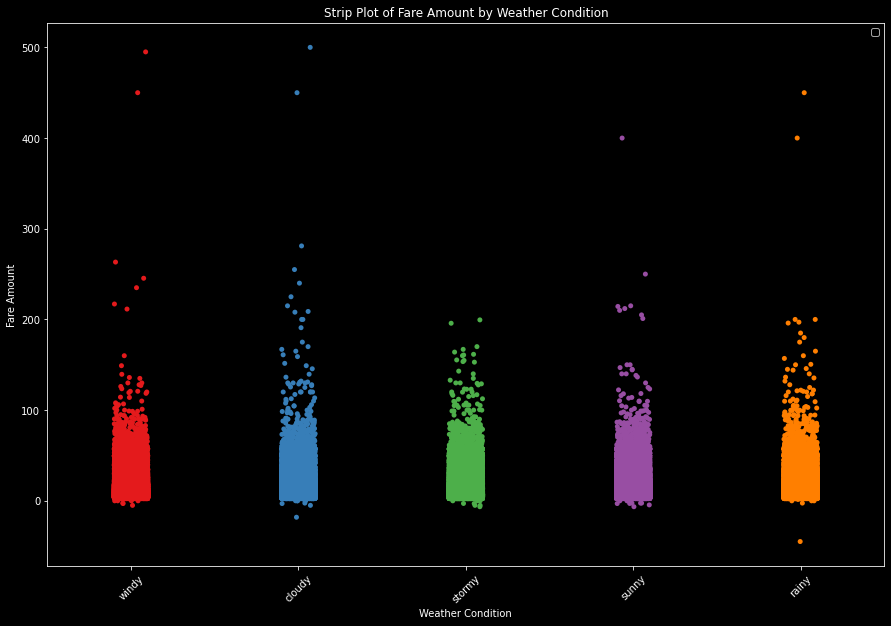

Maximum fare amount: 500.0 in weather condition: cloudy
Minimum fare amount: -44.9 in weather condition: rainy


In [ ]:
# Strip Plot for Weather Condition
plt.figure(figsize=(15, 10))

sns.stripplot(
    x='Weather',
    y='fare_amount',
    data=df_cleaned,
    jitter=True,
    palette='Set1'
)

# Identify the row with the maximum and minimum fare amounts
max_fare_index = df_cleaned['fare_amount'].idxmax()
max_fare_weather = df_cleaned.iloc[max_fare_index]

min_fare_index = df_cleaned['fare_amount'].idxmin()
min_fare_weather = df_cleaned.iloc[min_fare_index]


# Add titles and labels
plt.title('Strip Plot of Fare Amount by Weather Condition')
plt.xlabel('Weather Condition')
plt.ylabel('Fare Amount')
plt.xticks(rotation=45)
plt.legend()
plt.grid(False)
plt.show()

# Print the maximum and minimum fare amounts with their weather conditions
max_fare = max_fare_weather['fare_amount']
max_fare_W = max_fare_weather['Weather']
min_fare = min_fare_weather['fare_amount']
min_fare_W = min_fare_weather['Weather']

print(f"Maximum fare amount: {max_fare} in weather condition: {max_fare_W}")
print(f"Minimum fare amount: {min_fare} in weather condition: {min_fare_W}")


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


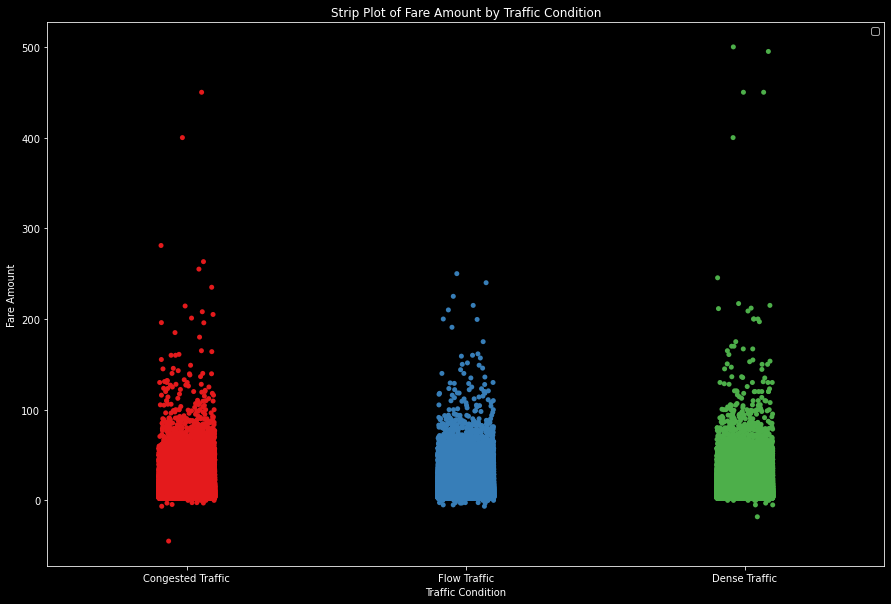

Maximum fare amount: 500.0 in traffic condition: Dense Traffic
Minimum fare amount: -44.9 in traffic condition: Congested Traffic


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Strip Plot for Traffic Condition
plt.figure(figsize=(15, 10))
sns.stripplot(
    x='Traffic Condition',
    y='fare_amount',
    data=df_cleaned,
    jitter=True,
    palette='Set1'
)
plt.title('Strip Plot of Fare Amount by Traffic Condition')
plt.xlabel('Traffic Condition')
plt.ylabel('Fare Amount')
plt.grid(False)

# Identify the row with the maximum fare amount
max_fare_index = df_cleaned['fare_amount'].idxmax()
max_fare_row = df_cleaned.iloc[max_fare_index]
max_fare = max_fare_row['fare_amount']
max_fare_traffic_condition = max_fare_row['Traffic Condition']


# Identify the row with the minimum fare amount
min_fare_index = df_cleaned['fare_amount'].idxmin()
min_fare_row = df_cleaned.iloc[min_fare_index]
min_fare = min_fare_row['fare_amount']
min_fare_traffic_condition = min_fare_row['Traffic Condition']

#
# Add legend
plt.legend()

# Show the plot
plt.show()

# Print the maximum and minimum fare amounts with their traffic conditions
print(f"Maximum fare amount: {max_fare} in traffic condition: {max_fare_traffic_condition}")
print(f"Minimum fare amount: {min_fare} in traffic condition: {min_fare_traffic_condition}")

# Ad


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


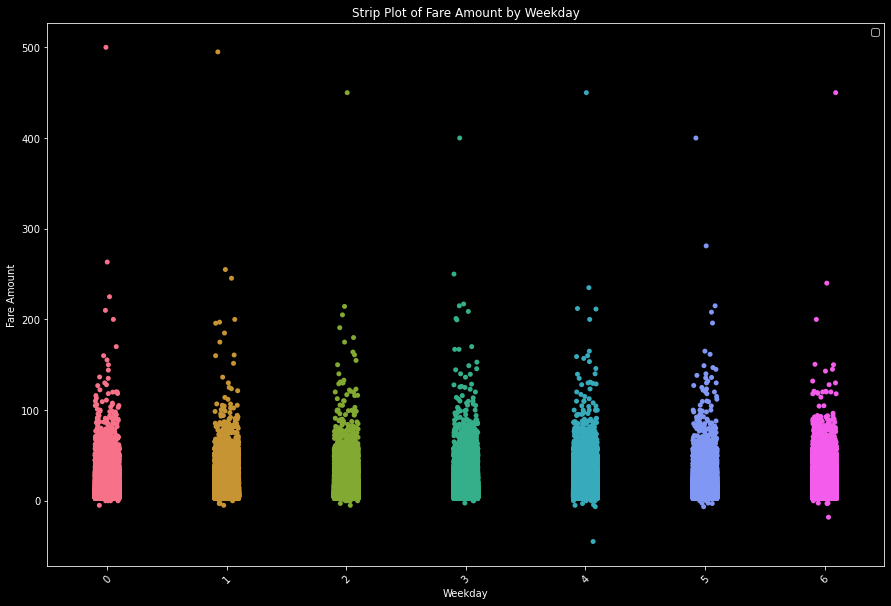

Maximum fare amount: 500.0 on weekday: 0
Minimum fare amount: -44.9 on weekday: 4


In [ ]:
plt.figure(figsize=(15, 10))
sns.stripplot(
    x='weekday',
    y='fare_amount',
    data=df_cleaned,
    jitter=True,
    palette='husl'
)

# Identify the row with the maximum fare amount
max_fare_index = df_cleaned['fare_amount'].idxmax()
max_fare_row = df_cleaned.iloc[max_fare_index]
max_fare = max_fare_row['fare_amount']
max_fare_weekday = max_fare_row['weekday']


# Identify the row with the minimum fare amount
min_fare_index = df_cleaned['fare_amount'].idxmin()
min_fare_row = df_cleaned.iloc[min_fare_index]
min_fare = min_fare_row['fare_amount']
min_fare_weekday = min_fare_row['weekday']


# Add titles and labels
plt.title('Strip Plot of Fare Amount by Weekday')
plt.xlabel('Weekday')
plt.ylabel('Fare Amount')
plt.xticks(rotation=45)

# Add legend
plt.legend()

# Show the plot
plt.grid(False)
plt.show()

# Print the maximum and minimum fare amounts with their weekdays
print(f"Maximum fare amount: {max_fare} on weekday: {max_fare_weekday}")
print(f"Minimum fare amount: {min_fare} on weekday: {min_fare_weekday}")


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


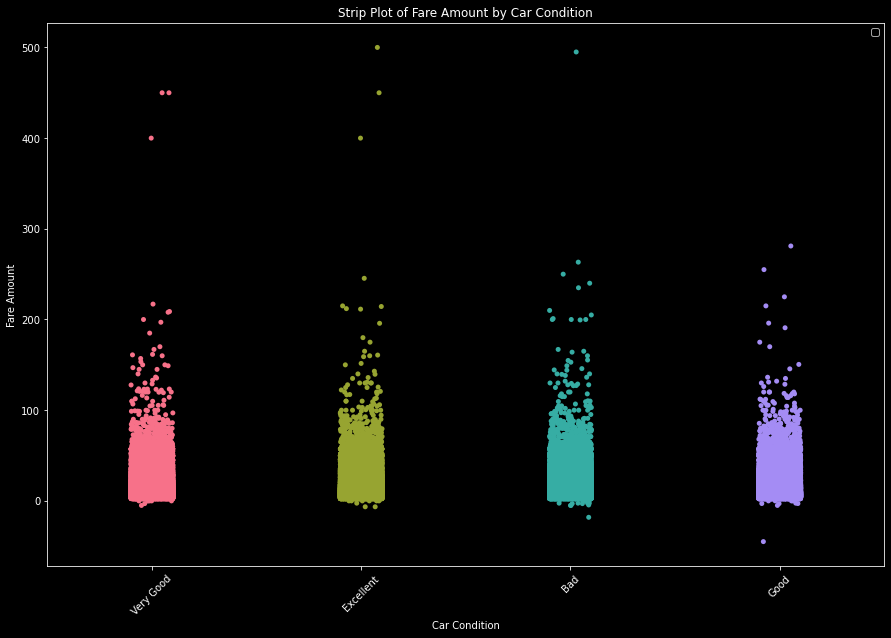

Maximum fare amount: 500.0 with car condition: Excellent
Minimum fare amount: -44.9 with car condition: Good


In [ ]:

plt.figure(figsize=(15, 10))
sns.stripplot(
    x='Car Condition',
    y='fare_amount',
    data=df_cleaned,
    jitter=True,
    palette='husl'
)

# Identify the row with the maximum fare amount
max_fare_index = df_cleaned['fare_amount'].idxmax()
max_fare_row = df_cleaned.iloc[max_fare_index]
max_fare = max_fare_row['fare_amount']
max_fare_car_condition = max_fare_row['Car Condition']

# Identify the row with the minimum fare amount
min_fare_index = df_cleaned['fare_amount'].idxmin()
min_fare_row = df_cleaned.iloc[min_fare_index]
min_fare = min_fare_row['fare_amount']
min_fare_car_condition = min_fare_row['Car Condition']


# Add titles and labels
plt.title('Strip Plot of Fare Amount by Car Condition')
plt.xlabel('Car Condition')
plt.ylabel('Fare Amount')
plt.xticks(rotation=45)

# Add legend
plt.legend()

# Show the plot
plt.grid(False)
plt.show()

# Print the maximum and minimum fare amounts with their car conditions
print(f"Maximum fare amount: {max_fare} with car condition: {max_fare_car_condition}")
print(f"Minimum fare amount: {min_fare} with car condition: {min_fare_car_condition}")


In [ ]:
print(min_fare_row)

pickup_datetime              2010-02-19 23:47:10
User ID                                 qQslVvYu
User Name                          Tiffany Lloyd
Driver Name                      Kristin Roberts
Car Condition                               Good
Weather                                    rainy
Traffic Condition              Congested Traffic
key                  2010-02-19 23:47:10.0000002
fare_amount                                -44.9
pickup_longitude                       -1.289294
pickup_latitude                         0.711639
dropoff_longitude                      -1.285898
dropoff_latitude                        0.711866
passenger_count                                1
hour                                          23
day                                           19
month                                          2
weekday                                        4
year                                        2010
jfk_dist                               35.323185
ewr_dist            

In [ ]:
print(max_fare_row)

User ID                                 fQUfaZnP
User Name                     Hector Christensen
Driver Name                        Deborah Lopez
Car Condition                          Excellent
Weather                                   cloudy
Traffic Condition                  Dense Traffic
key                  2011-09-12 09:33:56.0000004
fare_amount                                500.0
pickup_datetime              2011-09-12 09:33:56
pickup_longitude                        -1.29095
pickup_latitude                         0.709312
dropoff_longitude                       -1.29095
dropoff_latitude                        0.709312
passenger_count                                1
hour                                           9
day                                           12
month                                          9
weekday                                        0
year                                        2011
jfk_dist                               31.569506
ewr_dist            

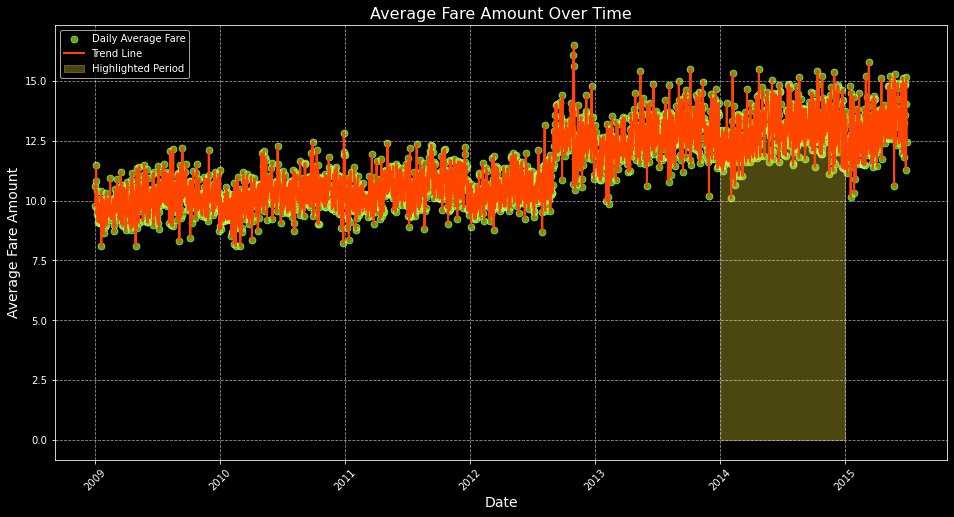

Columns in DataFrame: Index(['pickup_datetime', 'User ID', 'User Name', 'Driver Name',
       'Car Condition', 'Weather', 'Traffic Condition', 'key', 'fare_amount',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'passenger_count', 'hour', 'day', 'month',
       'weekday', 'year', 'jfk_dist', 'ewr_dist', 'lga_dist', 'sol_dist',
       'nyc_dist', 'distance', 'bearing'],
      dtype='object')


In [ ]:
df_cleaned['pickup_datetime'] = pd.to_datetime(df_cleaned['pickup_datetime'])

# Set 'pickup_datetime' as index for resampling
df_cleaned.set_index('pickup_datetime', inplace=True)

# Resample by day and calculate the mean fare amount
daily_fare = df_cleaned['fare_amount'].resample('D').mean()

# Plotting
plt.figure(figsize=(16, 8))

# Scatter plot for daily fare
sns.scatterplot(x=daily_fare.index, y=daily_fare.values, color='#7cfc00', s=50, alpha=0.7, label='Daily Average Fare')

# Optional: Add a line plot to show trends over time
sns.lineplot(x=daily_fare.index, y=daily_fare.values, color='#ff4500', linewidth=2, label='Trend Line')

# Highlight a specific period (e.g., a month or a year)
start_date = '2014-01-01'
end_date = '2014-12-31'
highlighted_period = daily_fare[start_date:end_date]
plt.fill_between(highlighted_period.index, highlighted_period.values, color='#ffeb3b', alpha=0.3, label='Highlighted Period')

# Titles and labels
plt.title('Average Fare Amount Over Time', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Average Fare Amount', fontsize=14)
plt.xticks(rotation=45)
plt.grid(True, linestyle='--', alpha=0.6)

# Add legend
plt.legend()

# Show the plot
plt.show()

# Reset index to bring 'pickup_datetime' back as a column
df_cleaned.reset_index(inplace=True)

# Verify if 'pickup_datetime' is back
print("Columns in DataFrame:", df_cleaned.columns)

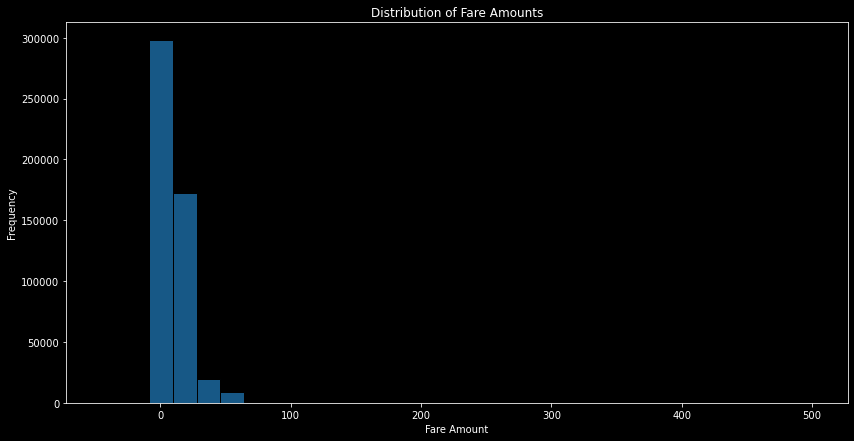

In [ ]:
plt.figure(figsize=(14, 7))
sns.histplot(
    df_cleaned['fare_amount'],
    bins=30,  # Adjust number of bins if needed
    kde=False,  # Set to True if you want to include a KDE plot
    color='#1f77b4',
    edgecolor='black'
)

# Add titles and labels
plt.title('Distribution of Fare Amounts')
plt.xlabel('Fare Amount')
plt.ylabel('Frequency')

# Show the plot
plt.grid(False)
plt.show()

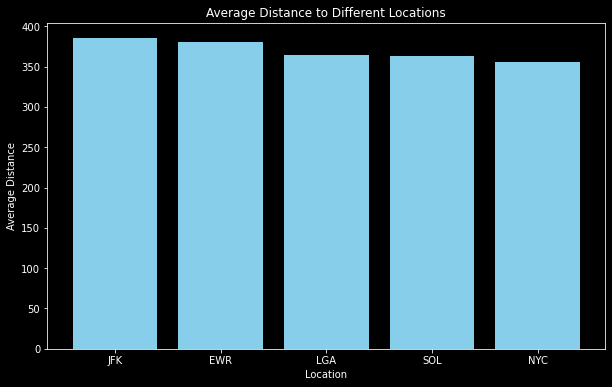

In [ ]:
locations = ['JFK', 'EWR', 'LGA', 'SOL', 'NYC']
distances = [df_cleaned['jfk_dist'].mean(), df_cleaned['ewr_dist'].mean(), df_cleaned['lga_dist'].mean(), df_cleaned['sol_dist'].mean(), df_cleaned['nyc_dist'].mean()]

plt.figure(figsize=(10, 6))
plt.bar(locations, distances, color='skyblue')
plt.xlabel('Location')
plt.ylabel('Average Distance')
plt.title('Average Distance to Different Locations')
plt.show()

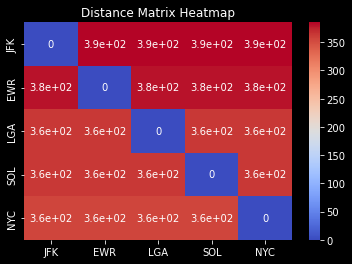

In [ ]:
locations = ['JFK', 'EWR', 'LGA', 'SOL', 'NYC']
distances_matrix = np.zeros((len(locations), len(locations)))

for i, loc1 in enumerate(locations):
    for j, loc2 in enumerate(locations):
        if i == j:
            distances_matrix[i, j] = 0
        else:
            # Calculate the distance between loc1 and loc2
            dist_col = f'{loc1.lower()}_dist'
            distances_matrix[i, j] = df_cleaned[dist_col].mean()  # Example calculation

# Plot heatmap
sns.heatmap(distances_matrix, annot=True, xticklabels=locations, yticklabels=locations, cmap='coolwarm')
plt.title('Distance Matrix Heatmap')
plt.show()

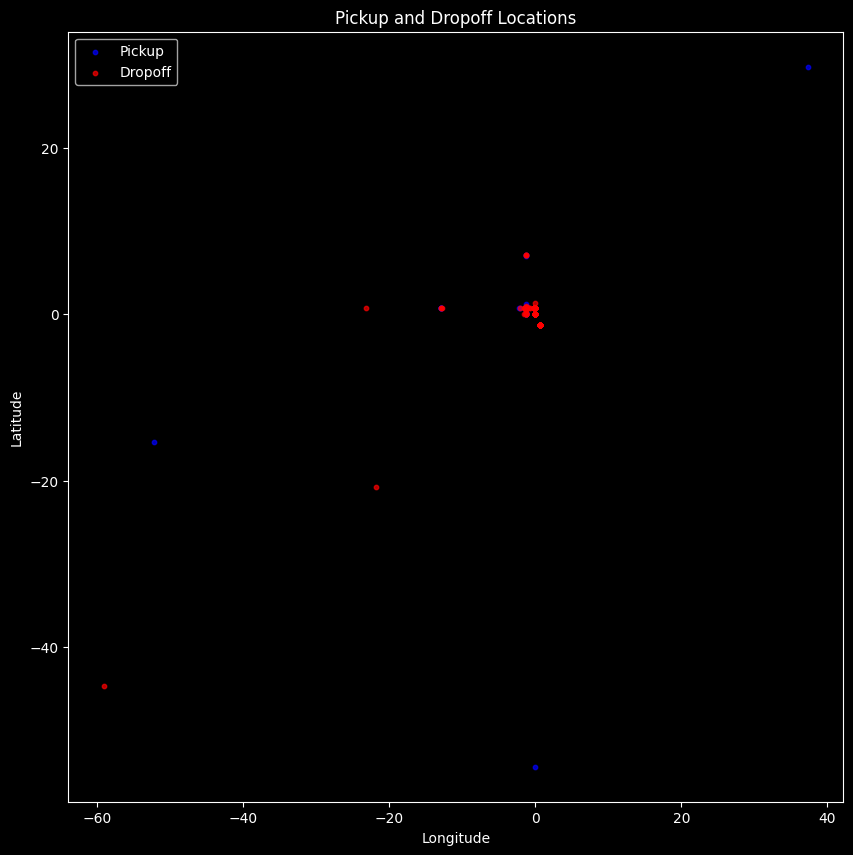

In [ ]:
plt.figure(figsize=(10, 10))
plt.scatter(df_cleaned['pickup_longitude'], df_cleaned['pickup_latitude'], alpha=0.7, s=10, c='blue', label='Pickup')
plt.scatter(df_cleaned['dropoff_longitude'], df_cleaned['dropoff_latitude'], alpha=0.7, s=10, c='red', label='Dropoff')
plt.title('Pickup and Dropoff Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.show()

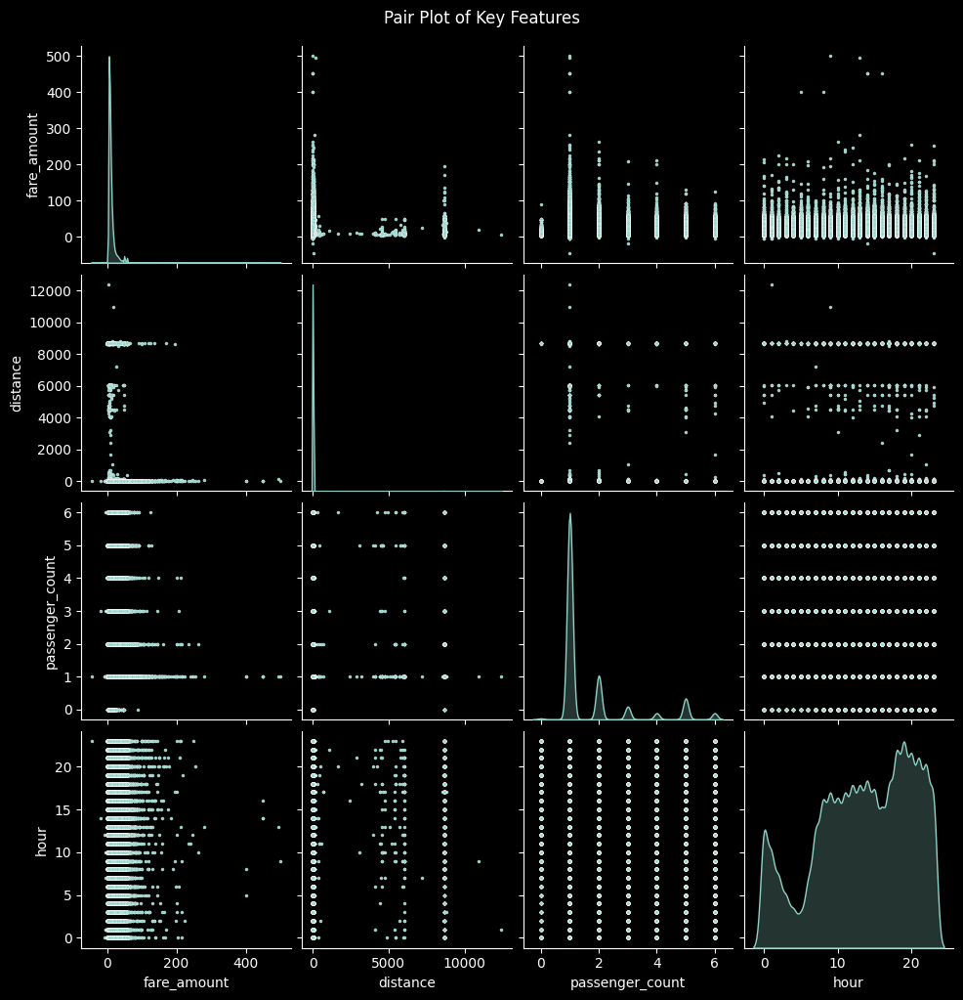

In [ ]:
features = ['fare_amount', 'distance', 'passenger_count', 'hour']

# Plot pairplot
sns.pairplot(df_cleaned[features], diag_kind='kde', plot_kws={"s": 5})
plt.suptitle('Pair Plot of Key Features', y=1.02)
plt.show()

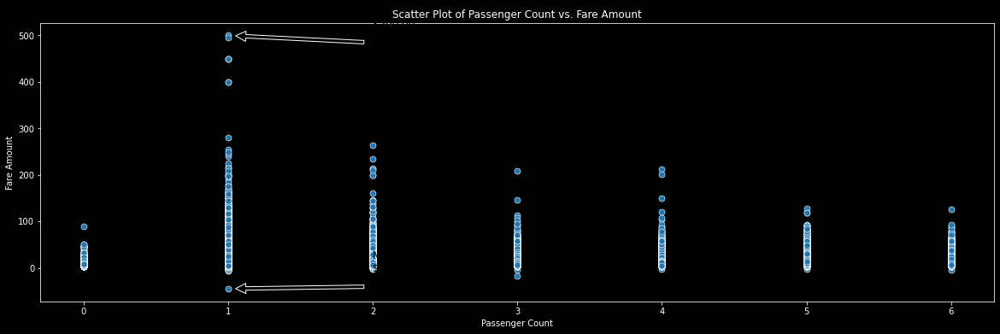

In [ ]:
plt.figure(figsize=(20, 6))

# Plot the scatter plot
sns.scatterplot(
    x='passenger_count',
    y='fare_amount',
    data=df_cleaned,
    color='#1f77b4',  # Color of the points
    s=50  # Size of the scatter plot points
)

# Calculate max and min fare amounts
max_fare = df_cleaned['fare_amount'].max()
min_fare = df_cleaned['fare_amount'].min()

# Get the passenger counts corresponding to max and min fares
max_row = df_cleaned[df_cleaned['fare_amount'] == max_fare]
min_row = df_cleaned[df_cleaned['fare_amount'] == min_fare]

# Check if there's more than one row with the same max/min fare
max_passenger_count = max_row['passenger_count'].values[0]
min_passenger_count = min_row['passenger_count'].values[0]

# Annotate max and min fare amounts on the plot
plt.annotate(
    f'Max Fare\n${max_fare:.2f}\nPassenger Count: {max_passenger_count}',
    xy=(max_row['passenger_count'].values[0], max_fare),
    xytext=(max_row['passenger_count'].values[0] + 1, max_fare - 10),
    fontsize=12, color='black',
    arrowprops=dict(facecolor='black', shrink=0.05)
)

plt.annotate(
    f'Min Fare\n${min_fare:.2f}\nPassenger Count: {min_passenger_count}',
    xy=(min_row['passenger_count'].values[0], min_fare),
    xytext=(min_row['passenger_count'].values[0] + 1, min_fare + 10),
    fontsize=12, color='black',
    arrowprops=dict(facecolor='black', shrink=0.05)
)

# Add titles and labels
plt.title('Scatter Plot of Passenger Count vs. Fare Amount')
plt.xlabel('Passenger Count')
plt.ylabel('Fare Amount')
plt.grid(False)  # Add grid for better readability

# Show the plot
plt.show()


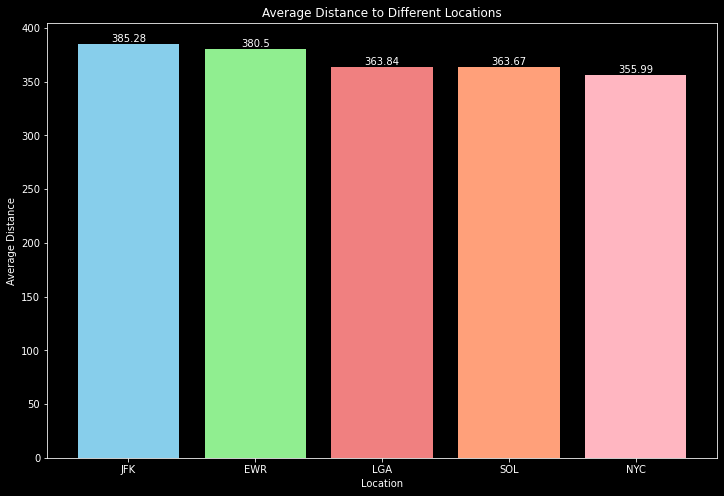

In [ ]:
locations = ['JFK', 'EWR', 'LGA', 'SOL', 'NYC']
distances = [df_cleaned['jfk_dist'].mean(), df_cleaned['ewr_dist'].mean(), df_cleaned['lga_dist'].mean(), df_cleaned['sol_dist'].mean(), df_cleaned['nyc_dist'].mean()]

# Define a color palette for the bars
colors = ['skyblue', 'lightgreen', 'lightcoral', 'lightsalmon', 'lightpink']

plt.figure(figsize=(12, 8))  # Increase the figure size
bars = plt.bar(locations, distances, color=colors)

plt.xlabel('Location')
plt.ylabel('Average Distance')
plt.title('Average Distance to Different Locations')

# Optionally, add value labels on top of the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.2, round(yval, 2), ha='center', va='bottom')

plt.show()

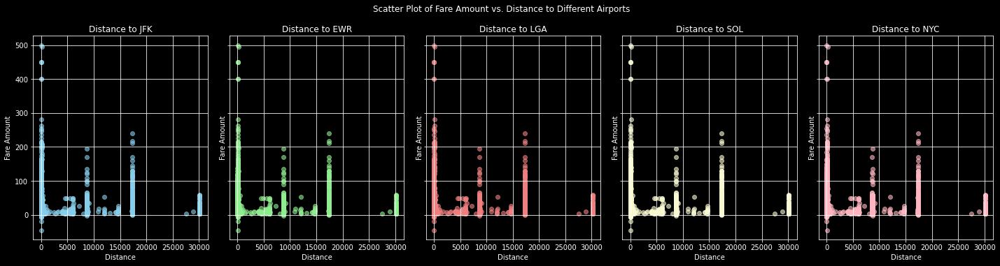

In [ ]:
distance_columns = ['jfk_dist', 'ewr_dist', 'lga_dist', 'sol_dist', 'nyc_dist']
labels = ['JFK', 'EWR', 'LGA', 'SOL', 'NYC']
colors = ['skyblue', 'lightgreen', 'lightcoral', 'lightgoldenrodyellow', 'lightpink']  # Define different colors

# Set up the figure and axes for subplots
fig, axes = plt.subplots(nrows=1, ncols=len(distance_columns), figsize=(20, 5), sharey=True)

# Plot scatter plots for each distance type
for ax, col, label, color in zip(axes, distance_columns, labels, colors):
    ax.scatter(df_cleaned[col], df_cleaned['fare_amount'], color=color, alpha=0.6)
    ax.set_title(f'Distance to {label}')
    ax.set_xlabel('Distance')
    ax.set_ylabel('Fare Amount')
    ax.grid(True)

# Adjust layout
plt.tight_layout()
plt.suptitle('Scatter Plot of Fare Amount vs. Distance to Different Airports', y=1.05)
plt.show()

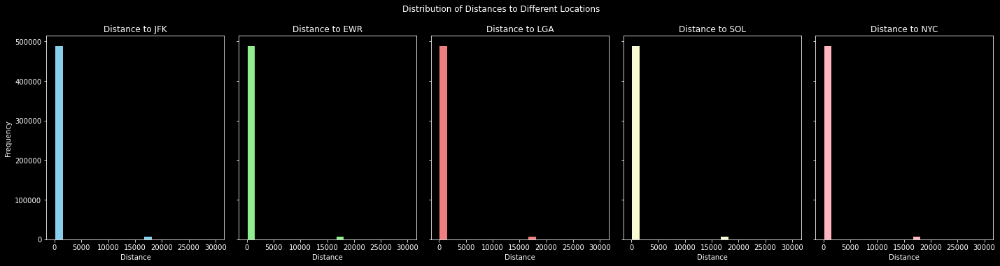

In [ ]:
# Define the column names for each type of distance
distance_columns = ['jfk_dist', 'ewr_dist', 'lga_dist', 'sol_dist', 'nyc_dist']
labels = ['JFK', 'EWR', 'LGA', 'SOL', 'NYC']
colors = ['skyblue', 'lightgreen', 'lightcoral', 'lightgoldenrodyellow', 'lightpink']  # Define different colors

# Set up the figure and axes for subplots
fig, axes = plt.subplots(nrows=1, ncols=len(distance_columns), figsize=(20, 5), sharey=True)

# Plot histograms for each distance type
for ax, col, label, color in zip(axes, distance_columns, labels, colors):
    ax.hist(df_cleaned[col].dropna(), bins=20, color=color, edgecolor='black')
    ax.set_title(f'Distance to {label}')
    ax.set_xlabel('Distance')
    if ax.is_first_col():
        ax.set_ylabel('Frequency')

# Adjust layout
plt.tight_layout()
plt.suptitle('Distribution of Distances to Different Locations', y=1.05)
plt.show()

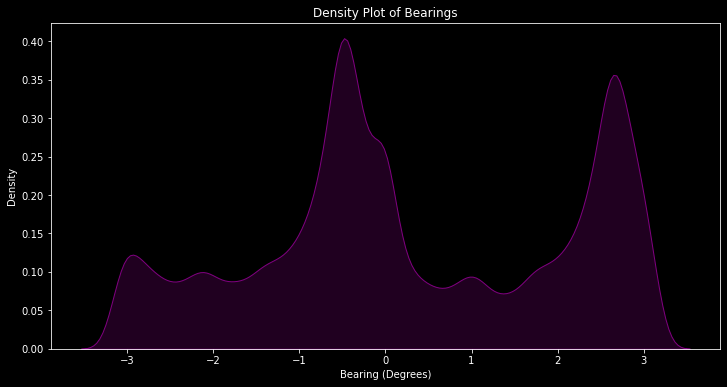

In [ ]:
plt.figure(figsize=(12, 6))

# Plot density plot
sns.kdeplot(df_cleaned['bearing'], color='purple', fill=True)

# Add titles and labels
plt.title('Density Plot of Bearings')
plt.xlabel('Bearing (Degrees)')
plt.ylabel('Density')

# Show the plot
plt.show()

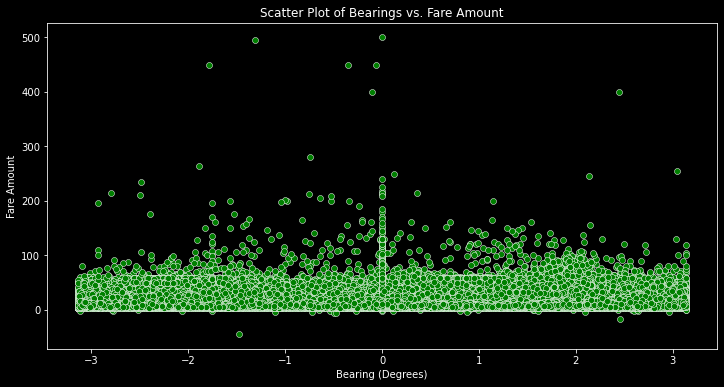

In [ ]:
# Define the figure size
plt.figure(figsize=(12, 6))

# Plot scatter plot
sns.scatterplot(x='bearing', y='fare_amount', data=df_cleaned, color='green')

# Add titles and labels
plt.title('Scatter Plot of Bearings vs. Fare Amount')
plt.xlabel('Bearing (Degrees)')
plt.ylabel('Fare Amount')

# Show the plot
plt.show()

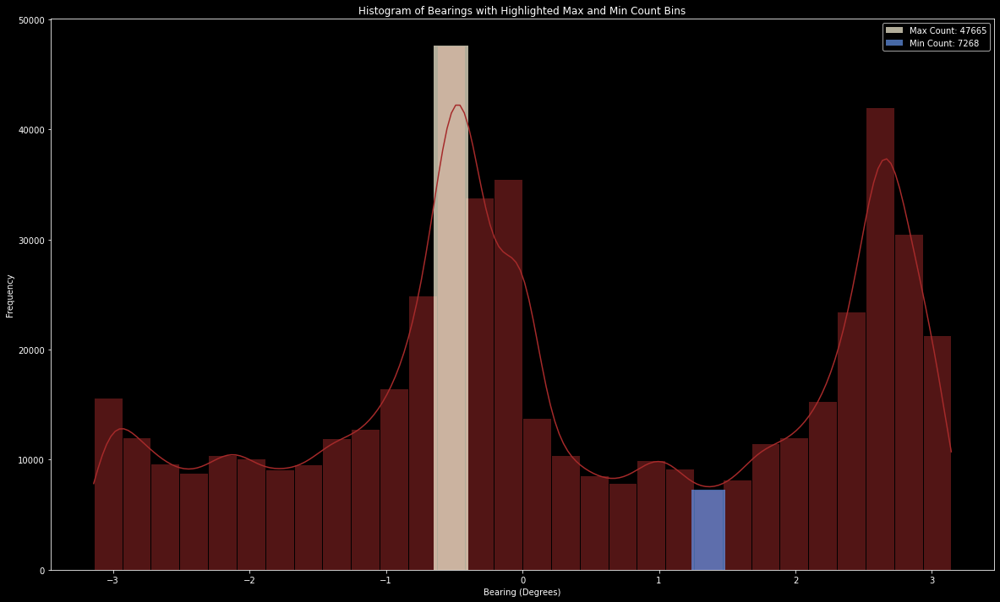

In [ ]:
# Define the figure size



# Define the figure size
plt.figure(figsize=(20, 12))

# Plot histogram with KDE
hist_data = sns.histplot(df_cleaned['bearing'], bins=30, color='#a52a2a', kde=True, edgecolor='black')

# Get the counts and bin edges from the histogram
counts, bin_edges = np.histogram(df_cleaned['bearing'], bins=30)

# Find the bin with maximum and minimum counts
max_count_index = np.argmax(counts)
min_count_index = np.argmin(counts)

# Calculate the center of the max and min bins
max_bin_center = (bin_edges[max_count_index] + bin_edges[max_count_index + 1]) / 2
min_bin_center = (bin_edges[min_count_index] + bin_edges[min_count_index + 1]) / 2

# Highlight the max and min count bins with bars
plt.bar(max_bin_center, counts[max_count_index], width=0.25, color='#fff8dc', alpha=0.7, label=f'Max Count: {counts[max_count_index]}')
plt.bar(min_bin_center, counts[min_count_index], width=0.25, color='#6495ed', alpha=0.7, label=f'Min Count: {counts[min_count_index]}')

# Add titles and labels
plt.title('Histogram of Bearings with Highlighted Max and Min Count Bins')
plt.xlabel('Bearing (Degrees)')
plt.ylabel('Frequency')

# Add legend
plt.legend()

# Show the plot
plt.show()


In [ ]:
print(max_count_index)

12


In [ ]:
bearings = df_cleaned['bearing'].values

# Convert bearings to radians
bearings_rad = np.deg2rad(bearings)

# Compute frequencies (you might need to aggregate if there are duplicate bearings)
# For simplicity, we'll count occurrences of each bearing
unique_bearings, counts = np.unique(bearings_rad, return_counts=True)

# Create a circular plot for bearings
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={'projection': 'polar'})

# Plot points (scatter) for each unique bearing
ax.scatter(unique_bearings, counts, s=100, color='blue', alpha=0.6)

# Set radial ticks and labels
ax.set_yticklabels([])
ax.set_xticks(unique_bearings)
ax.set_xticklabels([f'{int(np.rad2deg(b))}°' for b in unique_bearings])

plt.title('Bearing Distribution')
plt.show()

# **Feature Selection**

## Pearson's correlation

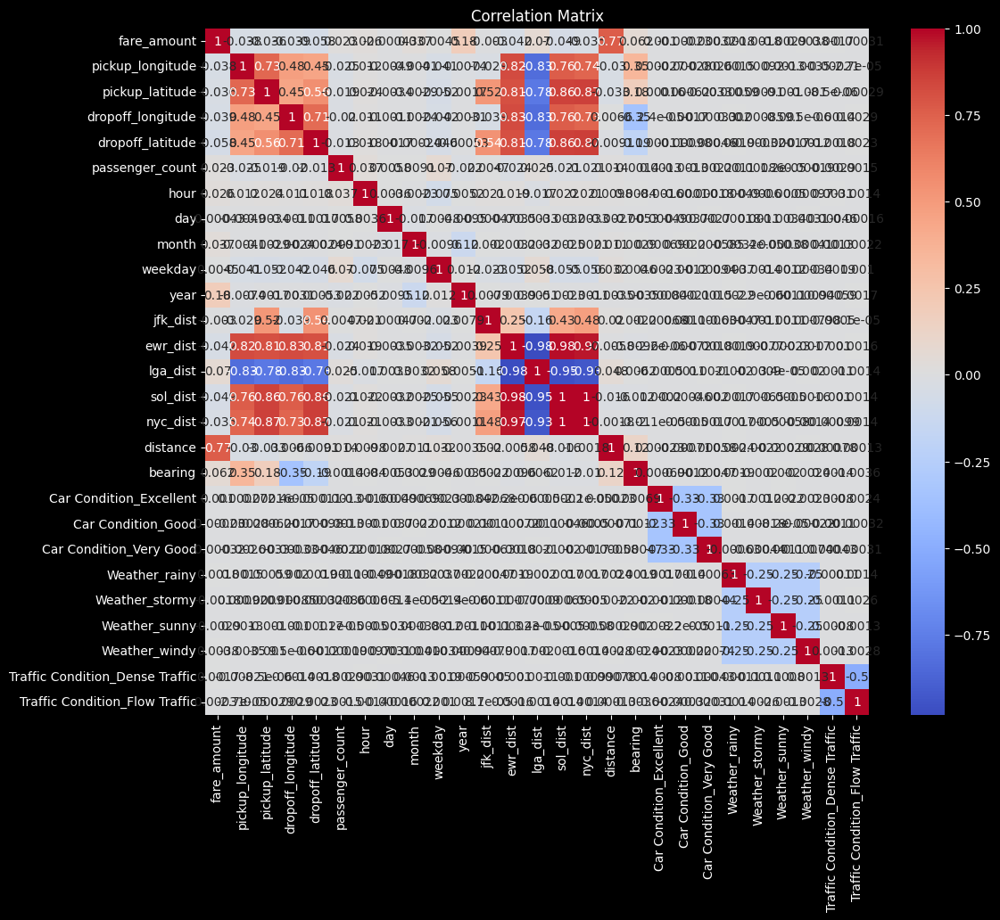

Top 10 features based on Pearson's correlation: ['distance', 'year', 'lga_dist', 'bearing', 'dropoff_latitude', 'sol_dist', 'ewr_dist', 'dropoff_longitude', 'pickup_longitude', 'month', 'pickup_latitude', 'nyc_dist', 'hour', 'passenger_count', 'weekday']
Normal Data:
   distance  year   lga_dist   bearing  dropoff_latitude   sol_dist  \
2  1.389525  2011  19.865289  2.599961          0.711231  17.722624   
3  2.799270  2012  21.063132  0.133905          0.711363  15.738963   
4  1.999157  2010  15.219339 -0.502703          0.711811  23.732406   
5  3.787239  2011  20.648176 -0.674251          0.711365  15.741133   
6  1.555807  2012  18.113693 -0.342260          0.711481  19.126670   

    ewr_dist  dropoff_longitude  pickup_longitude  month  pickup_latitude  \
2  33.712082          -1.291391         -1.291242      8         0.711418   
3  32.556289          -1.291396         -1.291319      4         0.710927   
4  39.406828          -1.290787         -1.290987      3         0.711536 

In [17]:

from sklearn.preprocessing import StandardScaler, MinMaxScaler

df_cleaned_labeled_modified = df_cleaned_labeled.drop(['User ID', 'key', 'pickup_datetime','User Name', 'Driver Name'], axis=1)

corr_matrix = df_cleaned_labeled_modified.corr()

plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

target_corr = corr_matrix['fare_amount'].drop(['fare_amount'])

sorted_features = target_corr.abs().sort_values(ascending=False)

top_pearson_features = sorted_features.head(15).index

print("Top 10 features based on Pearson's correlation:", top_pearson_features.tolist())

X = df_cleaned_labeled_modified[top_pearson_features]

scaler = StandardScaler()
X_standard = scaler.fit_transform(X)
X_standard_df = pd.DataFrame(X_standard, columns=top_pearson_features)

min_max_scaler = MinMaxScaler()
X_min_max = min_max_scaler.fit_transform(X) #only for images
X_min_max_df = pd.DataFrame(X_min_max, columns=top_pearson_features)

print("Normal Data:")
print(X.head())

print("Standard Scaled Data:")
print(X_standard_df.head())

print("Min-Max Scaled Data:")
print(X_min_max_df.head())


## Spearman Feature Selection

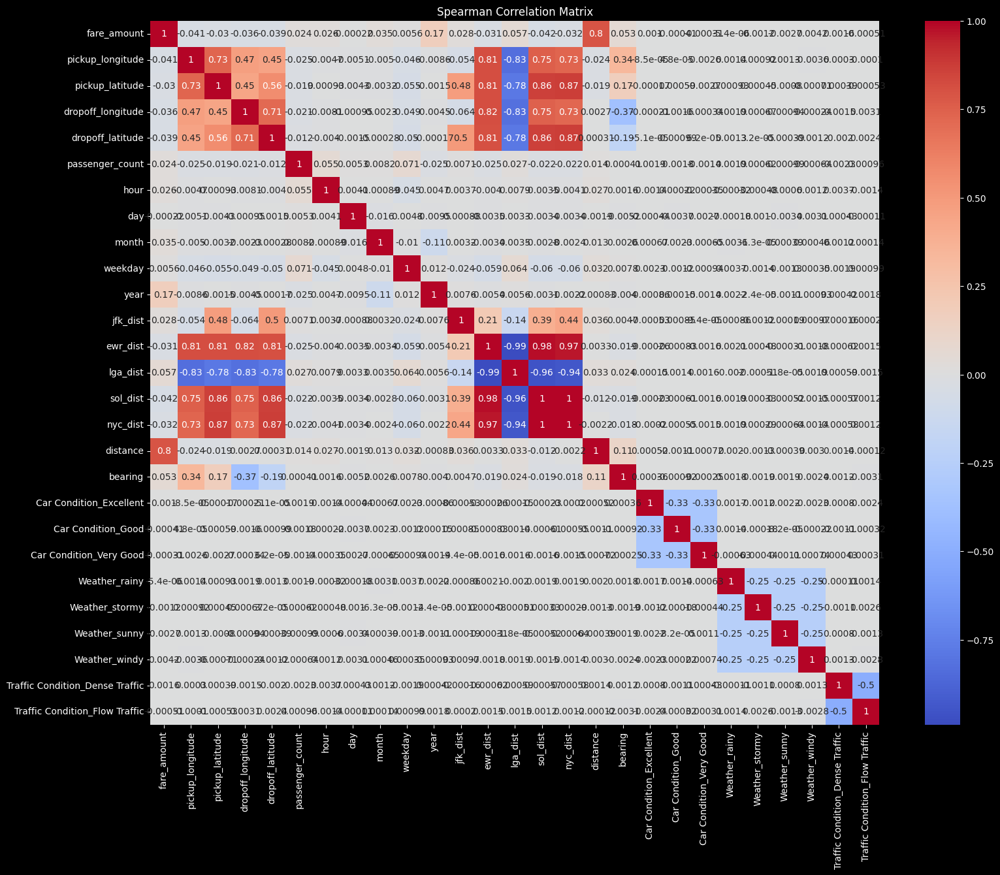

Top 10 features based on Spearman's correlation: ['distance', 'year', 'lga_dist', 'bearing', 'sol_dist', 'pickup_longitude', 'dropoff_latitude', 'dropoff_longitude', 'month', 'nyc_dist', 'ewr_dist', 'pickup_latitude', 'jfk_dist', 'hour', 'passenger_count']
Normal Data:
   distance  year   lga_dist   bearing   sol_dist  pickup_longitude  \
2  1.389525  2011  19.865289  2.599961  17.722624         -1.291242   
3  2.799270  2012  21.063132  0.133905  15.738963         -1.291319   
4  1.999157  2010  15.219339 -0.502703  23.732406         -1.290987   
5  3.787239  2011  20.648176 -0.674251  15.741133         -1.291560   
6  1.555807  2012  18.113693 -0.342260  19.126670         -1.291195   

   dropoff_latitude  dropoff_longitude  month   nyc_dist   ewr_dist  \
2          0.711231          -1.291391      8   9.847344  33.712082   
3          0.711363          -1.291396      4   7.703421  32.556289   
4          0.711811          -1.290787      3  15.600745  39.406828   
5          0.711365

In [18]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

df_cleaned_labeled_modified = df_cleaned_labeled.drop(['User ID', 'key', 'pickup_datetime','User Name', 'Driver Name'], axis=1)

spearman_corr = df_cleaned_labeled_modified.corr(method='spearman')

plt.figure(figsize=(18, 14))
sns.heatmap(spearman_corr, annot=True, cmap='coolwarm')
plt.title('Spearman Correlation Matrix')
plt.show()

target_spearman_corr = spearman_corr['fare_amount'].drop(['fare_amount'])

sorted_spearman_features = target_spearman_corr.abs().sort_values(ascending=False)

top_spearman_features = sorted_spearman_features.head(15).index

print("Top 10 features based on Spearman's correlation:", top_spearman_features.tolist())

X_spearman = df_cleaned_labeled_modified[top_spearman_features]

scaler = StandardScaler()
X_standard_spearman = scaler.fit_transform(X_spearman)
X_standard_spearman_df = pd.DataFrame(X_standard_spearman, columns=top_spearman_features)

min_max_scaler = MinMaxScaler()
X_min_max_spearman = min_max_scaler.fit_transform(X_spearman)
X_min_max_spearman_df = pd.DataFrame(X_min_max_spearman, columns=top_spearman_features)

print("Normal Data:")
print(X_spearman.head())

print("Standard Scaled Data:")
print(X_standard_spearman_df.head())

print("Min-Max Scaled Data:")
print(X_min_max_spearman_df.head())


## Kendall Tau

In [19]:
from scipy.stats import kendalltau
from sklearn.preprocessing import StandardScaler, MinMaxScaler

df_cleaned_labeled_modified = df_cleaned_labeled.drop(['User ID', 'key', 'pickup_datetime','User Name', 'Driver Name'], axis=1)

target_variable = 'fare_amount'
correlations = []

for column in df_cleaned_labeled_modified.columns:
    if column != target_variable:
        tau, p_value = kendalltau(df_cleaned_labeled_modified[column], df_cleaned_labeled_modified[target_variable])
        correlations.append((column, tau))

correlation_df = pd.DataFrame(correlations, columns=['Feature', 'Kendall_Tau'])

sorted_correlation_df = correlation_df.reindex(correlation_df['Kendall_Tau'].abs().sort_values(ascending=False).index)

top_kendall_features = sorted_correlation_df.head(15)['Feature']

print("Top 10 features based on Kendall's Tau correlation:", top_kendall_features.tolist())

X_kendall = df_cleaned_labeled_modified[top_kendall_features]

scaler = StandardScaler()
X_standard_kendall = scaler.fit_transform(X_kendall)
X_standard_kendall_df = pd.DataFrame(X_standard_kendall, columns=top_kendall_features)

min_max_scaler = MinMaxScaler()
X_min_max_kendall = min_max_scaler.fit_transform(X_kendall)
X_min_max_kendall_df = pd.DataFrame(X_min_max_kendall, columns=top_kendall_features)

print("Standard Scaled Data:")
print(X_standard_kendall_df.head())

print("Min-Max Scaled Data:")
print(X_min_max_kendall_df.head())

print(correlation_df.sort_values(by='Kendall_Tau', ascending=False))


Top 10 features based on Kendall's Tau correlation: ['distance', 'year', 'lga_dist', 'bearing', 'sol_dist', 'pickup_longitude', 'dropoff_latitude', 'dropoff_longitude', 'month', 'nyc_dist', 'ewr_dist', 'pickup_latitude', 'passenger_count', 'jfk_dist', 'hour']
Standard Scaled Data:
Feature  distance      year  lga_dist   bearing  sol_dist  pickup_longitude  \
0       -0.583315 -0.383221  0.096794  1.227625 -0.010074         -0.039883   
1        0.510683  0.153611  0.486096 -0.132423 -0.476884         -0.320628   
2       -0.110226 -0.920052 -1.413150 -0.483517  1.404192          0.896126   
3        1.277372 -0.383221  0.351234 -0.578127 -0.476374         -1.204924   
4       -0.454277  0.153611 -0.472478 -0.395032  0.320336          0.135007   

Feature  dropoff_latitude  dropoff_longitude     month  nyc_dist  ewr_dist  \
0               -0.121770          -0.596321  0.507710  0.010665 -0.199211   
1                0.248207          -0.616638 -0.653165 -0.507412 -0.540333   
2        

## High Correlated Features

In [20]:
import joblib

top_features_union = set(top_pearson_features) | set(top_spearman_features) | set(top_kendall_features)


top_features_union_list = list(top_features_union)


X = df_cleaned_labeled_modified[list(top_features_union)]

scaler = StandardScaler()
X_standard = scaler.fit_transform(X)

min_max_scaler = MinMaxScaler()
X_min_max = min_max_scaler.fit_transform(X)

X_standard_df = pd.DataFrame(X_standard, columns=top_features_union_list)
X_min_max_df = pd.DataFrame(X_min_max, columns=top_features_union_list)
print("Normal Data:")
print(X.head())


print("Standard Scaled Data:")
print(X_standard_df.head())

print("Min-Max Scaled Data:")
print(X_min_max_df.head()) 

# Save the fitted scaler to a file
scaler_filename = "standard_scaler2.joblib"
joblib.dump(scaler, scaler_filename)

Normal Data:
   passenger_count  weekday  pickup_longitude   lga_dist  dropoff_longitude  \
2                2        3         -1.291242  19.865289          -1.291391   
3                1        5         -1.291319  21.063132          -1.291396   
4                1        1         -1.290987  15.219339          -1.290787   
5                1        3         -1.291560  20.648176          -1.291071   
6                1        1         -1.291195  18.113693          -1.291086   

    nyc_dist  month  dropoff_latitude  year   ewr_dist  pickup_latitude  \
2   9.847344      8          0.711231  2011  33.712082         0.711418   
3   7.703421      4          0.711363  2012  32.556289         0.710927   
4  15.600745      3          0.711811  2010  39.406828         0.711536   
5   7.649541      1          0.711365  2011  32.824930         0.710901   
6  10.993150     11          0.711481  2012  35.482608         0.711251   

    sol_dist  distance   jfk_dist   bearing  hour  
2  17.722

['standard_scaler2.joblib']

In [23]:
X.head()

,lga_dist,hour,pickup_latitude,passenger_count,dropoff_latitude,distance,year,month,weekday,bearing,pickup_longitude,nyc_dist,dropoff_longitude,jfk_dist,sol_dist,ewr_dist
0,14.342611,17,0.710721,1,0.710563,1.030764,2009,6,0,-2.918897,-1.288826,27.572573,-1.288779,20.265840,34.543548,55.176046
1,23.130775,16,0.710546,1,0.711780,8.450134,2010,1,1,-0.375217,-1.291824,8.755732,-1.291182,44.667679,15.125872,31.832358
2,19.865289,0,0.711418,2,0.711231,1.389525,2011,8,3,2.599961,-1.291242,9.847344,-1.291391,43.597686,17.722624,33.712082
3,21.063132,4,0.710927,1,0.711363,2.799270,2012,4,5,0.133905,-1.291319,7.703421,-1.291396,42.642965,15.738963,32.556289
4,15.219339,7,0.711536,1,0.711811,1.999157,2010,3,1,-0.502703,-1.290987,15.600745,-1.290787,43.329953,23.732406,39.406828


In [22]:
X_standard_df.shape

(341511, 16)

In [25]:
X_min_max_df.shape

(499995, 16)

# Model HyperTunning 

In [15]:
pip install optuna


Note: you may need to restart the kernel to use updated packages.


# **_Min Max optuna_**

**_Xgboost with randomized_**

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt

# Assuming X_min_max_df and y are already defined
def XGBoost_Regressor_RandomSearch(X, y):
    # Split the data into training and testing sets
    # Assuming y is already defined
    y = df_cleaned_labeled_modified['fare_amount']
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, shuffle=True)
    
    # Define the parameter grid for RandomizedSearchCV
    param_grid = {
        'n_estimators': np.arange(50, 501, 50),
        'max_depth': np.arange(3, 21, 1),
        'learning_rate': np.linspace(0.01, 0.3, 30),
        'subsample': np.linspace(0.5, 1.0, 10),
        'colsample_bytree': np.linspace(0.5, 1.0, 10),
        'reg_alpha': np.linspace(0, 10, 11),
        'reg_lambda': np.linspace(0, 10, 11)
    }
    
    # Create the XGBoost Regressor model
    xgb_model = XGBRegressor(random_state=44, n_jobs=-1)
    
    # Create the RandomizedSearchCV object
    random_search = RandomizedSearchCV(
        estimator=xgb_model,
        param_distributions=param_grid,
        n_iter=10,  # Start with fewer iterations for quick results
        scoring='neg_mean_squared_error',  # Use negative MSE as the scoring method
        cv=3,  # Reduce the number of folds for faster computation
        random_state=42,
        n_jobs=-1,  # Use all available cores
        verbose=2  # Verbosity level for progress monitoring
    )
    
    # Fit the model
    random_search.fit(X_train, y_train)
    
    # Get the best parameters
    best_params = random_search.best_params_
    best_score = -random_search.best_score_
    print(f"Best parameters found: {best_params}")
    print(f"Best cross-validated RMSE: {np.sqrt(best_score)}")
    
    # Train the best model with the best parameters
    best_model = XGBRegressor(**best_params, random_state=44, n_jobs=-1)
    best_model.fit(X_train, y_train)
    
    # Make predictions with the best model
    y_pred = best_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    r2 = r2_score(y_test, y_pred)
    
    print(f"Test MSE: {mse}")
    print(f"Test RMSE: {rmse}")
    print(f"Test R^2: {r2}")
    
    # Plot Actual vs Predicted
    plt.figure(figsize=(10, 7))
    plt.scatter(y_test, y_pred, alpha=0.3)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title('Actual vs Predicted')
    plt.show()

# Example usage: Assuming X_min_max_df and y are your feature matrix and target variable
XGBoost_Regressor_RandomSearch(X_min_max_df, y)


Fitting 3 folds for each of 10 candidates, totalling 30 fits

Best parameters found: {'subsample': 0.9444444444444444, 'reg_lambda': 6.0, 'reg_alpha': 10.0, 'n_estimators': 150, 'max_depth': 17, 'learning_rate': 0.06999999999999999, 'colsample_bytree': 0.6666666666666666}

Best cross-validated RMSE: 4.671924405597153

Test MSE: 17.54232801362023

Test RMSE: 4.188356242444073

Test R^2: 0.816456967531972


Cross validation trials


16 -Features

In [23]:
from sklearn.model_selection import train_test_split, cross_val_score
from xgboost import XGBRegressor

y = df_cleaned_labeled_modified['fare_amount']

X_train, X_test, y_train, y_test = train_test_split(X_min_max_df, y, test_size=0.2, random_state=42)

# Define the XGBoost regressor with the best parameters found
model = XGBRegressor(
    n_estimators=484,
    max_depth=7,
    learning_rate=0.10914634779079604,
    subsample=0.8572501626997906,
    colsample_bytree=0.8141232278856032,
    reg_alpha=8.679785352347421,
    reg_lambda=5.7330420842142775,
    random_state=42
)

# Perform cross-validation with R^2 scoring
cv_scores = cross_val_score(model, X_train, y_train, cv=15, scoring='r2')

# Print cross-validation results
print(f'Cross-Validation R^2 Scores: {cv_scores}')
print(f'Mean CV R^2: {np.mean(cv_scores)}')
print(f'Standard Deviation of CV R^2: {np.std(cv_scores)}')

# Train the model on the entire training set
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f'Test MSE: {mse}')

# Calculate the R^2
r2 = model.score(X_test, y_test)
print(f'Test R^2: {r2}')

# Plot Actual vs Predicted
plt.figure(figsize=(10, 7))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()


NameError: name 'XGBRegressor' is not defined

Test MSE: 2.6760509635488994
Test R^2: 0.7737915630279164


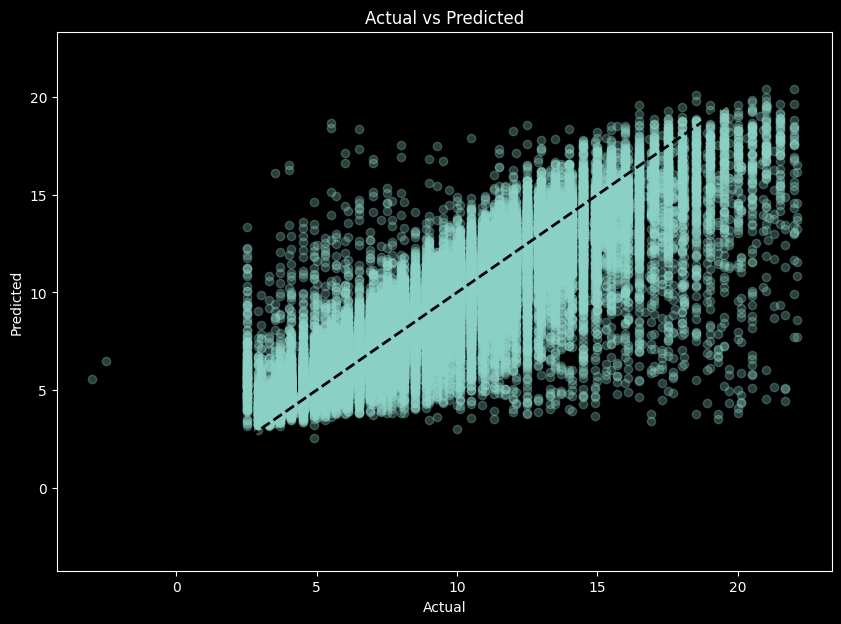

In [14]:
from sklearn.model_selection import train_test_split, cross_val_score
from xgboost import XGBRegressor
#import mean_squared_error from sklearn.metrics
from sklearn.metrics import mean_squared_error
##import R2 
from sklearn.metrics import r2_score

y = df_cleaned_labeled_modified['fare_amount']

X_train, X_test, y_train, y_test = train_test_split(X_standard_df, y, test_size=0.2, random_state=42)

# Define the XGBoost regressor with the best parameters found
model = XGBRegressor(
  subsample= 0.9444444444444444, 
  reg_lambda= 6.0, 
  reg_alpha= 10.0, 
  n_estimators= 150, 
  max_depth= 17, 
  learning_rate= 0.06999999999999999,
   colsample_bytree= 0.6666666666666666
)

# # Perform cross-validation with R^2 scoring
# cv_scores = cross_val_score(model, X_train, y_train, cv=15, scoring='r2')

# # Print cross-validation results
# print(f'Cross-Validation R^2 Scores: {cv_scores}')
# print(f'Mean CV R^2: {np.mean(cv_scores)}')
# print(f'Standard Deviation of CV R^2: {np.std(cv_scores)}')

# Train the model on the entire training set
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f'Test MSE: {mse}')

# Calculate the R^2
r2 = model.score(X_test, y_test)
print(f'Test R^2: {r2}')

# Plot Actual vs Predicted
plt.figure(figsize=(10, 7))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()


Change number of features selected 

without removing the outliers

# 18-Feature

Test MSE: 2.636807381859359
Test R^2: 0.7771088501035722


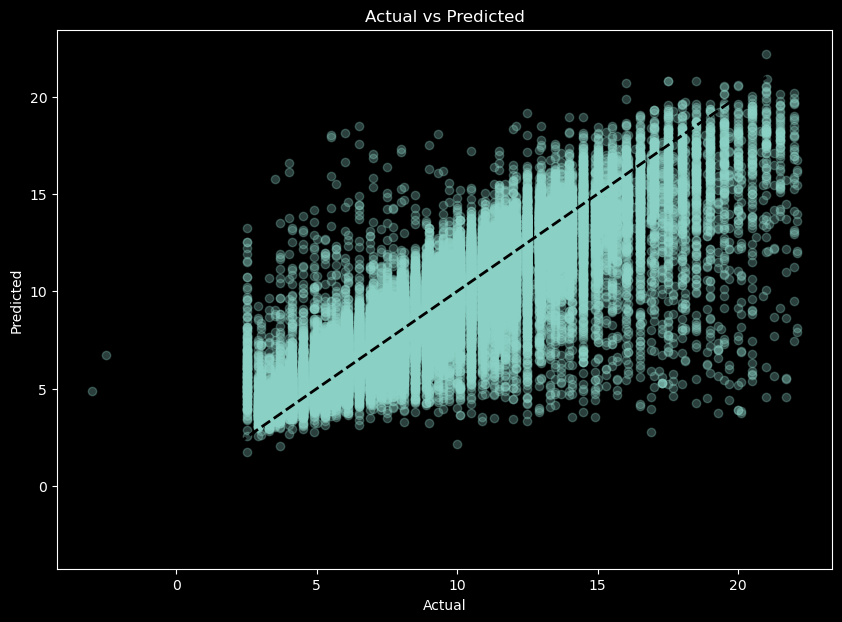

In [15]:
import xgboost as xgb
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Assuming you have your features and target variable in X and y, respectively.

y= df_cleaned_labeled_modified['fare_amount']

X_train, X_test, y_train, y_test = train_test_split(X_min_max_df, y, test_size=0.2, random_state=42)

# Define the XGBoost regressor with the best parameters found
model = XGBRegressor(
    n_estimators=484,
    max_depth=7,
    learning_rate=0.10914634779079604,
    subsample=0.8572501626997906,
    colsample_bytree=0.8141232278856032,
    reg_alpha=8.679785352347421,
    reg_lambda=5.7330420842142775,
    random_state=42
)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f'Test MSE: {mse}')

# Calculate the R2
r2 = model.score(X_test, y_test)
print(f'Test R^2: {r2}')

# Plot Actual vs Predicted
plt.figure(figsize=(10, 7))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()


# 16-Feature

Test MSE: 2.618440134833823
Test R^2: 0.7786614461855306


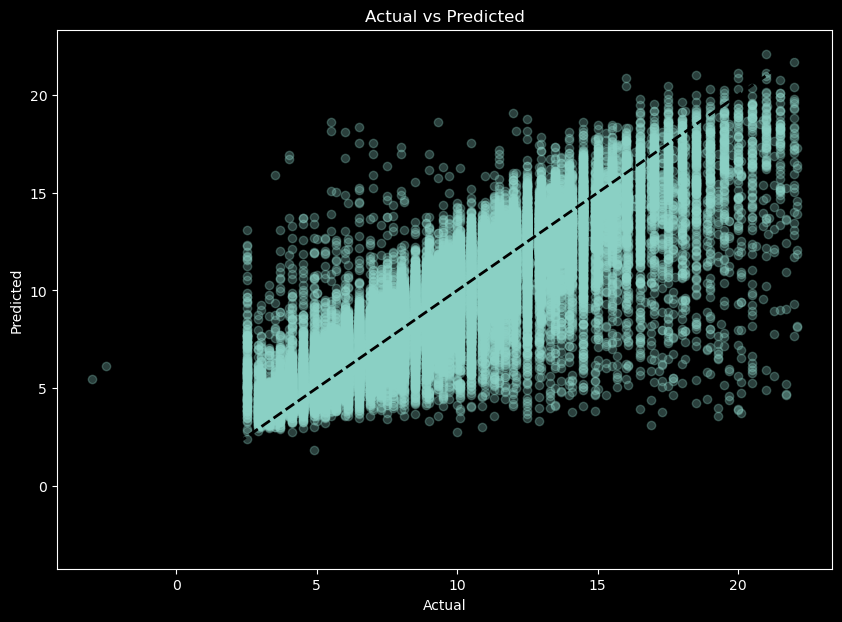

In [23]:
import xgboost as xgb
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Assuming you have your features and target variable in X and y, respectively.

y= df_cleaned_labeled_modified['fare_amount']

X_train, X_test, y_train, y_test = train_test_split(X_min_max_df, y, test_size=0.2, random_state=42)

# Define the XGBoost regressor with the best parameters found
model = XGBRegressor(
    n_estimators=484,
    max_depth=7,
    learning_rate=0.10914634779079604,
    subsample=0.8572501626997906,
    colsample_bytree=0.8141232278856032,
    reg_alpha=8.679785352347421,
    reg_lambda=5.7330420842142775,
    random_state=42
)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f'Test MSE: {mse}')

# Calculate the R2
r2 = model.score(X_test, y_test)
print(f'Test R^2: {r2}')

# Plot Actual vs Predicted
plt.figure(figsize=(10, 7))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()


# 20-Feature

Test MSE: 18.720309461063568
Test R^2: 0.8111192328881615


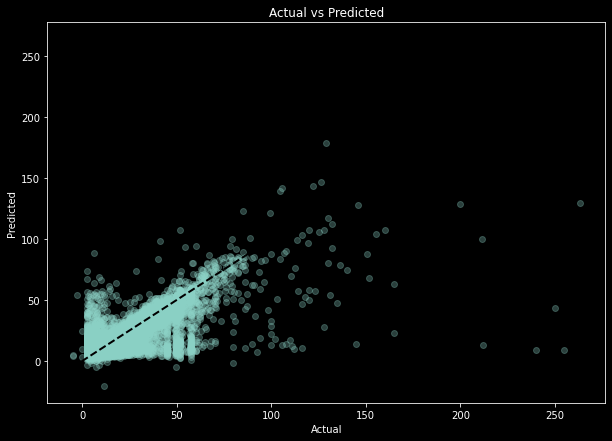

In [31]:
import xgboost as xgb
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Assuming you have your features and target variable in X and y, respectively.

y= df_cleaned_labeled_modified['fare_amount']

X_train, X_test, y_train, y_test = train_test_split(X_min_max_df, y, test_size=0.2, random_state=42)

# Define the XGBoost regressor with the best parameters found
model = XGBRegressor(
    n_estimators=484,
    max_depth=7,
    learning_rate=0.10914634779079604,
    subsample=0.8572501626997906,
    colsample_bytree=0.8141232278856032,
    reg_alpha=8.679785352347421,
    reg_lambda=5.7330420842142775,
    random_state=42
)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f'Test MSE: {mse}')

# Calculate the R2
r2 = model.score(X_test, y_test)
print(f'Test R^2: {r2}')

# Plot Actual vs Predicted
plt.figure(figsize=(10, 7))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()


# 12 Features

Test MSE: 3.1370296805277964
Test R^2: 0.7348247135674324


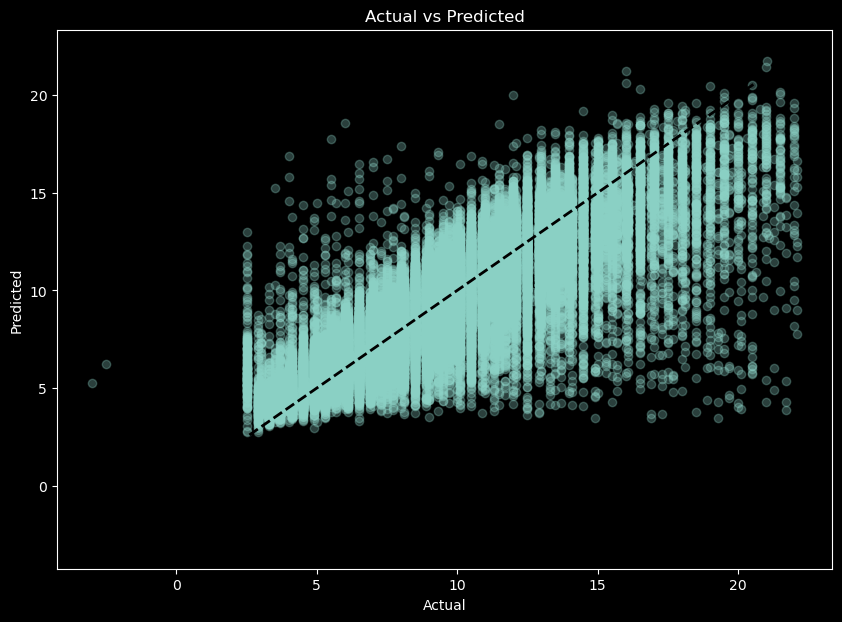

In [35]:
import xgboost as xgb
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Assuming you have your features and target variable in X and y, respectively.

y= df_cleaned_labeled_modified['fare_amount']

X_train, X_test, y_train, y_test = train_test_split(X_min_max_df, y, test_size=0.2, random_state=42)

# Define the XGBoost regressor with the best parameters found
model = XGBRegressor(
    n_estimators=484,
    max_depth=7,
    learning_rate=0.10914634779079604,
    subsample=0.8572501626997906,
    colsample_bytree=0.8141232278856032,
    reg_alpha=8.679785352347421,
    reg_lambda=5.7330420842142775,
    random_state=42
)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f'Test MSE: {mse}')

# Calculate the R2
r2 = model.score(X_test, y_test)
print(f'Test R^2: {r2}')

# Plot Actual vs Predicted
plt.figure(figsize=(10, 7))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()


# 16- Features 


# Outliers not removed

Test MSE: 18.706875059497623
Test R^2: 0.811254780865012


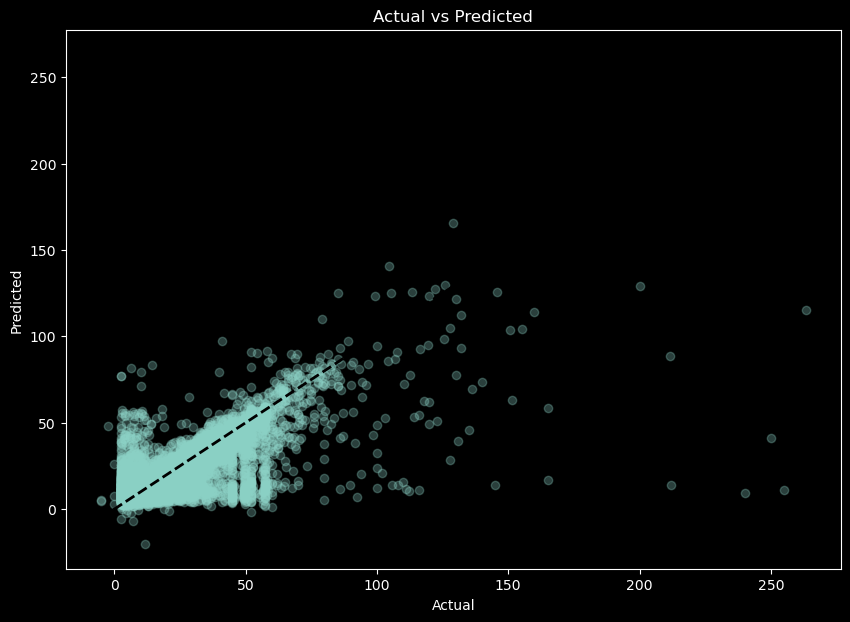

In [40]:
import xgboost as xgb
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Assuming you have your features and target variable in X and y, respectively.

y= df_cleaned_labeled_modified['fare_amount']

X_train, X_test, y_train, y_test = train_test_split(X_min_max_df, y, test_size=0.2, random_state=42)

# Define the XGBoost regressor with the best parameters found
model = XGBRegressor(
    n_estimators=484,
    max_depth=7,
    learning_rate=0.10914634779079604,
    subsample=0.8572501626997906,
    colsample_bytree=0.8141232278856032,
    reg_alpha=8.679785352347421,
    reg_lambda=5.7330420842142775,
    random_state=42
)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f'Test MSE: {mse}')

# Calculate the R2
r2 = model.score(X_test, y_test)
print(f'Test R^2: {r2}')

# Plot Actual vs Predicted
plt.figure(figsize=(10, 7))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()


Without outliers

Test MSE: 8.185150035904966
Test R^2: 0.7998761932869722


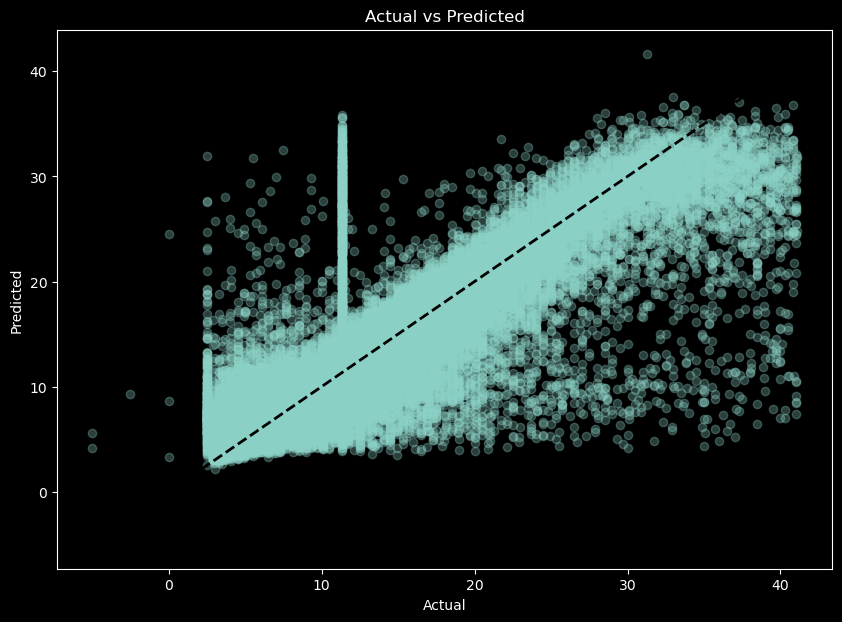

In [65]:
#mean
import xgboost as xgb
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Assuming you have your features and target variable in X and y, respectively.

y= df_cleaned_labeled_modified['fare_amount']

X_train, X_test, y_train, y_test = train_test_split(X_min_max_df, y, test_size=0.2, random_state=42)

# Define the XGBoost regressor with the best parameters found
model = XGBRegressor(
    n_estimators=484,
    max_depth=7,
    learning_rate=0.10914634779079604,
    subsample=0.8572501626997906,
    colsample_bytree=0.8141232278856032,
    reg_alpha=8.679785352347421,
    reg_lambda=5.7330420842142775,
    random_state=42
)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f'Test MSE: {mse}')

# Calculate the R2
r2 = model.score(X_test, y_test)
print(f'Test R^2: {r2}')

# Plot Actual vs Predicted
plt.figure(figsize=(10, 7))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()


Test MSE: 8.710591123172533
Test R^2: 0.7872552148560897


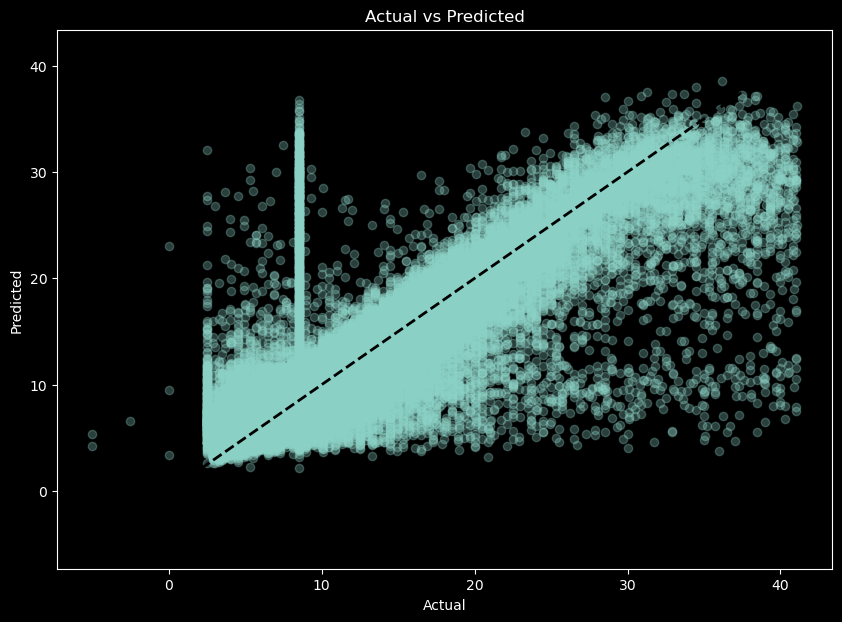

In [84]:
# median
# import xgboost as xgb
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# Assuming you have your features and target variable in X and y, respectively.

y= df_cleaned_labeled_modified['fare_amount']

X_train, X_test, y_train, y_test = train_test_split(X_min_max_df, y, test_size=0.2, random_state=42)

# Define the XGBoost regressor with the best parameters found
model = XGBRegressor(
    n_estimators=484,
    max_depth=7,
    learning_rate=0.10914634779079604,
    subsample=0.8572501626997906,
    colsample_bytree=0.8141232278856032,
    reg_alpha=8.679785352347421,
    reg_lambda=5.7330420842142775,
    random_state=42
)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate the Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print(f'Test MSE: {mse}')

# Calculate the R2
r2 = model.score(X_test, y_test)
print(f'Test R^2: {r2}')

# Plot Actual vs Predicted
plt.figure(figsize=(10, 7))
plt.scatter(y_test, y_pred, alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')
plt.show()
 

# Use lightgbm for regression

In [42]:
pip install lightgbm


     ---------------------------------------- 1.4/1.4 MB 3.2 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


[I 2024-07-31 13:36:17,209] A new study created in memory with name: no-name-7fd35227-e685-4a31-83ff-e39051900289


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030607 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2024-07-31 13:36:18,349] Trial 0 finished with value: 2.577989649855556 and parameters: {'n_estimators': 56, 'max_depth': 3, 'learning_rate': 0.022138358463152968, 'subsample': 0.7398361213716262, 'colsample_bytree': 0.5652237666369533, 'reg_alpha': 2.3232454583084525, 'reg_lambda': 1.9487998366267478}. Best is trial 0 with value: 2.577989649855556.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Foun

[I 2024-07-31 13:36:24,467] Trial 1 finished with value: 1.6428324275254367 and parameters: {'n_estimators': 397, 'max_depth': 10, 'learning_rate': 0.24525892299063773, 'subsample': 0.8269853589311826, 'colsample_bytree': 0.6930531203588243, 'reg_alpha': 8.455769633210355, 'reg_lambda': 2.7588044130693756}. Best is trial 1 with value: 1.6428324275254367.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027474 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:36:29,188] Trial 2 finished with value: 1.6473337411642592 and parameters: {'n_estimators': 272, 'max_depth': 17, 'learning_rate': 0.08485844560266469, 'subsample': 0.6546047080872788, 'colsample_bytree': 0.7489487725263749, 'reg_alpha': 7.477090011470641, 'reg_lambda': 5.48385891849661}. Best is trial 1 with value: 1.6428324275254367.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.026383 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2024-07-31 13:36:32,992] Trial 3 finished with value: 1.6898700806528568 and parameters: {'n_estimators': 467, 'max_depth': 3, 'learning_rate': 0.1781904742944906, 'subsample': 0.942692884773061, 'colsample_bytree': 0.5202520837753398, 'reg_alpha': 5.052108688086764, 'reg_lambda': 4.708331529039345}. Best is trial 1 with value: 1.6428324275254367.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.028327 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:36:34,502] Trial 4 finished with value: 1.6829577893032095 and parameters: {'n_estimators': 68, 'max_depth': 15, 'learning_rate': 0.29191890358347106, 'subsample': 0.9325449790716906, 'colsample_bytree': 0.648553455696962, 'reg_alpha': 5.017710896525748, 'reg_lambda': 2.235778592259231}. Best is trial 1 with value: 1.6428324275254367.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.029445 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2024-07-31 13:36:36,476] Trial 5 finished with value: 1.8530489083585835 and parameters: {'n_estimators': 185, 'max_depth': 3, 'learning_rate': 0.04194682900683308, 'subsample': 0.630728444030427, 'colsample_bytree': 0.5596225848160954, 'reg_alpha': 7.41063776826291, 'reg_lambda': 9.25485156480143}. Best is trial 1 with value: 1.6428324275254367.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031112 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:36:39,146] Trial 6 finished with value: 1.6611730383332757 and parameters: {'n_estimators': 160, 'max_depth': 16, 'learning_rate': 0.29037887577681915, 'subsample': 0.9832102707168886, 'colsample_bytree': 0.7019679757312832, 'reg_alpha': 6.1112337410692135, 'reg_lambda': 5.161679736373625}. Best is trial 1 with value: 1.6428324275254367.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.029546 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2024-07-31 13:36:43,848] Trial 7 finished with value: 1.6654352949900149 and parameters: {'n_estimators': 367, 'max_depth': 4, 'learning_rate': 0.12353537178320727, 'subsample': 0.8153323966583824, 'colsample_bytree': 0.954271484896009, 'reg_alpha': 2.4901478107941255, 'reg_lambda': 2.6229567169490786}. Best is trial 1 with value: 1.6428324275254367.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027897 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:36:45,951] Trial 8 finished with value: 1.65628953067536 and parameters: {'n_estimators': 104, 'max_depth': 14, 'learning_rate': 0.16665810216742696, 'subsample': 0.5218912778108208, 'colsample_bytree': 0.7506748718728355, 'reg_alpha': 6.903321467081489, 'reg_lambda': 5.4886344172431105}. Best is trial 1 with value: 1.6428324275254367.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.047164 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2024-07-31 13:36:49,832] Trial 9 finished with value: 1.731477039622203 and parameters: {'n_estimators': 264, 'max_depth': 4, 'learning_rate': 0.04706833941991466, 'subsample': 0.925165129814528, 'colsample_bytree': 0.7878642680967083, 'reg_alpha': 0.8052950973493012, 'reg_lambda': 1.6107522808838715}. Best is trial 1 with value: 1.6428324275254367.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031918 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:36:56,936] Trial 10 finished with value: 1.6312230367082603 and parameters: {'n_estimators': 499, 'max_depth': 9, 'learning_rate': 0.21563144586424257, 'subsample': 0.8080550604984094, 'colsample_bytree': 0.8599633631625512, 'reg_alpha': 9.602200084972523, 'reg_lambda': 0.2618229380882431}. Best is trial 10 with value: 1.6312230367082603.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.028416 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:03,889] Trial 11 finished with value: 1.6290891806632464 and parameters: {'n_estimators': 495, 'max_depth': 9, 'learning_rate': 0.22642742934516724, 'subsample': 0.8201816785109487, 'colsample_bytree': 0.8903163046916522, 'reg_alpha': 9.798286389275122, 'reg_lambda': 0.059512408558313135}. Best is trial 11 with value: 1.6290891806632464.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:10,716] Trial 12 finished with value: 1.6285754927557168 and parameters: {'n_estimators': 495, 'max_depth': 9, 'learning_rate': 0.21956264344691864, 'subsample': 0.819343216032052, 'colsample_bytree': 0.8990454711545551, 'reg_alpha': 9.995763384771339, 'reg_lambda': 0.07729142646688467}. Best is trial 12 with value: 1.6285754927557168.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030233 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:16,945] Trial 13 finished with value: 1.6321707724940624 and parameters: {'n_estimators': 420, 'max_depth': 7, 'learning_rate': 0.23133926634226581, 'subsample': 0.7246999433802416, 'colsample_bytree': 0.9991221316800624, 'reg_alpha': 9.890396041874698, 'reg_lambda': 0.03615999543735868}. Best is trial 12 with value: 1.6285754927557168.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031548 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:22,246] Trial 14 finished with value: 1.6271034107471878 and parameters: {'n_estimators': 341, 'max_depth': 20, 'learning_rate': 0.19971533945177167, 'subsample': 0.8709804660140609, 'colsample_bytree': 0.8867223370649815, 'reg_alpha': 8.615966268781044, 'reg_lambda': 8.085995899862857}. Best is trial 14 with value: 1.6271034107471878.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:28,001] Trial 15 finished with value: 1.630660068172031 and parameters: {'n_estimators': 336, 'max_depth': 20, 'learning_rate': 0.1225219984807492, 'subsample': 0.8814380408814793, 'colsample_bytree': 0.8609033382884019, 'reg_alpha': 8.593367263078882, 'reg_lambda': 8.567817174534655}. Best is trial 14 with value: 1.6271034107471878.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030685 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:34,523] Trial 16 finished with value: 1.627780920223874 and parameters: {'n_estimators': 428, 'max_depth': 12, 'learning_rate': 0.1911532151063539, 'subsample': 0.8599095608484687, 'colsample_bytree': 0.9066883250036919, 'reg_alpha': 8.491690280477503, 'reg_lambda': 7.455961892431986}. Best is trial 14 with value: 1.6271034107471878.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:39,384] Trial 17 finished with value: 1.6354873612604675 and parameters: {'n_estimators': 311, 'max_depth': 20, 'learning_rate': 0.188113699931438, 'subsample': 0.8747014563972213, 'colsample_bytree': 0.8281108585634374, 'reg_alpha': 5.982200451485458, 'reg_lambda': 7.546239644260594}. Best is trial 14 with value: 1.6271034107471878.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032610 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:45,912] Trial 18 finished with value: 1.6258316391612446 and parameters: {'n_estimators': 427, 'max_depth': 13, 'learning_rate': 0.12879920090051977, 'subsample': 0.9980391998671614, 'colsample_bytree': 0.9471274410727457, 'reg_alpha': 8.333239433724144, 'reg_lambda': 7.115825423186001}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031202 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:50,273] Trial 19 finished with value: 1.6382367573225 and parameters: {'n_estimators': 221, 'max_depth': 18, 'learning_rate': 0.13687787041169913, 'subsample': 0.9893373867644326, 'colsample_bytree': 0.9664208447223889, 'reg_alpha': 3.607280729017657, 'reg_lambda': 6.928835474039502}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.033351 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:37:56,125] Trial 20 finished with value: 1.634380447071613 and parameters: {'n_estimators': 345, 'max_depth': 13, 'learning_rate': 0.08419350679518879, 'subsample': 0.9996886030575435, 'colsample_bytree': 0.9543910219325027, 'reg_alpha': 6.371450181732572, 'reg_lambda': 9.987377485045151}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.033181 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:38:03,788] Trial 21 finished with value: 1.6264787378537324 and parameters: {'n_estimators': 433, 'max_depth': 12, 'learning_rate': 0.15103293350395036, 'subsample': 0.8775703036380794, 'colsample_bytree': 0.9177640174242689, 'reg_alpha': 8.481643417265895, 'reg_lambda': 7.045816285089067}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031919 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:38:09,747] Trial 22 finished with value: 1.627409663408433 and parameters: {'n_estimators': 381, 'max_depth': 11, 'learning_rate': 0.14746190468284995, 'subsample': 0.913002715603472, 'colsample_bytree': 0.9265267801036147, 'reg_alpha': 7.837748930867263, 'reg_lambda': 6.424188517017436}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009375 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:38:18,692] Trial 23 finished with value: 1.631613265601129 and parameters: {'n_estimators': 452, 'max_depth': 18, 'learning_rate': 0.09654014551766626, 'subsample': 0.7683062011383932, 'colsample_bytree': 0.8220642971220522, 'reg_alpha': 8.971586690639176, 'reg_lambda': 8.009003462175873}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031686 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:38:24,806] Trial 24 finished with value: 1.6300097161505511 and parameters: {'n_estimators': 412, 'max_depth': 7, 'learning_rate': 0.15804496587662623, 'subsample': 0.9593634211312313, 'colsample_bytree': 0.9897254868275782, 'reg_alpha': 7.567164316330307, 'reg_lambda': 6.497703731567478}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.028254 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:38:29,772] Trial 25 finished with value: 1.63076135867301 and parameters: {'n_estimators': 311, 'max_depth': 13, 'learning_rate': 0.259535419773939, 'subsample': 0.8902142051387525, 'colsample_bytree': 0.9327781023409537, 'reg_alpha': 9.015934447694667, 'reg_lambda': 8.804144762714833}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.029255 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:38:36,517] Trial 26 finished with value: 1.628038369209037 and parameters: {'n_estimators': 446, 'max_depth': 14, 'learning_rate': 0.11310767736415431, 'subsample': 0.696329449342491, 'colsample_bytree': 0.8698573153628574, 'reg_alpha': 8.122975306242193, 'reg_lambda': 4.161412786953764}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009204 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


[I 2024-07-31 13:38:42,834] Trial 27 finished with value: 1.6392129665553794 and parameters: {'n_estimators': 372, 'max_depth': 6, 'learning_rate': 0.19270329646491546, 'subsample': 0.7726027732306022, 'colsample_bytree': 0.8291947740841482, 'reg_alpha': 4.1976688927017225, 'reg_lambda': 6.183986957296483}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.034333 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:38:47,820] Trial 28 finished with value: 1.6385065063484994 and parameters: {'n_estimators': 304, 'max_depth': 11, 'learning_rate': 0.1415724389699027, 'subsample': 0.8536000050664698, 'colsample_bytree': 0.791949540725118, 'reg_alpha': 6.869170106735171, 'reg_lambda': 8.009022222778757}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030247 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:38:52,554] Trial 29 finished with value: 1.6278213927019787 and parameters: {'n_estimators': 342, 'max_depth': 16, 'learning_rate': 0.20207583924406392, 'subsample': 0.9636293037148773, 'colsample_bytree': 0.9280161740534411, 'reg_alpha': 9.11198583394665, 'reg_lambda': 3.8843589841530326}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.047565 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:38:58,599] Trial 30 finished with value: 1.6378020560507058 and parameters: {'n_estimators': 469, 'max_depth': 19, 'learning_rate': 0.10212621854491097, 'subsample': 0.5288453183635744, 'colsample_bytree': 0.6152107728223327, 'reg_alpha': 0.08931053620208296, 'reg_lambda': 9.900870624007943}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.029708 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:39:03,873] Trial 31 finished with value: 1.627317219456797 and parameters: {'n_estimators': 386, 'max_depth': 11, 'learning_rate': 0.1484843594762338, 'subsample': 0.9016908981893953, 'colsample_bytree': 0.9265387092700351, 'reg_alpha': 7.717669364832319, 'reg_lambda': 6.421235766310325}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032835 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:39:09,509] Trial 32 finished with value: 1.6264831061641671 and parameters: {'n_estimators': 381, 'max_depth': 12, 'learning_rate': 0.16237431535029642, 'subsample': 0.9130632734733375, 'colsample_bytree': 0.9693133080134526, 'reg_alpha': 6.81902873316837, 'reg_lambda': 7.220096406048034}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:39:15,751] Trial 33 finished with value: 1.6264807097840903 and parameters: {'n_estimators': 400, 'max_depth': 13, 'learning_rate': 0.17457957101980343, 'subsample': 0.9569038507811433, 'colsample_bytree': 0.9802804822147776, 'reg_alpha': 6.90866742070187, 'reg_lambda': 7.209859282386116}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007716 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:39:22,018] Trial 34 finished with value: 1.6278255419666445 and parameters: {'n_estimators': 403, 'max_depth': 13, 'learning_rate': 0.1733785303893132, 'subsample': 0.9561885823247578, 'colsample_bytree': 0.9770521221147218, 'reg_alpha': 5.682051373573489, 'reg_lambda': 7.059223524106347}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007612 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:39:30,084] Trial 35 finished with value: 1.6359899193843475 and parameters: {'n_estimators': 438, 'max_depth': 12, 'learning_rate': 0.061799859037521415, 'subsample': 0.9186445666192274, 'colsample_bytree': 0.999476994991188, 'reg_alpha': 6.848610172065456, 'reg_lambda': 5.830683153560611}. Best is trial 18 with value: 1.6258316391612446.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030973 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:39:36,284] Trial 36 finished with value: 1.6228129281279684 and parameters: {'n_estimators': 470, 'max_depth': 15, 'learning_rate': 0.16300941299331864, 'subsample': 0.9452357101561176, 'colsample_bytree': 0.9587737355868099, 'reg_alpha': 7.205121552520051, 'reg_lambda': 7.200602227900474}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.034696 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:39:42,740] Trial 37 finished with value: 1.6239321391015606 and parameters: {'n_estimators': 468, 'max_depth': 15, 'learning_rate': 0.1313109127985039, 'subsample': 0.9707449045275204, 'colsample_bytree': 0.9473899419213576, 'reg_alpha': 5.305003782410621, 'reg_lambda': 4.650353849622067}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032757 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:39:50,199] Trial 38 finished with value: 1.6319569450555207 and parameters: {'n_estimators': 459, 'max_depth': 15, 'learning_rate': 0.07181661469681201, 'subsample': 0.9789340590133572, 'colsample_bytree': 0.949207855218055, 'reg_alpha': 4.39716990719054, 'reg_lambda': 4.653409236950555}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025534 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:39:59,059] Trial 39 finished with value: 1.7092015596628172 and parameters: {'n_estimators': 465, 'max_depth': 16, 'learning_rate': 0.013468080009897077, 'subsample': 0.9394237542574031, 'colsample_bytree': 0.9197944523411606, 'reg_alpha': 5.447071923594936, 'reg_lambda': 3.172158704356565}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025608 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:04,784] Trial 40 finished with value: 1.6392135583877832 and parameters: {'n_estimators': 477, 'max_depth': 15, 'learning_rate': 0.12875277807451463, 'subsample': 0.5800158605785686, 'colsample_bytree': 0.6976928310235926, 'reg_alpha': 2.365845077107746, 'reg_lambda': 5.455910929123515}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.033810 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:10,956] Trial 41 finished with value: 1.623888885729732 and parameters: {'n_estimators': 426, 'max_depth': 14, 'learning_rate': 0.17653782712654914, 'subsample': 0.969112088266406, 'colsample_bytree': 0.9474468893923768, 'reg_alpha': 7.419635267984038, 'reg_lambda': 5.927449620388115}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.035320 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:17,329] Trial 42 finished with value: 1.6286005946655953 and parameters: {'n_estimators': 427, 'max_depth': 14, 'learning_rate': 0.10808586463359963, 'subsample': 0.9772815491113216, 'colsample_bytree': 0.9546698685538995, 'reg_alpha': 8.025934550507804, 'reg_lambda': 5.794105717815684}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.033137 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:25,068] Trial 43 finished with value: 1.6290404033563992 and parameters: {'n_estimators': 476, 'max_depth': 17, 'learning_rate': 0.1307914323109757, 'subsample': 0.9339754506139232, 'colsample_bytree': 0.876904757990437, 'reg_alpha': 7.324324996605984, 'reg_lambda': 4.9603806562445545}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030724 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:31,577] Trial 44 finished with value: 1.6276154762995685 and parameters: {'n_estimators': 442, 'max_depth': 16, 'learning_rate': 0.15410755751831715, 'subsample': 0.9399598312094624, 'colsample_bytree': 0.9077177929640282, 'reg_alpha': 6.310044860156177, 'reg_lambda': 4.4000710529166485}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.036682 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:37,909] Trial 45 finished with value: 1.634162982910718 and parameters: {'n_estimators': 484, 'max_depth': 10, 'learning_rate': 0.11554097095659485, 'subsample': 0.9871313363212396, 'colsample_bytree': 0.7344216195358928, 'reg_alpha': 2.867105441827218, 'reg_lambda': 6.738283466793906}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030496 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:40,525] Trial 46 finished with value: 1.6443446886846134 and parameters: {'n_estimators': 127, 'max_depth': 15, 'learning_rate': 0.1758034212159629, 'subsample': 0.8408555377976284, 'colsample_bytree': 0.9451895675141591, 'reg_alpha': 5.019333898612199, 'reg_lambda': 3.7739103543262256}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030785 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:46,760] Trial 47 finished with value: 1.6298789493978656 and parameters: {'n_estimators': 414, 'max_depth': 14, 'learning_rate': 0.09261102770885231, 'subsample': 0.9659999396351622, 'colsample_bytree': 0.8493837618702348, 'reg_alpha': 9.428896512719104, 'reg_lambda': 5.785601507122257}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031205 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:50,810] Trial 48 finished with value: 1.6386334983959665 and parameters: {'n_estimators': 239, 'max_depth': 10, 'learning_rate': 0.16170348709512083, 'subsample': 0.9979453186698362, 'colsample_bytree': 0.9015711092408429, 'reg_alpha': 8.26137313000083, 'reg_lambda': 5.041088795177407}. Best is trial 36 with value: 1.6228129281279684.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030150 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:40:55,466] Trial 49 finished with value: 1.6470541225608866 and parameters: {'n_estimators': 362, 'max_depth': 17, 'learning_rate': 0.2081839938209477, 'subsample': 0.9024915826478512, 'colsample_bytree': 0.6570333247670197, 'reg_alpha': 1.4583181191016301, 'reg_lambda': 7.738499863424992}. Best is trial 36 with value: 1.6228129281279684.


Best parameters found: {'n_estimators': 470, 'max_depth': 15, 'learning_rate': 0.16300941299331864, 'subsample': 0.9452357101561176, 'colsample_bytree': 0.9587737355868099, 'reg_alpha': 7.205121552520051, 'reg_lambda': 7.200602227900474}
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031122 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3415
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 22
[LightGBM] [Info] Start training from score 8.260400
Test MSE: 2.633521799699271
Test RMSE: 1.6228129281279684
Test R^2: 0.7775801271216628


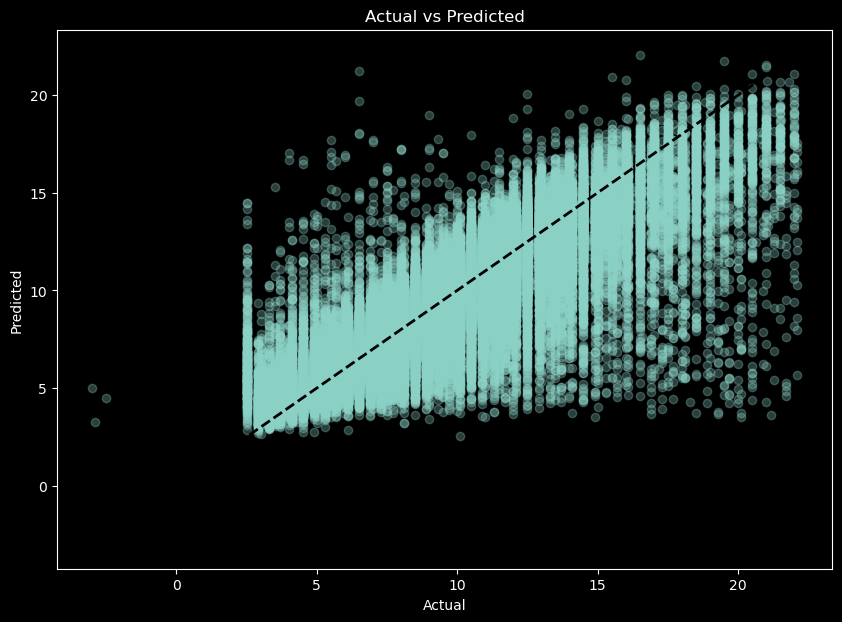

In [53]:
import optuna
import numpy as np
from lightgbm import LGBMRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Assuming df_cleaned_labeled_modified is your DataFrame and 'fare_amount' is your target variable
y = df_cleaned_labeled_modified['fare_amount']
X = df_cleaned_labeled_modified.drop(columns=['fare_amount'])  # Assuming X contains all other features

def LightGBM_Regressor(X, y):
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, shuffle=True)

    def objective(trial):
        # Suggest hyperparameters
        param = {
            'n_estimators': trial.suggest_int('n_estimators', 50, 500),
            'max_depth': trial.suggest_int('max_depth', 3, 20),
            'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
            'subsample': trial.suggest_float('subsample', 0.5, 1.0),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
            'reg_alpha': trial.suggest_float('reg_alpha', 0, 10),
            'reg_lambda': trial.suggest_float('reg_lambda', 0, 10)
        }

        # Create the model with suggested hyperparameters
        lgb_model = LGBMRegressor(**param, random_state=44, n_jobs=-1)

        # Train the model
        lgb_model.fit(X_train, y_train)

        # Predict and evaluate
        y_pred = lgb_model.predict(X_test)
        rmse = mean_squared_error(y_test, y_pred, squared=False)
        return rmse

    # Create an Optuna study
    study = optuna.create_study(direction='minimize')
    # Optimize the objective function
    study.optimize(objective, n_trials=50, timeout=2000)

    # Get the best parameters
    best_params = study.best_params
    print(f"Best parameters found: {best_params}")

    # Train the best model with the best parameters
    best_model = LGBMRegressor(**best_params, random_state=44, n_jobs=-1)
    best_model.fit(X_train, y_train)

    # Make predictions with the best model
    y_pred = best_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    r2 = r2_score(y_test, y_pred)

    print(f"Test MSE: {mse}")
    print(f"Test RMSE: {rmse}")
    print(f"Test R^2: {r2}")

    # Plot Actual vs Predicted
    plt.figure(figsize=(10, 7))
    plt.scatter(y_test, y_pred, alpha=0.3)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title('Actual vs Predicted')
    plt.show()

# Example usage: Assuming X and y are your feature matrix and target variable
LightGBM_Regressor(X, y)


# **_Lightgm_**

**_with 9 features_**

[I 2024-07-31 13:43:21,462] A new study created in memory with name: no-name-a339b40e-da70-4c87-a64d-f821f2cfc428


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007247 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:43:28,807] Trial 0 finished with value: 1.6345033365786423 and parameters: {'n_estimators': 468, 'max_depth': 9, 'learning_rate': 0.11096627195848742, 'subsample': 0.9663480597113656, 'colsample_bytree': 0.648986907068393, 'reg_alpha': 2.0948496575981137, 'reg_lambda': 6.291633676674627}. Best is trial 0 with value: 1.6345033365786423.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024990 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


[I 2024-07-31 13:43:35,655] Trial 1 finished with value: 1.6336985155226271 and parameters: {'n_estimators': 482, 'max_depth': 6, 'learning_rate': 0.1798641322437735, 'subsample': 0.6234351155821196, 'colsample_bytree': 0.9941466954827357, 'reg_alpha': 4.797189162384936, 'reg_lambda': 1.2930351685472685}. Best is trial 1 with value: 1.6336985155226271.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003820 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:43:40,503] Trial 2 finished with value: 1.6415854904582494 and parameters: {'n_estimators': 343, 'max_depth': 8, 'learning_rate': 0.22254302404932041, 'subsample': 0.7181459190056698, 'colsample_bytree': 0.5300123489645077, 'reg_alpha': 8.922879382055957, 'reg_lambda': 1.5104746464065943}. Best is trial 1 with value: 1.6336985155226271.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023796 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:43:45,252] Trial 3 finished with value: 1.6497102989639756 and parameters: {'n_estimators': 250, 'max_depth': 14, 'learning_rate': 0.07111362809689999, 'subsample': 0.855630443198629, 'colsample_bytree': 0.9390007590092184, 'reg_alpha': 9.541695912394456, 'reg_lambda': 9.62471732330934}. Best is trial 1 with value: 1.6336985155226271.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022327 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[I 2024-07-31 13:43:47,887] Trial 4 finished with value: 1.6863307503133864 and parameters: {'n_estimators': 284, 'max_depth': 3, 'learning_rate': 0.2509953930030257, 'subsample': 0.7786577536917463, 'colsample_bytree': 0.8686325101324942, 'reg_alpha': 7.923737589721089, 'reg_lambda': 0.3454409927390356}. Best is trial 1 with value: 1.6336985155226271.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


[I 2024-07-31 13:43:52,754] Trial 5 finished with value: 1.6373908220426427 and parameters: {'n_estimators': 416, 'max_depth': 6, 'learning_rate': 0.2905187937707421, 'subsample': 0.5478561420250705, 'colsample_bytree': 0.6688045947234171, 'reg_alpha': 6.2708435613429785, 'reg_lambda': 8.510585108809273}. Best is trial 1 with value: 1.6336985155226271.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022302 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:43:54,811] Trial 6 finished with value: 1.6499610473066946 and parameters: {'n_estimators': 151, 'max_depth': 18, 'learning_rate': 0.23939779288919424, 'subsample': 0.6016867248219944, 'colsample_bytree': 0.5831012986898305, 'reg_alpha': 9.689637118056377, 'reg_lambda': 6.027760639572346}. Best is trial 1 with value: 1.6336985155226271.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.048107 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


[I 2024-07-31 13:44:00,982] Trial 7 finished with value: 1.6407097971387428 and parameters: {'n_estimators': 404, 'max_depth': 6, 'learning_rate': 0.12106293358790905, 'subsample': 0.6617273015328355, 'colsample_bytree': 0.7336131072265528, 'reg_alpha': 1.6815001436193255, 'reg_lambda': 0.9176420164928023}. Best is trial 1 with value: 1.6336985155226271.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023912 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:07,322] Trial 8 finished with value: 1.6301393514039684 and parameters: {'n_estimators': 487, 'max_depth': 16, 'learning_rate': 0.19539367173125047, 'subsample': 0.548900072158472, 'colsample_bytree': 0.9768305504277442, 'reg_alpha': 2.8423421436941854, 'reg_lambda': 2.8674770441260566}. Best is trial 8 with value: 1.6301393514039684.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022676 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:10,196] Trial 9 finished with value: 1.642586694718831 and parameters: {'n_estimators': 179, 'max_depth': 10, 'learning_rate': 0.22981709521147237, 'subsample': 0.7705466865225585, 'colsample_bytree': 0.8873899775015668, 'reg_alpha': 4.318726220978864, 'reg_lambda': 6.860537102243999}. Best is trial 8 with value: 1.6301393514039684.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024711 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:11,772] Trial 10 finished with value: 1.673283815945308 and parameters: {'n_estimators': 64, 'max_depth': 20, 'learning_rate': 0.1629227460267773, 'subsample': 0.5297464750136793, 'colsample_bytree': 0.834308156990095, 'reg_alpha': 0.5635565587590374, 'reg_lambda': 3.1655965328043982}. Best is trial 8 with value: 1.6301393514039684.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006441 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:18,248] Trial 11 finished with value: 1.6298467754437542 and parameters: {'n_estimators': 481, 'max_depth': 15, 'learning_rate': 0.17337806116098567, 'subsample': 0.6334286152806934, 'colsample_bytree': 0.9646196104609074, 'reg_alpha': 3.8687393620810586, 'reg_lambda': 3.6051891774500247}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:27,020] Trial 12 finished with value: 1.6678193279471083 and parameters: {'n_estimators': 497, 'max_depth': 14, 'learning_rate': 0.02150997537966029, 'subsample': 0.5158371227833183, 'colsample_bytree': 0.9981547421613375, 'reg_alpha': 3.232341986173636, 'reg_lambda': 3.915388444708765}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024162 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:31,467] Trial 13 finished with value: 1.6299282784048303 and parameters: {'n_estimators': 385, 'max_depth': 15, 'learning_rate': 0.18255510576354475, 'subsample': 0.672136603932141, 'colsample_bytree': 0.7961561320063762, 'reg_alpha': 6.345825754371169, 'reg_lambda': 3.154064515381826}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022236 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:36,637] Trial 14 finished with value: 1.6345350465665875 and parameters: {'n_estimators': 384, 'max_depth': 13, 'learning_rate': 0.117707218679204, 'subsample': 0.6959889280473774, 'colsample_bytree': 0.7833753451927717, 'reg_alpha': 6.048820784158403, 'reg_lambda': 4.491528753320482}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.035586 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:41,004] Trial 15 finished with value: 1.631767238964484 and parameters: {'n_estimators': 343, 'max_depth': 17, 'learning_rate': 0.1370033578376432, 'subsample': 0.813373249895448, 'colsample_bytree': 0.7785082659943229, 'reg_alpha': 7.065639677150447, 'reg_lambda': 2.3533543192071784}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027572 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:46,408] Trial 16 finished with value: 1.6320022602466198 and parameters: {'n_estimators': 433, 'max_depth': 11, 'learning_rate': 0.19313399215594876, 'subsample': 0.6362453033038588, 'colsample_bytree': 0.9134606595642978, 'reg_alpha': 4.111134207723597, 'reg_lambda': 4.690566610031679}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021576 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:50,839] Trial 17 finished with value: 1.642497166442737 and parameters: {'n_estimators': 351, 'max_depth': 20, 'learning_rate': 0.0805416005585131, 'subsample': 0.9130350323777086, 'colsample_bytree': 0.6901889667802448, 'reg_alpha': 5.705756093416394, 'reg_lambda': 3.5995052342171503}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021651 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:44:54,850] Trial 18 finished with value: 1.6403104566388065 and parameters: {'n_estimators': 294, 'max_depth': 15, 'learning_rate': 0.2860492854089774, 'subsample': 0.7088401737113089, 'colsample_bytree': 0.8426579822733925, 'reg_alpha': 7.864484626044355, 'reg_lambda': 2.147905739738735}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021498 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:00,008] Trial 19 finished with value: 1.6300201261677025 and parameters: {'n_estimators': 440, 'max_depth': 18, 'learning_rate': 0.1556029788971957, 'subsample': 0.5918024011275402, 'colsample_bytree': 0.8119130416556072, 'reg_alpha': 3.651653246257673, 'reg_lambda': 5.649447695633784}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021649 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:04,106] Trial 20 finished with value: 1.6329330432233673 and parameters: {'n_estimators': 376, 'max_depth': 12, 'learning_rate': 0.2126465475447415, 'subsample': 0.6865629292197406, 'colsample_bytree': 0.6126406627284593, 'reg_alpha': 5.415835738671081, 'reg_lambda': 7.307540730157765}. Best is trial 11 with value: 1.6298467754437542.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022713 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:09,360] Trial 21 finished with value: 1.62881662630434 and parameters: {'n_estimators': 437, 'max_depth': 17, 'learning_rate': 0.15656228397130784, 'subsample': 0.5861465899117587, 'colsample_bytree': 0.8071578344493707, 'reg_alpha': 3.7809376249676636, 'reg_lambda': 5.60268096989968}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005739 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:15,252] Trial 22 finished with value: 1.6301287226506302 and parameters: {'n_estimators': 446, 'max_depth': 16, 'learning_rate': 0.16717981942510746, 'subsample': 0.5923905730296493, 'colsample_bytree': 0.7345866771816287, 'reg_alpha': 2.330883157656053, 'reg_lambda': 5.266720367267084}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030589 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:19,549] Trial 23 finished with value: 1.6350026675657825 and parameters: {'n_estimators': 318, 'max_depth': 18, 'learning_rate': 0.1441897683614231, 'subsample': 0.6561016122215181, 'colsample_bytree': 0.9191902349901397, 'reg_alpha': 4.700273823582022, 'reg_lambda': 4.054040485768818}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021281 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:23,653] Trial 24 finished with value: 1.6489381384578905 and parameters: {'n_estimators': 234, 'max_depth': 15, 'learning_rate': 0.0895015854255408, 'subsample': 0.5724608026723186, 'colsample_bytree': 0.7604455635474833, 'reg_alpha': 1.2986184546727317, 'reg_lambda': 4.83966475149866}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023025 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:28,254] Trial 25 finished with value: 1.6291650766371877 and parameters: {'n_estimators': 399, 'max_depth': 12, 'learning_rate': 0.19976975049412382, 'subsample': 0.7458645651292902, 'colsample_bytree': 0.8180115971839994, 'reg_alpha': 6.90574802992418, 'reg_lambda': 7.6740409415707145}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023252 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:33,545] Trial 26 finished with value: 1.6356925563631965 and parameters: {'n_estimators': 447, 'max_depth': 12, 'learning_rate': 0.2643189662025633, 'subsample': 0.8364000462841834, 'colsample_bytree': 0.872812566123107, 'reg_alpha': 7.253580257575639, 'reg_lambda': 8.271413665287058}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023432 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:38,427] Trial 27 finished with value: 1.6312991376844868 and parameters: {'n_estimators': 412, 'max_depth': 11, 'learning_rate': 0.20899385272464893, 'subsample': 0.7325782941853988, 'colsample_bytree': 0.944527099643318, 'reg_alpha': 3.7394221985552405, 'reg_lambda': 7.514237102943479}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019380 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:45,041] Trial 28 finished with value: 1.6484925051176977 and parameters: {'n_estimators': 462, 'max_depth': 13, 'learning_rate': 0.044282869196555816, 'subsample': 0.7572415518765822, 'colsample_bytree': 0.6937586249907673, 'reg_alpha': 0.06239881281793247, 'reg_lambda': 8.854131734661198}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020210 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:51,249] Trial 29 finished with value: 1.629086191715122 and parameters: {'n_estimators': 470, 'max_depth': 19, 'learning_rate': 0.13472906018163538, 'subsample': 0.9302804651795518, 'colsample_bytree': 0.8377866122451177, 'reg_alpha': 2.935947653220662, 'reg_lambda': 6.694275647149299}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021671 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:45:56,172] Trial 30 finished with value: 1.6336656069518034 and parameters: {'n_estimators': 366, 'max_depth': 19, 'learning_rate': 0.13018136483230808, 'subsample': 0.9712171675769796, 'colsample_bytree': 0.8291773825706829, 'reg_alpha': 2.5233914849260604, 'reg_lambda': 6.58480491695305}. Best is trial 21 with value: 1.62881662630434.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024702 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:46:02,228] Trial 31 finished with value: 1.6279654897247957 and parameters: {'n_estimators': 500, 'max_depth': 17, 'learning_rate': 0.10826992418654023, 'subsample': 0.907799359939778, 'colsample_bytree': 0.8562368330653334, 'reg_alpha': 3.2538255754857786, 'reg_lambda': 7.8581552124414085}. Best is trial 31 with value: 1.6279654897247957.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021644 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:46:07,814] Trial 32 finished with value: 1.631530984248267 and parameters: {'n_estimators': 466, 'max_depth': 17, 'learning_rate': 0.1050019682641494, 'subsample': 0.9256869856486379, 'colsample_bytree': 0.8592809091076924, 'reg_alpha': 3.103363959711693, 'reg_lambda': 7.737615082862882}. Best is trial 31 with value: 1.6279654897247957.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023176 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:46:14,402] Trial 33 finished with value: 1.6279469880068307 and parameters: {'n_estimators': 495, 'max_depth': 19, 'learning_rate': 0.09804601139566979, 'subsample': 0.9949586685286274, 'colsample_bytree': 0.8951012528080237, 'reg_alpha': 4.985836765267235, 'reg_lambda': 9.381405309199275}. Best is trial 33 with value: 1.6279469880068307.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:46:21,284] Trial 34 finished with value: 1.631015130538802 and parameters: {'n_estimators': 493, 'max_depth': 19, 'learning_rate': 0.10025559500306097, 'subsample': 0.9232347112139364, 'colsample_bytree': 0.9002533492310981, 'reg_alpha': 4.708030467730726, 'reg_lambda': 9.940061766861552}. Best is trial 33 with value: 1.6279469880068307.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023640 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:46:27,818] Trial 35 finished with value: 1.6393153133576757 and parameters: {'n_estimators': 463, 'max_depth': 19, 'learning_rate': 0.06265927635904103, 'subsample': 0.9959443340580878, 'colsample_bytree': 0.8551045652049791, 'reg_alpha': 1.769916961448643, 'reg_lambda': 9.029870003190652}. Best is trial 33 with value: 1.6279469880068307.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022208 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:46:35,476] Trial 36 finished with value: 1.6382317845151175 and parameters: {'n_estimators': 498, 'max_depth': 17, 'learning_rate': 0.05660974009114755, 'subsample': 0.8762905475780857, 'colsample_bytree': 0.9301825683770847, 'reg_alpha': 5.046947360453602, 'reg_lambda': 6.2169254339836515}. Best is trial 33 with value: 1.6279469880068307.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022543 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:46:40,520] Trial 37 finished with value: 1.6282772536363899 and parameters: {'n_estimators': 426, 'max_depth': 20, 'learning_rate': 0.146755281876101, 'subsample': 0.8888596912191784, 'colsample_bytree': 0.8865959615910233, 'reg_alpha': 3.290936403150154, 'reg_lambda': 9.273538240546564}. Best is trial 33 with value: 1.6279469880068307.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022305 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:46:46,424] Trial 38 finished with value: 1.6329297098187652 and parameters: {'n_estimators': 431, 'max_depth': 20, 'learning_rate': 0.08966226589189516, 'subsample': 0.8932226263814651, 'colsample_bytree': 0.8886969431244733, 'reg_alpha': 5.245483943940286, 'reg_lambda': 9.398825100770193}. Best is trial 33 with value: 1.6279469880068307.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022153 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:46:50,888] Trial 39 finished with value: 1.6356679220649093 and parameters: {'n_estimators': 316, 'max_depth': 18, 'learning_rate': 0.1499933478880619, 'subsample': 0.9930079825417447, 'colsample_bytree': 0.9604214259628766, 'reg_alpha': 0.955806121508644, 'reg_lambda': 8.437827058759574}. Best is trial 33 with value: 1.6279469880068307.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021327 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[I 2024-07-31 13:46:54,990] Trial 40 finished with value: 1.6668166516380836 and parameters: {'n_estimators': 420, 'max_depth': 4, 'learning_rate': 0.11480000694227113, 'subsample': 0.9544764398190245, 'colsample_bytree': 0.7571120312336285, 'reg_alpha': 3.458765940259409, 'reg_lambda': 9.847909454885585}. Best is trial 33 with value: 1.6279469880068307.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022368 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:47:01,038] Trial 41 finished with value: 1.6272926654671156 and parameters: {'n_estimators': 477, 'max_depth': 19, 'learning_rate': 0.1410326907638529, 'subsample': 0.9508140924135623, 'colsample_bytree': 0.8749728424625396, 'reg_alpha': 2.7603009257182225, 'reg_lambda': 6.984127337969236}. Best is trial 41 with value: 1.6272926654671156.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.028389 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:47:07,737] Trial 42 finished with value: 1.628817617215902 and parameters: {'n_estimators': 455, 'max_depth': 20, 'learning_rate': 0.12895182358147086, 'subsample': 0.9577316990520038, 'colsample_bytree': 0.8766635585497005, 'reg_alpha': 2.06423241805484, 'reg_lambda': 8.060788757243724}. Best is trial 41 with value: 1.6272926654671156.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027723 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:47:14,026] Trial 43 finished with value: 1.6312483887916025 and parameters: {'n_estimators': 478, 'max_depth': 16, 'learning_rate': 0.10092725553047109, 'subsample': 0.807083803809146, 'colsample_bytree': 0.902204536842617, 'reg_alpha': 4.316396785388063, 'reg_lambda': 9.099014276284295}. Best is trial 41 with value: 1.6272926654671156.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024462 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:47:19,681] Trial 44 finished with value: 1.6300625609860013 and parameters: {'n_estimators': 499, 'max_depth': 8, 'learning_rate': 0.16393516331484712, 'subsample': 0.8669123222450801, 'colsample_bytree': 0.8034954082473574, 'reg_alpha': 2.6248860391076034, 'reg_lambda': 6.938526982945154}. Best is trial 41 with value: 1.6272926654671156.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005748 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:47:21,788] Trial 45 finished with value: 1.659857244384466 and parameters: {'n_estimators': 85, 'max_depth': 18, 'learning_rate': 0.182813403151723, 'subsample': 0.8973008256244502, 'colsample_bytree': 0.9458927790945206, 'reg_alpha': 4.465648358508226, 'reg_lambda': 5.632586352719342}. Best is trial 41 with value: 1.6272926654671156.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:47:27,366] Trial 46 finished with value: 1.638910506877259 and parameters: {'n_estimators': 420, 'max_depth': 17, 'learning_rate': 0.1517381736264134, 'subsample': 0.9727967413559614, 'colsample_bytree': 0.5031895225264211, 'reg_alpha': 3.3423488504033165, 'reg_lambda': 9.349546849983714}. Best is trial 41 with value: 1.6272926654671156.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:47:31,465] Trial 47 finished with value: 1.641515160949582 and parameters: {'n_estimators': 236, 'max_depth': 19, 'learning_rate': 0.12195678940365225, 'subsample': 0.9409793386298712, 'colsample_bytree': 0.855928485673967, 'reg_alpha': 3.9171605743474274, 'reg_lambda': 8.607347889238472}. Best is trial 41 with value: 1.6272926654671156.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023449 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:47:38,470] Trial 48 finished with value: 1.6554921094835262 and parameters: {'n_estimators': 400, 'max_depth': 20, 'learning_rate': 0.03638331117758974, 'subsample': 0.8373800905701781, 'colsample_bytree': 0.9750650185949478, 'reg_alpha': 2.0153293203737, 'reg_lambda': 7.062620180943691}. Best is trial 41 with value: 1.6272926654671156.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.026514 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:47:44,556] Trial 49 finished with value: 1.633071197255876 and parameters: {'n_estimators': 478, 'max_depth': 16, 'learning_rate': 0.08224020833605125, 'subsample': 0.8981614553568527, 'colsample_bytree': 0.7813483776254009, 'reg_alpha': 2.861918796785139, 'reg_lambda': 5.874772497381317}. Best is trial 41 with value: 1.6272926654671156.


Best parameters found: {'n_estimators': 477, 'max_depth': 19, 'learning_rate': 0.1410326907638529, 'subsample': 0.9508140924135623, 'colsample_bytree': 0.8749728424625396, 'reg_alpha': 2.7603009257182225, 'reg_lambda': 6.984127337969236}
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.036744 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2859
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
Test MSE: 2.64808141908307
Test RMSE: 1.6272926654671156
Test R^2: 0.7763504624601166


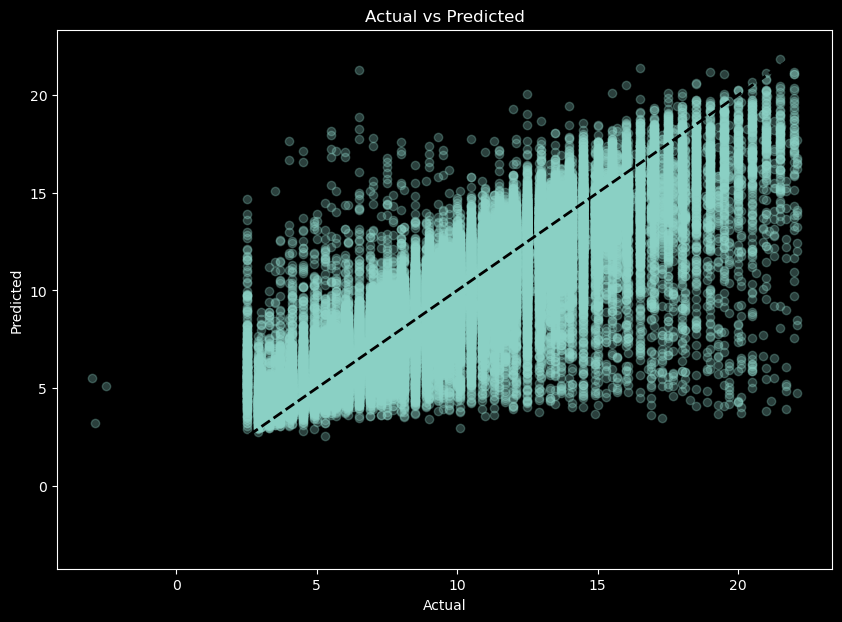

In [54]:
import optuna
import numpy as np
from lightgbm import LGBMRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Assuming df_cleaned_labeled_modified is your DataFrame and 'fare_amount' is your target variable
y = df_cleaned_labeled_modified['fare_amount']
X = df_cleaned_labeled_modified.drop(columns=['fare_amount'])  # Assuming X contains all other features

def LightGBM_Regressor(X, y):
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, shuffle=True)

    def objective(trial):
        # Suggest hyperparameters
        param = {
            'n_estimators': trial.suggest_int('n_estimators', 50, 500),
            'max_depth': trial.suggest_int('max_depth', 3, 20),
            'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
            'subsample': trial.suggest_float('subsample', 0.5, 1.0),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
            'reg_alpha': trial.suggest_float('reg_alpha', 0, 10),
            'reg_lambda': trial.suggest_float('reg_lambda', 0, 10)
        }

        # Create the model with suggested hyperparameters
        lgb_model = LGBMRegressor(**param, random_state=44, n_jobs=-1)

        # Train the model
        lgb_model.fit(X_train, y_train)

        # Predict and evaluate
        y_pred = lgb_model.predict(X_test)
        rmse = mean_squared_error(y_test, y_pred, squared=False)
        return rmse

    # Create an Optuna study
    study = optuna.create_study(direction='minimize')
    # Optimize the objective function
    study.optimize(objective, n_trials=50, timeout=2000)

    # Get the best parameters
    best_params = study.best_params
    print(f"Best parameters found: {best_params}")

    # Train the best model with the best parameters
    best_model = LGBMRegressor(**best_params, random_state=44, n_jobs=-1)
    best_model.fit(X_train, y_train)

    # Make predictions with the best model
    y_pred = best_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    r2 = r2_score(y_test, y_pred)

    print(f"Test MSE: {mse}")
    print(f"Test RMSE: {rmse}")
    print(f"Test R^2: {r2}")

    # Plot Actual vs Predicted
    plt.figure(figsize=(10, 7))
    plt.scatter(y_test, y_pred, alpha=0.3)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title('Actual vs Predicted')
    plt.show()

# Example usage: Assuming X and y are your feature matrix and target variable
LightGBM_Regressor(X_min_max_df, y)


[I 2024-07-31 13:49:12,665] A new study created in memory with name: no-name-68d312e1-76bc-40ed-9009-2846f842a0cf


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021965 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[I 2024-07-31 13:49:16,791] Trial 0 finished with value: 1.6787820353110938 and parameters: {'n_estimators': 334, 'max_depth': 5, 'learning_rate': 0.05296957967181594, 'subsample': 0.5562506473425648, 'colsample_bytree': 0.7989481814512802, 'reg_alpha': 2.9833540093688504, 'reg_lambda': 3.8308800078068437}. Best is trial 0 with value: 1.6787820353110938.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022784 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:49:19,479] Trial 1 finished with value: 1.653400098767062 and parameters: {'n_estimators': 180, 'max_depth': 7, 'learning_rate': 0.14538014172525418, 'subsample': 0.5444816636594045, 'colsample_bytree': 0.7846639625935413, 'reg_alpha': 0.02155418812382015, 'reg_lambda': 1.659233877119194}. Best is trial 1 with value: 1.653400098767062.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002220 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:49:22,233] Trial 2 finished with value: 1.7264937293078737 and parameters: {'n_estimators': 166, 'max_depth': 7, 'learning_rate': 0.04254495047809068, 'subsample': 0.986176425779437, 'colsample_bytree': 0.5257112333430001, 'reg_alpha': 1.078737413952472, 'reg_lambda': 5.191951416324816}. Best is trial 1 with value: 1.653400098767062.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023854 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:49:24,499] Trial 3 finished with value: 1.6971334787780596 and parameters: {'n_estimators': 118, 'max_depth': 18, 'learning_rate': 0.06243418412485571, 'subsample': 0.62426032418134, 'colsample_bytree': 0.7196060373724347, 'reg_alpha': 8.720616400153569, 'reg_lambda': 5.958280373816836}. Best is trial 1 with value: 1.653400098767062.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:49:28,325] Trial 4 finished with value: 1.6380614993614002 and parameters: {'n_estimators': 260, 'max_depth': 7, 'learning_rate': 0.21212167896714554, 'subsample': 0.9919212014691847, 'colsample_bytree': 0.971817578831274, 'reg_alpha': 5.706740880755712, 'reg_lambda': 5.786388257319661}. Best is trial 4 with value: 1.6380614993614002.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021673 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:49:31,905] Trial 5 finished with value: 1.680288764725537 and parameters: {'n_estimators': 210, 'max_depth': 13, 'learning_rate': 0.04465875782399737, 'subsample': 0.6463643250570644, 'colsample_bytree': 0.6693520661052473, 'reg_alpha': 8.888166221414696, 'reg_lambda': 0.9804374522973314}. Best is trial 4 with value: 1.6380614993614002.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019185 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


[I 2024-07-31 13:49:37,155] Trial 6 finished with value: 1.6328645820548766 and parameters: {'n_estimators': 427, 'max_depth': 6, 'learning_rate': 0.1834019821130612, 'subsample': 0.677945029281084, 'colsample_bytree': 0.9022290345873576, 'reg_alpha': 6.1482419592281135, 'reg_lambda': 3.6728709755553335}. Best is trial 6 with value: 1.6328645820548766.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:49:40,281] Trial 7 finished with value: 1.6423600778732723 and parameters: {'n_estimators': 204, 'max_depth': 6, 'learning_rate': 0.28262586941598805, 'subsample': 0.5104941515389525, 'colsample_bytree': 0.946669190180897, 'reg_alpha': 9.661012641430053, 'reg_lambda': 9.103204796689369}. Best is trial 6 with value: 1.6328645820548766.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019642 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:49:41,278] Trial 8 finished with value: 1.7367219491215455 and parameters: {'n_estimators': 51, 'max_depth': 17, 'learning_rate': 0.10982740134610577, 'subsample': 0.7909898250425582, 'colsample_bytree': 0.5563546712297234, 'reg_alpha': 0.8102296634578343, 'reg_lambda': 0.7844520052256354}. Best is trial 6 with value: 1.6328645820548766.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020377 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[I 2024-07-31 13:49:43,414] Trial 9 finished with value: 1.6695340880102583 and parameters: {'n_estimators': 227, 'max_depth': 4, 'learning_rate': 0.26135961991892276, 'subsample': 0.680799912489733, 'colsample_bytree': 0.5739071866149388, 'reg_alpha': 3.6229602099192837, 'reg_lambda': 5.907725526303809}. Best is trial 6 with value: 1.6328645820548766.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004002 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:49:49,082] Trial 10 finished with value: 1.6296799440203453 and parameters: {'n_estimators': 486, 'max_depth': 11, 'learning_rate': 0.19888520089026585, 'subsample': 0.8164038166937064, 'colsample_bytree': 0.869381976095421, 'reg_alpha': 6.839055301352875, 'reg_lambda': 3.073801918170951}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020536 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:49:54,947] Trial 11 finished with value: 1.6324449186929273 and parameters: {'n_estimators': 490, 'max_depth': 12, 'learning_rate': 0.21748191643700945, 'subsample': 0.8143125139822952, 'colsample_bytree': 0.8786824939959106, 'reg_alpha': 6.785445232930855, 'reg_lambda': 3.0961037308445962}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003509 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:00,961] Trial 12 finished with value: 1.633321691470054 and parameters: {'n_estimators': 497, 'max_depth': 12, 'learning_rate': 0.22896194501541067, 'subsample': 0.8469616936367426, 'colsample_bytree': 0.8671079010251876, 'reg_alpha': 7.205129980547946, 'reg_lambda': 2.8582537383884237}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003710 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:05,904] Trial 13 finished with value: 1.6307438922008124 and parameters: {'n_estimators': 363, 'max_depth': 15, 'learning_rate': 0.16348605702790886, 'subsample': 0.8948903467841872, 'colsample_bytree': 0.8520641547097481, 'reg_alpha': 6.759310590419586, 'reg_lambda': 2.661260692147017}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:10,083] Trial 14 finished with value: 1.6328894097183029 and parameters: {'n_estimators': 357, 'max_depth': 15, 'learning_rate': 0.14101231283093563, 'subsample': 0.8976905618412174, 'colsample_bytree': 0.8229023025462661, 'reg_alpha': 4.5172382433429075, 'reg_lambda': 8.037891455828781}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020522 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:14,875] Trial 15 finished with value: 1.6343266339294265 and parameters: {'n_estimators': 403, 'max_depth': 20, 'learning_rate': 0.11222281821249316, 'subsample': 0.9060872214135156, 'colsample_bytree': 0.7070948085646915, 'reg_alpha': 7.607816689657064, 'reg_lambda': 2.3614913341179693}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019172 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:18,096] Trial 16 finished with value: 1.6372194883443731 and parameters: {'n_estimators': 315, 'max_depth': 9, 'learning_rate': 0.18125571687300332, 'subsample': 0.7532832455252302, 'colsample_bytree': 0.6358188947405263, 'reg_alpha': 4.924984531602046, 'reg_lambda': 4.525345553998853}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021451 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:24,759] Trial 17 finished with value: 1.6306925530892347 and parameters: {'n_estimators': 436, 'max_depth': 10, 'learning_rate': 0.0967463596193893, 'subsample': 0.9004787253711257, 'colsample_bytree': 0.9910660195391416, 'reg_alpha': 7.960585433119886, 'reg_lambda': 0.41676298272538803}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025578 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:31,498] Trial 18 finished with value: 1.634553973804022 and parameters: {'n_estimators': 443, 'max_depth': 10, 'learning_rate': 0.08307251954553858, 'subsample': 0.9417941341090975, 'colsample_bytree': 0.9919665435357686, 'reg_alpha': 7.938035590164467, 'reg_lambda': 0.31446179790692247}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022724 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:39,577] Trial 19 finished with value: 1.6735707811869895 and parameters: {'n_estimators': 454, 'max_depth': 10, 'learning_rate': 0.021709160590862336, 'subsample': 0.8565353482366471, 'colsample_bytree': 0.9315265364544876, 'reg_alpha': 9.620010392175521, 'reg_lambda': 0.0910160156019475}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024101 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:44,929] Trial 20 finished with value: 1.6324285715621258 and parameters: {'n_estimators': 392, 'max_depth': 14, 'learning_rate': 0.10613659133757904, 'subsample': 0.7466032474175318, 'colsample_bytree': 0.9191469355123556, 'reg_alpha': 8.563939569498087, 'reg_lambda': 1.8426498883452842}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:50,304] Trial 21 finished with value: 1.6307233145199604 and parameters: {'n_estimators': 385, 'max_depth': 16, 'learning_rate': 0.17456089859387575, 'subsample': 0.8992567474465304, 'colsample_bytree': 0.8501977086681966, 'reg_alpha': 6.179739445512055, 'reg_lambda': 1.6581000333996352}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022055 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:50:55,951] Trial 22 finished with value: 1.6317111781827287 and parameters: {'n_estimators': 472, 'max_depth': 9, 'learning_rate': 0.19108846477621697, 'subsample': 0.9422712461851216, 'colsample_bytree': 0.7585893216075992, 'reg_alpha': 5.822664382148786, 'reg_lambda': 1.4137115808981877}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:01,284] Trial 23 finished with value: 1.6365561981010903 and parameters: {'n_estimators': 408, 'max_depth': 17, 'learning_rate': 0.24334723517155227, 'subsample': 0.8503024819115437, 'colsample_bytree': 0.8237068643515264, 'reg_alpha': 3.973802435247312, 'reg_lambda': 1.9437192595750359}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023043 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:05,657] Trial 24 finished with value: 1.6359934359628336 and parameters: {'n_estimators': 291, 'max_depth': 11, 'learning_rate': 0.13350485557432254, 'subsample': 0.7853713927004811, 'colsample_bytree': 0.9986533650150372, 'reg_alpha': 8.007982578605368, 'reg_lambda': 3.958310045610183}. Best is trial 10 with value: 1.6296799440203453.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023692 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:10,402] Trial 25 finished with value: 1.6288472098887266 and parameters: {'n_estimators': 377, 'max_depth': 14, 'learning_rate': 0.16757760510510464, 'subsample': 0.9469780655340722, 'colsample_bytree': 0.9054152318278856, 'reg_alpha': 6.26852998439996, 'reg_lambda': 0.870235004546211}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:17,160] Trial 26 finished with value: 1.632479727206581 and parameters: {'n_estimators': 449, 'max_depth': 13, 'learning_rate': 0.08519861693419305, 'subsample': 0.9514421588144218, 'colsample_bytree': 0.9622697129116483, 'reg_alpha': 5.341310371552112, 'reg_lambda': 0.6147143538935325}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021712 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:22,428] Trial 27 finished with value: 1.6412124015811052 and parameters: {'n_estimators': 428, 'max_depth': 9, 'learning_rate': 0.2972140525156402, 'subsample': 0.8215011443400965, 'colsample_bytree': 0.9035336031373085, 'reg_alpha': 6.792366212555021, 'reg_lambda': 1.1167159207299058}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019117 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:26,728] Trial 28 finished with value: 1.634904080454973 and parameters: {'n_estimators': 339, 'max_depth': 11, 'learning_rate': 0.20229330946780133, 'subsample': 0.7317930213763243, 'colsample_bytree': 0.9418186714614303, 'reg_alpha': 2.262505850931346, 'reg_lambda': 7.207468050537394}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.022049 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

[I 2024-07-31 13:51:30,483] Trial 29 finished with value: 1.684119515298132 and parameters: {'n_estimators': 468, 'max_depth': 3, 'learning_rate': 0.1552474008345361, 'subsample': 0.9606242037951153, 'colsample_bytree': 0.7905087553677349, 'reg_alpha': 7.322977294286142, 'reg_lambda': 3.4565006044744337}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018020 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:34,766] Trial 30 finished with value: 1.6362793895978114 and parameters: {'n_estimators': 306, 'max_depth': 13, 'learning_rate': 0.1262030340756777, 'subsample': 0.881169920614088, 'colsample_bytree': 0.8899919771949968, 'reg_alpha': 2.73371752773644, 'reg_lambda': 0.09534604435753102}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024054 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:39,694] Trial 31 finished with value: 1.6304364154992579 and parameters: {'n_estimators': 371, 'max_depth': 15, 'learning_rate': 0.1682788467760939, 'subsample': 0.923377247483839, 'colsample_bytree': 0.8428775044152821, 'reg_alpha': 6.342886916926262, 'reg_lambda': 2.4062456420370646}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023346 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:44,236] Trial 32 finished with value: 1.6304348689242223 and parameters: {'n_estimators': 378, 'max_depth': 14, 'learning_rate': 0.1659576413516141, 'subsample': 0.9235028907659585, 'colsample_bytree': 0.8319319462946055, 'reg_alpha': 6.453752987011489, 'reg_lambda': 2.305903076113864}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023558 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:48,878] Trial 33 finished with value: 1.630338411297141 and parameters: {'n_estimators': 365, 'max_depth': 15, 'learning_rate': 0.166337561073898, 'subsample': 0.9230645348644086, 'colsample_bytree': 0.8291445335592718, 'reg_alpha': 4.906133788046092, 'reg_lambda': 2.5164599526218656}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:53,172] Trial 34 finished with value: 1.6330908499541141 and parameters: {'n_estimators': 332, 'max_depth': 14, 'learning_rate': 0.19856198003502018, 'subsample': 0.9607884614709782, 'colsample_bytree': 0.8078534424001161, 'reg_alpha': 4.775416982178714, 'reg_lambda': 4.27480463281029}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016666 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:51:57,307] Trial 35 finished with value: 1.6318312315387271 and parameters: {'n_estimators': 345, 'max_depth': 20, 'learning_rate': 0.1499784250450051, 'subsample': 0.9986710516113843, 'colsample_bytree': 0.7607770870709536, 'reg_alpha': 4.150952577406924, 'reg_lambda': 4.8107395986008035}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017951 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:01,055] Trial 36 finished with value: 1.6392371581362017 and parameters: {'n_estimators': 260, 'max_depth': 18, 'learning_rate': 0.24098801900906924, 'subsample': 0.8739399093908212, 'colsample_bytree': 0.7270592487653398, 'reg_alpha': 3.180193338607784, 'reg_lambda': 3.140315577388288}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020925 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:04,727] Trial 37 finished with value: 1.6362120748882583 and parameters: {'n_estimators': 280, 'max_depth': 14, 'learning_rate': 0.2119079926715408, 'subsample': 0.9708727454561764, 'colsample_bytree': 0.7892927238037278, 'reg_alpha': 5.459941969845101, 'reg_lambda': 5.428561072691467}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017269 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:06,998] Trial 38 finished with value: 1.6509373516980719 and parameters: {'n_estimators': 148, 'max_depth': 18, 'learning_rate': 0.15894983583264133, 'subsample': 0.5805733895939668, 'colsample_bytree': 0.8252147473487434, 'reg_alpha': 5.274566124227953, 'reg_lambda': 2.0378551015045723}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024451 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:12,784] Trial 39 finished with value: 1.6316800707546013 and parameters: {'n_estimators': 418, 'max_depth': 13, 'learning_rate': 0.12531589597310042, 'subsample': 0.9193976893901142, 'colsample_bytree': 0.8680810853903066, 'reg_alpha': 6.020822062475759, 'reg_lambda': 1.2312742452715142}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017506 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:16,732] Trial 40 finished with value: 1.6369719771655245 and parameters: {'n_estimators': 242, 'max_depth': 16, 'learning_rate': 0.18568271790522117, 'subsample': 0.9789159562315426, 'colsample_bytree': 0.904431761887161, 'reg_alpha': 6.547569000295972, 'reg_lambda': 3.6020519522738326}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.023388 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:21,627] Trial 41 finished with value: 1.6324670237216388 and parameters: {'n_estimators': 376, 'max_depth': 15, 'learning_rate': 0.1719883794229781, 'subsample': 0.9226507472239052, 'colsample_bytree': 0.8426509722611741, 'reg_alpha': 6.281797224711308, 'reg_lambda': 2.3743686676944527}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.017403 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:25,532] Trial 42 finished with value: 1.634631868164751 and parameters: {'n_estimators': 319, 'max_depth': 16, 'learning_rate': 0.16450242182821864, 'subsample': 0.9287746455775483, 'colsample_bytree': 0.7776283132983444, 'reg_alpha': 5.649407275940954, 'reg_lambda': 2.440411714653132}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020431 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:29,743] Trial 43 finished with value: 1.6324443107478939 and parameters: {'n_estimators': 367, 'max_depth': 12, 'learning_rate': 0.1994918604770616, 'subsample': 0.8228844296046391, 'colsample_bytree': 0.8792790367128102, 'reg_alpha': 7.1584706337955675, 'reg_lambda': 3.242182024053508}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021361 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:34,183] Trial 44 finished with value: 1.6305815056632609 and parameters: {'n_estimators': 388, 'max_depth': 14, 'learning_rate': 0.14624143950855623, 'subsample': 0.8701667723247325, 'colsample_bytree': 0.835932439208946, 'reg_alpha': 4.517403739360282, 'reg_lambda': 1.5112905887106862}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016305 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:38,532] Trial 45 finished with value: 1.6307867493204444 and parameters: {'n_estimators': 412, 'max_depth': 17, 'learning_rate': 0.21401585282241595, 'subsample': 0.9842392132280202, 'colsample_bytree': 0.8029769056395524, 'reg_alpha': 6.49020212706325, 'reg_lambda': 2.779694048750904}. Best is trial 25 with value: 1.6288472098887266.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019311 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:44,324] Trial 46 finished with value: 1.6267665219485963 and parameters: {'n_estimators': 473, 'max_depth': 15, 'learning_rate': 0.17654950085763413, 'subsample': 0.9345493186171503, 'colsample_bytree': 0.8720881249298306, 'reg_alpha': 7.074169280940042, 'reg_lambda': 4.1325731493161175}. Best is trial 46 with value: 1.6267665219485963.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003441 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:50,208] Trial 47 finished with value: 1.637925600354329 and parameters: {'n_estimators': 473, 'max_depth': 13, 'learning_rate': 0.22264938059870248, 'subsample': 0.796185426292462, 'colsample_bytree': 0.5017971182358172, 'reg_alpha': 8.432017718997928, 'reg_lambda': 4.172143557951781}. Best is trial 46 with value: 1.6267665219485963.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024010 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:52:55,500] Trial 48 finished with value: 1.6309313619301593 and parameters: {'n_estimators': 471, 'max_depth': 12, 'learning_rate': 0.23416110442146765, 'subsample': 0.8387073427902286, 'colsample_bytree': 0.9646312694830885, 'reg_alpha': 7.487475472206273, 'reg_lambda': 5.096355371563697}. Best is trial 46 with value: 1.6267665219485963.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018135 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400


[I 2024-07-31 13:53:01,674] Trial 49 finished with value: 1.6298091377380741 and parameters: {'n_estimators': 494, 'max_depth': 19, 'learning_rate': 0.1819464135585111, 'subsample': 0.9433508408950733, 'colsample_bytree': 0.8688426498984504, 'reg_alpha': 5.028968359477784, 'reg_lambda': 6.5042548124201}. Best is trial 46 with value: 1.6267665219485963.


Best parameters found: {'n_estimators': 473, 'max_depth': 15, 'learning_rate': 0.17654950085763413, 'subsample': 0.9345493186171503, 'colsample_bytree': 0.8720881249298306, 'reg_alpha': 7.074169280940042, 'reg_lambda': 4.1325731493161175}
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021902 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2864
[LightGBM] [Info] Number of data points in the train set: 228812, number of used features: 16
[LightGBM] [Info] Start training from score 8.260400
Test MSE: 2.646369316932733
Test RMSE: 1.6267665219485963
Test R^2: 0.7764950618109465


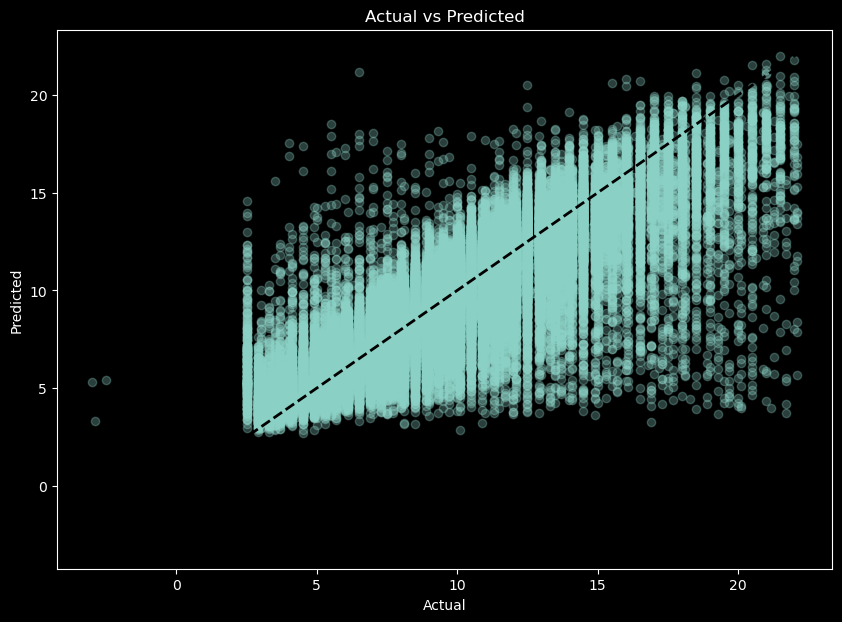

In [55]:
import optuna
import numpy as np
from lightgbm import LGBMRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Assuming df_cleaned_labeled_modified is your DataFrame and 'fare_amount' is your target variable
y = df_cleaned_labeled_modified['fare_amount']
X = df_cleaned_labeled_modified.drop(columns=['fare_amount'])  # Assuming X contains all other features

def LightGBM_Regressor(X, y):
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, shuffle=True)

    def objective(trial):
        # Suggest hyperparameters
        param = {
            'n_estimators': trial.suggest_int('n_estimators', 50, 500),
            'max_depth': trial.suggest_int('max_depth', 3, 20),
            'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
            'subsample': trial.suggest_float('subsample', 0.5, 1.0),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
            'reg_alpha': trial.suggest_float('reg_alpha', 0, 10),
            'reg_lambda': trial.suggest_float('reg_lambda', 0, 10)
        }

        # Create the model with suggested hyperparameters
        lgb_model = LGBMRegressor(**param, random_state=44, n_jobs=-1)

        # Train the model
        lgb_model.fit(X_train, y_train)

        # Predict and evaluate
        y_pred = lgb_model.predict(X_test)
        rmse = mean_squared_error(y_test, y_pred, squared=False)
        return rmse

    # Create an Optuna study
    study = optuna.create_study(direction='minimize')
    # Optimize the objective function
    study.optimize(objective, n_trials=50, timeout=2000)

    # Get the best parameters
    best_params = study.best_params
    print(f"Best parameters found: {best_params}")

    # Train the best model with the best parameters
    best_model = LGBMRegressor(**best_params, random_state=44, n_jobs=-1)
    best_model.fit(X_train, y_train)

    # Make predictions with the best model
    y_pred = best_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    r2 = r2_score(y_test, y_pred)

    print(f"Test MSE: {mse}")
    print(f"Test RMSE: {rmse}")
    print(f"Test R^2: {r2}")

    # Plot Actual vs Predicted
    plt.figure(figsize=(10, 7))
    plt.scatter(y_test, y_pred, alpha=0.3)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title('Actual vs Predicted')
    plt.show()

# Example usage: Assuming X and y are your feature matrix and target variable
LightGBM_Regressor(X_standard_df, y)


# **_Random Forest_**

**_Without Hyperparameter Tuning_**

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

y = df_cleaned_labeled_modified['fare_amount']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = RandomForestRegressor(n_estimators=100, max_depth=5, min_samples_split=2, min_samples_leaf=1, bootstrap=True)

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)

r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)

print("R2 Score:", r2)



output:

Mean Squared Error: 4.117760081211144

R2 Score: 0.6519228951598431

**_Hyperparam using optuna and Min max scaler(9 Feature)_** 

In [ ]:
import optuna
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

def RandomForest_Regressor(X, y):
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, shuffle=True)

    def objective(trial):
        # Suggest hyperparameters
        param = {
            'n_estimators': trial.suggest_int('n_estimators', 50, 500),
            'max_depth': trial.suggest_int('max_depth', 3, 20),
            'min_samples_split': trial.suggest_int('min_samples_split', 2, 10),
            'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 10),
            'max_features': trial.suggest_categorical('max_features', ['sqrt', 'log2']),  # Removed 'auto'
            'bootstrap': trial.suggest_categorical('bootstrap', [True, False])
        }

        # Create the model with suggested hyperparameters
        rf_model = RandomForestRegressor(**param, random_state=44, n_jobs=-1)

        # Train the model
        rf_model.fit(X_train, y_train)

        # Predict and evaluate
        y_pred = rf_model.predict(X_test)
        rmse = mean_squared_error(y_test, y_pred, squared=False)
        return rmse

    # Create an Optuna study
    study = optuna.create_study(direction='minimize')
    # Optimize the objective function
    study.optimize(objective, n_trials=50, timeout=2000)

    # Get the best parameters
    best_params = study.best_params
    print(f"Best parameters found: {best_params}")

    # Train the best model with the best parameters
    best_model = RandomForestRegressor(**best_params, random_state=44, n_jobs=-1)
    best_model.fit(X_train, y_train)

    # Make predictions with the best model
    y_pred = best_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    r2 = r2_score(y_test, y_pred)

    print(f"Test MSE: {mse}")
    print(f"Test RMSE: {rmse}")
    print(f"Test R^2: {r2}")

    # Plot Actual vs Predicted
    plt.figure(figsize=(10, 7))
    plt.scatter(y_test, y_pred, alpha=0.3)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title('Actual vs Predicted')
    plt.show()

# Example usage: Assuming X and y are your feature matrix and target variable
RandomForest_Regressor(X_min_max_df, y)


[I 2024-07-30 21:11:53,832] A new study created in memory with name: no-name-675604c7-4ed4-4743-8b76-bf160351577d

[I 2024-07-30 21:14:35,785] Trial 0 finished with value: 1.9020360458269625 and parameters: {'n_estimators': 205, 'max_depth': 19, 'min_samples_split': 7, 'min_samples_leaf': 3, 'max_features': 'log2', 'bootstrap': False}. Best is trial 0 with value: 1.9020360458269625.

[I 2024-07-30 21:14:47,672] Trial 1 finished with value: 2.0236832224541206 and parameters: {'n_estimators': 60, 'max_depth': 9, 'min_samples_split': 3, 'min_samples_leaf': 6, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 0 with value: 1.9020360458269625.

[I 2024-07-30 21:17:45,552] Trial 2 finished with value: 1.9079247954133882 and parameters: {'n_estimators': 466, 'max_depth': 14, 'min_samples_split': 6, 'min_samples_leaf': 6, 'max_features': 'sqrt', 'bootstrap': False}. Best is trial 0 with value: 1.9020360458269625.

[I 2024-07-30 21:19:10,259] Trial 3 finished with value: 2.1925792720389365 and parameters: {'n_estimators': 459, 'max_depth': 6, 'min_samples_split': 7, 'min_samples_leaf': 8, 'max_features': 'sqrt', 'bootstrap': False}. Best is trial 0 with value: 1.9020360458269625.

[I 2024-07-30 21:21:15,078] Trial 4 finished with value: 1.9367888488109415 and parameters: {'n_estimators': 384, 'max_depth': 12, 'min_samples_split': 6, 'min_samples_leaf': 7, 'max_features': 'sqrt', 'bootstrap': False}. Best is trial 0 with value: 1.9020360458269625.

[I 2024-07-30 21:23:33,559] Trial 5 finished with value: 1.8824196681861218 and parameters: {'n_estimators': 424, 'max_depth': 19, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:25:29,938] Trial 6 finished with value: 1.8987854123683188 and parameters: {'n_estimators': 419, 'max_depth': 15, 'min_samples_split': 4, 'min_samples_leaf': 6, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:26:31,818] Trial 7 finished with value: 1.8876940393614765 and parameters: {'n_estimators': 199, 'max_depth': 18, 'min_samples_split': 4, 'min_samples_leaf': 8, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:26:57,834] Trial 8 finished with value: 2.04317065370465 and parameters: {'n_estimators': 116, 'max_depth': 7, 'min_samples_split': 4, 'min_samples_leaf': 5, 'max_features': 'log2', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:27:46,417] Trial 9 finished with value: 1.997767181614437 and parameters: {'n_estimators': 174, 'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 5, 'max_features': 'sqrt', 'bootstrap': False}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:28:23,170] Trial 10 finished with value: 2.3702741213409224 and parameters: {'n_estimators': 330, 'max_depth': 3, 'min_samples_split': 10, 'min_samples_leaf': 10, 'max_features': 'log2', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:29:59,134] Trial 11 finished with value: 1.8836155748902823 and parameters: {'n_estimators': 269, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:31:47,121] Trial 12 finished with value: 1.8881175611553958 and parameters: {'n_estimators': 293, 'max_depth': 20, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:33:31,678] Trial 13 finished with value: 1.8908058915573236 and parameters: {'n_estimators': 352, 'max_depth': 16, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:35:32,898] Trial 14 finished with value: 1.8923642986943554 and parameters: {'n_estimators': 261, 'max_depth': 17, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'log2', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:37:00,273] Trial 15 finished with value: 1.8830941075718493 and parameters: {'n_estimators': 255, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:38:42,159] Trial 16 finished with value: 1.9191276635484529 and parameters: {'n_estimators': 394, 'max_depth': 13, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:40:20,773] Trial 17 finished with value: 1.8874089945344128 and parameters: {'n_estimators': 319, 'max_depth': 17, 'min_samples_split': 8, 'min_samples_leaf': 4, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:43:42,614] Trial 18 finished with value: 1.890662691191738 and parameters: {'n_estimators': 500, 'max_depth': 15, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': 'log2', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:44:53,428] Trial 19 finished with value: 1.884700795640704 and parameters: {'n_estimators': 229, 'max_depth': 18, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.

[I 2024-07-30 21:45:30,863] Trial 20 finished with value: 1.88569703407584 and parameters: {'n_estimators': 113, 'max_depth': 20, 'min_samples_split': 8, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 5 with value: 1.8824196681861218.


Best parameters found: {'n_estimators': 424, 'max_depth': 19, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_features': 'sqrt', 'bootstrap': True}

Test MSE: 3.5435038071739493

Test RMSE: 1.8824196681861218

Test R^2: 0.7026291930881883

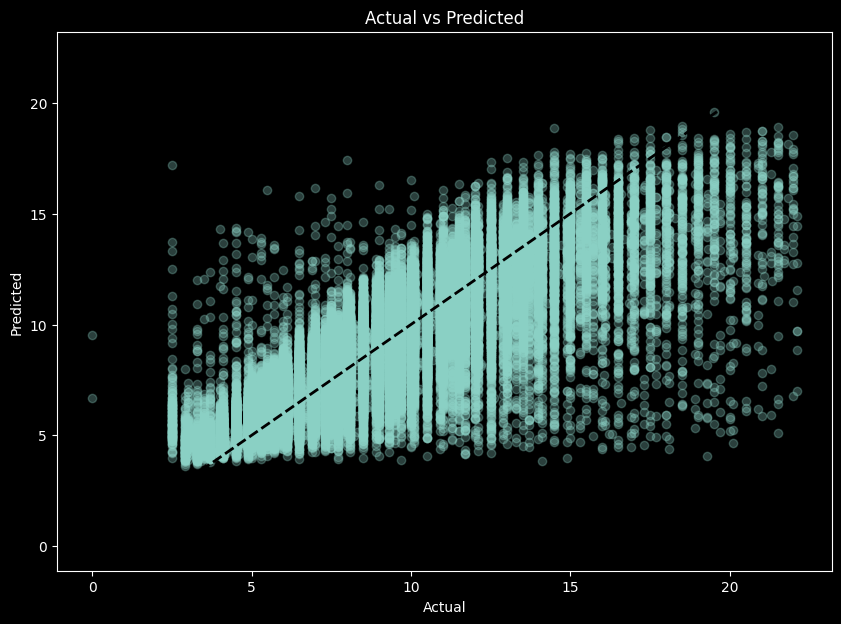

**_Hyperparam using optuna and standered scaler(9 Feature)_**

In [ ]:
import optuna
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

def RandomForest_Regressor(X, y):
    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42, shuffle=True)

    def objective(trial):
        # Suggest hyperparameters
        param = {
            'n_estimators': trial.suggest_int('n_estimators', 50, 500),
            'max_depth': trial.suggest_int('max_depth', 3, 20),
            'min_samples_split': trial.suggest_int('min_samples_split', 2, 10),
            'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 10),
            'max_features': trial.suggest_categorical('max_features', ['sqrt', 'log2']),  # Removed 'auto'
            'bootstrap': trial.suggest_categorical('bootstrap', [True, False])
        }

        # Create the model with suggested hyperparameters
        rf_model = RandomForestRegressor(**param, random_state=44, n_jobs=-1)

        # Train the model
        rf_model.fit(X_train, y_train)

        # Predict and evaluate
        y_pred = rf_model.predict(X_test)
        rmse = mean_squared_error(y_test, y_pred, squared=False)
        return rmse

    # Create an Optuna study
    study = optuna.create_study(direction='minimize')
    # Optimize the objective function
    study.optimize(objective, n_trials=50, timeout=2000)

    # Get the best parameters
    best_params = study.best_params
    print(f"Best parameters found: {best_params}")

    # Train the best model with the best parameters
    best_model = RandomForestRegressor(**best_params, random_state=44, n_jobs=-1)
    best_model.fit(X_train, y_train)

    # Make predictions with the best model
    y_pred = best_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    r2 = r2_score(y_test, y_pred)

    print(f"Test MSE: {mse}")
    print(f"Test RMSE: {rmse}")
    print(f"Test R^2: {r2}")

    # Plot Actual vs Predicted
    plt.figure(figsize=(10, 7))
    plt.scatter(y_test, y_pred, alpha=0.3)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title('Actual vs Predicted')
    plt.show()

# Example usage: Assuming X and y are your feature matrix and target variable
RandomForest_Regressor(X_standard_df, y)


[I 2024-07-30 22:10:43,693] A new study created in memory with name: no-name-b9f513d1-9a29-4029-b404-7a5e26b7d861

[I 2024-07-30 22:11:25,204] Trial 0 finished with value: 2.028407112190273 and parameters: {'n_estimators': 126, 'max_depth': 9, 'min_samples_split': 10, 'min_samples_leaf': 10, 'max_features': 'sqrt', 'bootstrap': False}. Best is trial 0 with value: 2.028407112190273.

[I 2024-07-30 22:13:15,021] Trial 1 finished with value: 1.884334938530532 and parameters: {'n_estimators': 316, 'max_depth': 20, 'min_samples_split': 6, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:14:28,415] Trial 2 finished with value: 1.8898433028257728 and parameters: {'n_estimators': 167, 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_features': 'log2', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:16:04,491] Trial 3 finished with value: 1.9902016702725789 and parameters: {'n_estimators': 344, 'max_depth': 10, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_features': 'sqrt', 'bootstrap': False}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:19:08,573] Trial 4 finished with value: 1.8846864126113776 and parameters: {'n_estimators': 413, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 6, 'max_features': 'log2', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:22:45,084] Trial 5 finished with value: 1.9052809702579878 and parameters: {'n_estimators': 425, 'max_depth': 13, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_features': 'log2', 'bootstrap': False}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:23:36,100] Trial 6 finished with value: 2.2950221196300116 and parameters: {'n_estimators': 451, 'max_depth': 5, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:24:23,310] Trial 7 finished with value: 1.9408811396002676 and parameters: {'n_estimators': 199, 'max_depth': 12, 'min_samples_split': 6, 'min_samples_leaf': 9, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:29:36,550] Trial 8 finished with value: 1.899176898649139 and parameters: {'n_estimators': 488, 'max_depth': 19, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 'log2', 'bootstrap': False}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:31:07,580] Trial 9 finished with value: 1.9099116737279076 and parameters: {'n_estimators': 340, 'max_depth': 14, 'min_samples_split': 10, 'min_samples_leaf': 9, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:31:13,404] Trial 10 finished with value: 2.528258557936739 and parameters: {'n_estimators': 65, 'max_depth': 4, 'min_samples_split': 8, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:33:21,334] Trial 11 finished with value: 1.885209503822306 and parameters: {'n_estimators': 287, 'max_depth': 20, 'min_samples_split': 8, 'min_samples_leaf': 6, 'max_features': 'log2', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:35:58,085] Trial 12 finished with value: 1.8855600904142635 and parameters: {'n_estimators': 378, 'max_depth': 17, 'min_samples_split': 3, 'min_samples_leaf': 7, 'max_features': 'log2', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:37:57,625] Trial 13 finished with value: 1.884375045327968 and parameters: {'n_estimators': 278, 'max_depth': 20, 'min_samples_split': 7, 'min_samples_leaf': 7, 'max_features': 'log2', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:39:20,289] Trial 14 finished with value: 1.8902420370504809 and parameters: {'n_estimators': 258, 'max_depth': 17, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:41:08,502] Trial 15 finished with value: 1.8899250785367132 and parameters: {'n_estimators': 263, 'max_depth': 15, 'min_samples_split': 5, 'min_samples_leaf': 8, 'max_features': 'log2', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:42:12,423] Trial 16 finished with value: 1.8871278895773564 and parameters: {'n_estimators': 219, 'max_depth': 18, 'min_samples_split': 7, 'min_samples_leaf': 7, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:43:27,096] Trial 17 finished with value: 2.000794549659566 and parameters: {'n_estimators': 303, 'max_depth': 8, 'min_samples_split': 5, 'min_samples_leaf': 5, 'max_features': 'log2', 'bootstrap': True}. Best is trial 1 with value: 1.884334938530532.

[I 2024-07-30 22:44:33,957] Trial 18 finished with value: 2.1230339125177697 and parameters: {'n_estimators': 323, 'max_depth': 7, 'min_samples_split': 7, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'bootstrap': False}. Best is trial 1 with value: 1.884334938530532.

Best parameters found: {'n_estimators': 316, 'max_depth': 20, 'min_samples_split': 6, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'bootstrap': True}

Test MSE: 3.5507181605668636

Test RMSE: 1.884334938530532

Test R^2: 0.7020237646177985

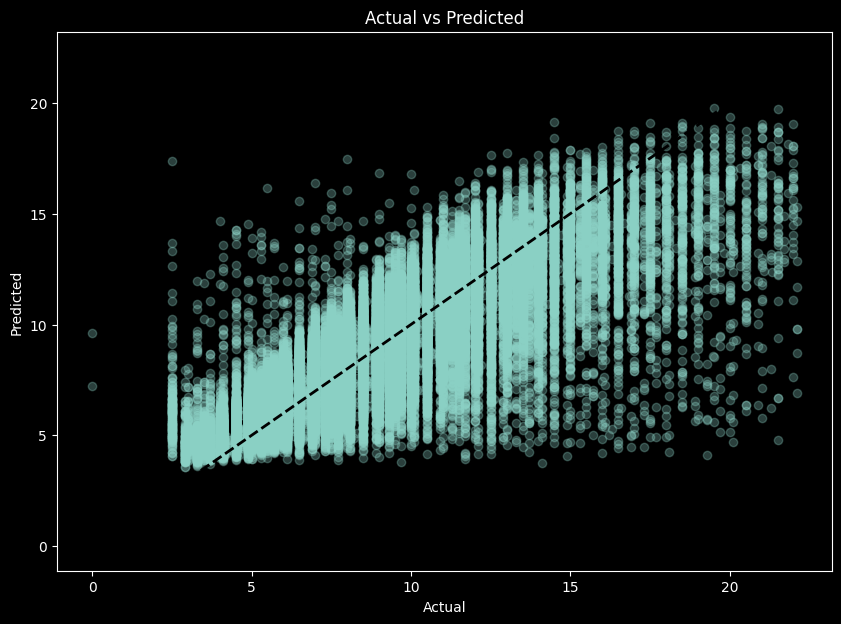

# **_KNNN_**

In [ ]:
import optuna
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import cross_val_score

def objective(trial, data, target):
  # Define the hyperparameter space
  n_neighbors = trial.suggest_int('n_neighbors', 1, 15)
  weights = trial.suggest_categorical('weights', ['uniform', 'distance'])
  p = trial.suggest_int('p', 1, 2)

  # Create the KNN model
  model = KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, p=p)

  # Evaluate the model using cross-validation
  scores = cross_val_score(model, data, target, cv=5, scoring='neg_mean_squared_error')

  # Return the mean cross-validation score
  return -scores.mean()

# Prepare the data
X = df_cleaned_labeled_modified[list(top_features_intersection)]
y = df_cleaned_labeled_modified['fare_amount']
# Optimize KNN for standard scaled data
study = optuna.create_study(direction='minimize')
study.optimize(lambda trial: objective(trial, X_standard_df, y), n_trials=15)
best_params_standard = study.best_params
print("Best hyperparameters for standard scaled data:", best_params_standard)


best_params_standard = {'n_neighbors': 20, 'weights': 'distance', 'p': 1}

best_params_normal = {'n_neighbors': 18, 'weights': 'distance', 'p': 1}

best_params_minmax = {'n_neighbors': 20, 'weights': 'distance', 'p': 1}

In [ ]:
# prompt: print accuracy

from sklearn.metrics import mean_squared_error, r2_score

# Predict on the training data (for demonstration purposes, you should use a separate test set)
y_pred_normal = knn_normal.predict(X)
y_pred_standard = knn_standard.predict(X_standard_df)
y_pred_minmax = knn_minmax.predict(X_min_max_df)

# Calculate evaluation metrics
rmse_normal = mean_squared_error(y, y_pred_normal, squared=False)
r2_normal = r2_score(y, y_pred_normal)

rmse_standard = mean_squared_error(y, y_pred_standard, squared=False)
r2_standard = r2_score(y, y_pred_standard)

rmse_minmax = mean_squared_error(y, y_pred_minmax, squared=False)
r2_minmax = r2_score(y, y_pred_minmax)

# Print the results
print("Normal Data:")
print("RMSE:", rmse_normal)
print("R-squared:", r2_normal)

print("\nStandard Scaled Data:")
print("RMSE:", rmse_standard)
print("R-squared:", r2_standard)

print("\nMin-Max Scaled Data:")
print("RMSE:", rmse_minmax)
print("R-squared:", r2_minmax)

Normal Data:
RMSE: 0.00048399697256000474
R-squared: 0.9999999803050053

Standard Scaled Data:
RMSE: 0.00048399697256000474
R-squared: 0.9999999803050053

Min-Max Scaled Data:
RMSE: 0.00048399697256000474
R-squared: 0.9999999803050053

In [ ]:
from sklearn.model_selection import KFold

# Cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

scores_normal = cross_val_score(knn_normal, X, y, cv=kf, scoring='neg_mean_squared_error')
scores_standard = cross_val_score(knn_standard, X_standard_df, y, cv=kf, scoring='neg_mean_squared_error')
scores_minmax = cross_val_score(knn_minmax, X_min_max_df, y, cv=kf, scoring='neg_mean_squared_error')

# Convert to positive RMSE
rmse_normal_cv = np.sqrt(-scores_normal)
rmse_standard_cv = np.sqrt(-scores_standard)
rmse_minmax_cv = np.sqrt(-scores_minmax)

# Plotting the results
plt.figure(figsize=(10, 6))
plt.plot(range(1, 6), rmse_normal_cv, label='Normal Data', marker='o')
plt.plot(range(1, 6), rmse_standard_cv, label='Standard Scaled Data', marker='o')
plt.plot(range(1, 6), rmse_minmax_cv, label='Min-Max Scaled Data', marker='o')
plt.xlabel('Fold')
plt.ylabel('RMSE')
plt.title('Cross-Validation RMSE')
plt.legend()
plt.grid(True)
plt.show()

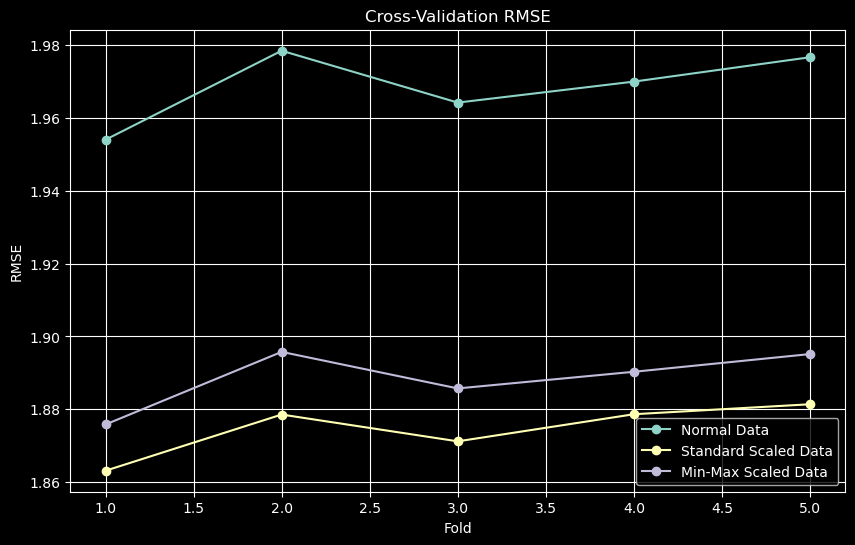

In [ ]:
from sklearn.model_selection import learning_curve

# Define the model
model = KNeighborsRegressor(n_neighbors=20, p=1, weights='distance')

# Learning curve
train_sizes, train_scores, validation_scores = learning_curve(
    model, X, y, cv=5, scoring='neg_mean_squared_error', train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and validation scores
train_scores_mean = -np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
validation_scores_mean = -np.mean(validation_scores, axis=1)
validation_scores_std = np.std(validation_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, label='Training RMSE', color='blue')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, color='blue', alpha=0.1)
plt.plot(train_sizes, validation_scores_mean, label='Validation RMSE', color='green')
plt.fill_between(train_sizes, validation_scores_mean - validation_scores_std, validation_scores_mean + validation_scores_std, color='green', alpha=0.1)
plt.title('Learning Curve')
plt.xlabel('Training Size')
plt.ylabel('RMSE')
plt.legend(loc='best')
plt.grid()
plt.show()

# Cross-validation scores
cross_val_scores = cross_val_score(model, X, y, cv=5, scoring='neg_mean_squared_error')
cross_val_rmse = np.sqrt(-cross_val_scores)

# Plot cross-validation scores
plt.figure(figsize=(10, 6))
plt.plot(range(1, 6), cross_val_rmse, label='Cross-Validation RMSE', marker='o', linestyle='--', color='red')
plt.title('Cross-Validation RMSE')
plt.xlabel('Fold')
plt.ylabel('RMSE')
plt.grid()
plt.legend()
plt.show()

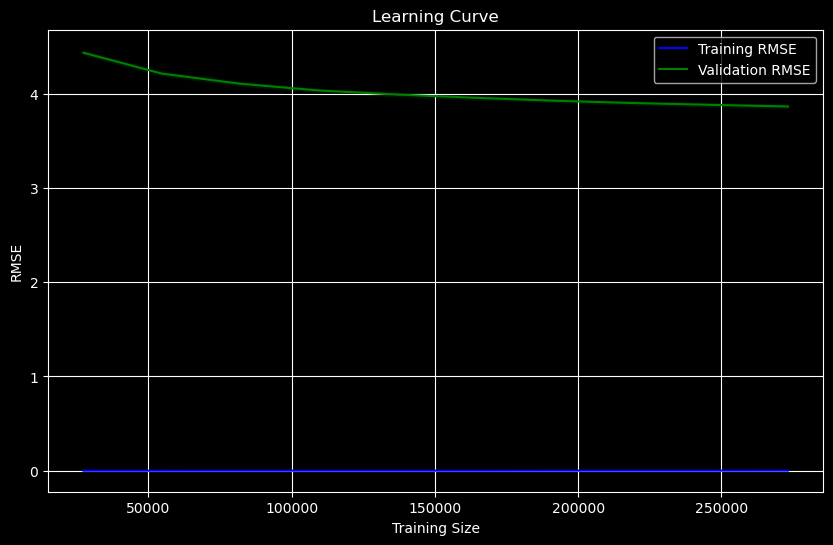

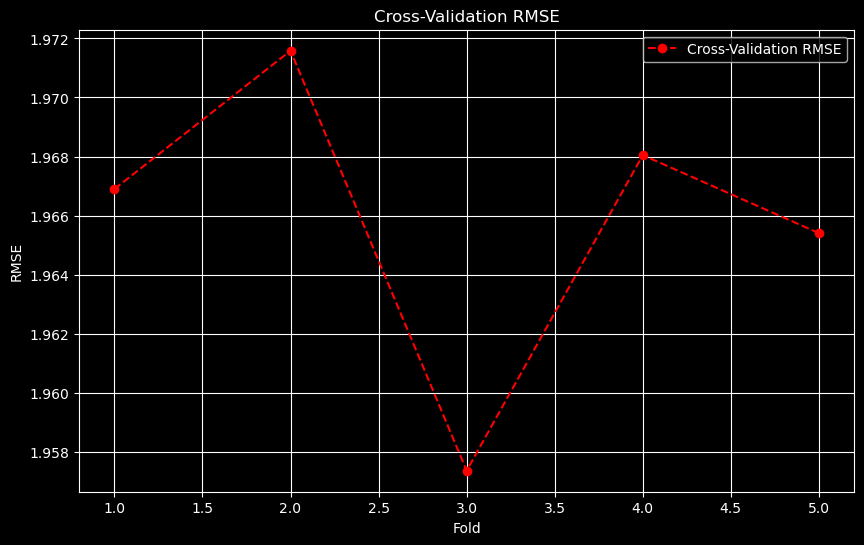

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np



# Perform cross-validation to evaluate the models
cv_rmse_normal = np.sqrt(-cross_val_score(knn_normal, X, y, cv=5, scoring='neg_mean_squared_error'))
cv_rmse_standard = np.sqrt(-cross_val_score(knn_standard, X_standard_df, y, cv=5, scoring='neg_mean_squared_error'))
cv_rmse_minmax = np.sqrt(-cross_val_score(knn_minmax, X_min_max_df, y, cv=5, scoring='neg_mean_squared_error'))

cv_r2_normal = cross_val_score(knn_normal, X, y, cv=5, scoring='r2')
cv_r2_standard = cross_val_score(knn_standard, X_standard_df, y, cv=5, scoring='r2')
cv_r2_minmax = cross_val_score(knn_minmax, X_min_max_df, y, cv=5, scoring='r2')

# Print the cross-validation results
print("Normal Data (Cross-Validation):")
print("Mean RMSE:", cv_rmse_normal.mean())
print("Mean R-squared:", cv_r2_normal.mean())

print("\nStandard Scaled Data (Cross-Validation):")
print("Mean RMSE:", cv_rmse_standard.mean())
print("Mean R-squared:", cv_r2_standard.mean())

print("\nMin-Max Scaled Data (Cross-Validation):")
print("Mean RMSE:", cv_rmse_minmax.mean())
print("Mean R-squared:", cv_r2_minmax.mean())

# Predict on the training data (for demonstration purposes, you should use a separate test set)
y_pred_normal = knn_normal.predict(X)
y_pred_standard = knn_standard.predict(X_standard_df)
y_pred_minmax = knn_minmax.predict(X_min_max_df)

# Calculate evaluation metrics on training data
rmse_normal = mean_squared_error(y, y_pred_normal, squared=False)
r2_normal = r2_score(y, y_pred_normal)

rmse_standard = mean_squared_error(y, y_pred_standard, squared=False)
r2_standard = r2_score(y, y_pred_standard)

rmse_minmax = mean_squared_error(y, y_pred_minmax, squared=False)
r2_minmax = r2_score(y, y_pred_minmax)

# Print the results on training data
print("\nTraining Data Evaluation:")
print("Normal Data:")
print("RMSE:", rmse_normal)
print("R-squared:", r2_normal)

print("\nStandard Scaled Data:")
print("RMSE:", rmse_standard)
print("R-squared:", r2_standard)

print("\nMin-Max Scaled Data:")
print("RMSE:", rmse_minmax)
print("R-squared:", r2_minmax)


Normal Data (Cross-Validation):

Mean RMSE: 1.9680630834365644

Mean R-squared: 0.6743332839583057

Standard Scaled Data (Cross-Validation):

Mean RMSE: 1.8734307548754188

Mean R-squared: 0.7049032495831026

Min-Max Scaled Data (Cross-Validation):

Mean RMSE: 1.8875929098781903

Mean R-squared: 0.7004238071667962

Training Data Evaluation:

Normal Data:

RMSE: 0.033540006592254853

R-squared: 0.9999054205321671

Standard Scaled Data:

RMSE: 0.033540006592254853

R-squared: 0.9999054205321671

Min-Max Scaled Data:

RMSE: 0.033540006592254853

R-squared: 0.9999054205321671


In [15]:
import joblib

# Assuming `model` is your trained XGBRegressor
joblib_file = "xgb_model_final.pkl"
joblib.dump(model, joblib_file)


['xgb_model_final.pkl']

In [21]:
# Assuming X_standard_df is already defined
print(X_standard_df.columns)


Index(['passenger_count', 'weekday', 'pickup_longitude', 'lga_dist',
       'dropoff_longitude', 'nyc_dist', 'month', 'dropoff_latitude', 'year',
       'ewr_dist', 'pickup_latitude', 'sol_dist', 'distance', 'jfk_dist',
       'bearing', 'hour'],
      dtype='object')
